# **Regression**

In [1]:
# libraries

import pandas as pd
import numpy as np
import bz2
pd.set_option('display.max_columns', None)
import statistics
import matplotlib.pyplot as plt
import seaborn as sns
import math
import pingouin as pg
import statsmodels.api as sm
import matplotlib as mpl
from scipy import stats
from distfit import distfit
import scikit_posthocs as sp
import datetime as dt

pd.options.display.float_format = '{:.2f}'.format

import warnings
warnings.filterwarnings('ignore')

plt.rcParams["image.cmap"] = "Pastel2"

import gower
import plotly.graph_objects as go
from sklearn_extra.cluster import KMedoids
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
from sklearn.metrics import silhouette_score

from sklearn.metrics import davies_bouldin_score

from sklearn import metrics

from sklearn.metrics import calinski_harabasz_score
from clusteval import clusteval

from clusterval import Clusterval

from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans,DBSCAN,MiniBatchKMeans
from matplotlib.colors import ListedColormap

from sklearn.cluster import DBSCAN

from scipy.spatial.distance import euclidean

from yellowbrick.regressor import PredictionError

/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [2]:
# planting seed

import random

random.seed(10)

In [3]:
# importing data

df = pd.read_csv("/home/evida-monika/mhunters/final_data_5.csv.bz2", compression="bz2", sep=",")

# this is cleaned dataset
# we need to delete another user - ID = 235, because it has 274 sessions in 4 weeks - impossible.

df = df[df['id_users'] != 235]

In [4]:
# changing types of data

cols = ['name_en_exercises','discarded_session_execution', 'code_name_sessions', 
        'name_en_sessions', 'active_user_programs', 'completed_user_programs',
        'pro_programs', 'available_programs', 'name_en_programs', 
        'gender', 
        'activity_level', 'goal', 'body_type', 'newsletter_subscription', 'notifications_setting',
        'language', 'scientific_data_usage', 'BMI_category', 'name_en_implements', 'cluster']

for col in cols:
    df[col] = df[col].astype('category')
    
col_date = ['updated_at_ex_ex', 'created_at_exercises', 'updated_at_exercises',
            'updated_at_session_execution', 'created_at_user_programs', 'updated_at_user_programs',
            'created_at_programs', 'updated_at_programs', 'created_at_users', 'updated_at_users',
            'date_of_birth']

for col in col_date:
    df[col] = pd.to_datetime(df[col])#.dt.strftime("%Y-%m-%d %H:%M:%S")

cat_names = {
    'gender': {1: 'male', 0: 'female'},
    'activity_level': {0: 'very active', 1: 'active', 2: 'sedentary'},
    'goal': {0: 'lose', 1: 'gain', 2: 'antiaging'},
    'body_type': {0: 'thin', 1: 'mid', 2: 'strong'}
}

df = df.replace(cat_names)


In [5]:
# Correlation plots and table definition

def corr_heatmap_p(df):
    rho, p = stats.spearmanr(df)
    
    rho = pd.DataFrame(rho).set_index(pd.Index(df.columns))
    rho.columns = df.columns
    
    p = pd.DataFrame(p).set_index(pd.Index(df.columns))
    p.columns = df.columns
    
    plt.figure(figsize=(12,7))
    heatmap = sns.heatmap(rho, vmin=-1, 
                      vmax=1, annot=True)
    plt.title("Spearman Correlation")
    
    
    s = set_title = np.vectorize(lambda ax,rho2: ax.title.set_text(
                                        '$\\rho$ = ' + 
                                        "{:.2f}".format(rho2)) if ax!=None else None
                            )      

    rho2 = df.corr(method="spearman")
    g = sns.PairGrid(df,corner=True)
    g.map_diag(plt.hist,color="yellow")
    g.map_lower(sns.scatterplot,color="magenta")
    set_title(g.axes,rho2)
    plt.subplots_adjust(hspace = 0.6)
    plt.show()
    
    for col in rho.columns:
        rho[col] = np.where((p[col] <= 0.05) & (p[col] > 0.01) & (col != rho.index),
                                          rho[col].round(2).astype('str') + '*', 
                                          np.where((p[col] <= 0.01) & (p[col] > 0.001) & (col != rho.index),
                                          rho[col].round(2).astype('str') + '**', 
                                          np.where((p[col] <= 0.001) & (col != rho.index),
                                          rho[col].round(2).astype('str') + '***', 
                                          rho[col])))
        
    

    return(rho)

In [6]:
# dataset only for users

df_users_only_once = df.drop_duplicates(subset=['id_users'], keep='first')

In [7]:
# here dropping all of the columns that are not relevant for users

df_users_only = df_users_only_once.loc[:, ['id_users', 'created_at_users', 'updated_at_users', 'gender',
       'date_of_birth', 'height', 'weight', 'activity_level', 'goal',
       'body_type', 'body_fat', 'newsletter_subscription',
       'notifications_setting', 'training_days_setting', 'language', 'points',
       'scientific_data_usage', 'best_weekly_streak_users', 'BMI', 'BMI_category', 'total_sessions_users2',
                                          'total_time_users2', 'total_reps_users2', 'reps_per_session_users2',
                                          'total_calories_users2', 'kcal_per_session_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user', 'cluster']]

In [8]:
# dataset for only one of id_session_execution

df_session_exe_only_once = df.drop_duplicates(subset=['id_session_execution'], keep='first')

In [9]:
# here dropping all of the columns that are not relevant for session_execution

df_session_exe = df_session_exe_only_once.loc[:, ['id_session_execution', 
                                                  'difficulty_feedback_session_execution',
       'enjoyment_feedback_session_execution',
       'reps_executed_session_execution', 'updated_at_session_execution',
       'discarded_session_execution', 'id_sessions', 'order_sessions',
       'time_duration_sessions', 'code_name_sessions', 'name_en_sessions',
       'id_user_programs', 'created_at_user_programs',
       'updated_at_user_programs', 'active_user_programs',
       'current_session_id_user_programs', 'completed_user_programs',
       'id_programs', 'created_at_programs', 'updated_at_programs',
       'pro_programs', 'available_programs', 'strength_programs',
       'endurance_programs', 'technique_programs', 'flexibility_programs',
       'intensity_programs', 'name_en_programs', 'description_en_programs',
       'id_users', 'created_at_users', 'updated_at_users', 'gender',
       'date_of_birth', 'height', 'weight', 'activity_level', 'goal',
       'body_type', 'body_fat', 'newsletter_subscription',
       'notifications_setting', 'training_days_setting', 'language', 'points',
       'scientific_data_usage', 'best_weekly_streak_users', 'BMI', 'BMI_category', 'total_sessions_users2',
       'total_time_session_execution', 'total_reps_session_execution',
       'total_time_users2', 'total_reps_users2', 'reps_per_session_users2',
       'total_time_session_execution_min', 'reps_per_min_session_execution',
       'exercise_execution_time_min', 'calories_session_execution',
       'total_calories_users2', 'kcal_per_session_users2',
                                          'YYYY/WW', 'number_exercises_in_session',
                                    'number_exercises_without_rest_in_session']]

In [10]:
# Creating a variable where there are 1 when it is the first time that user did a session in a day and 0 if the user already did a session that day

df_session_exe_copy = df_session_exe.copy()

df_session_exe_copy = df_session_exe_copy.sort_values(['id_users', 'updated_at_session_execution'])

df_session_exe_copy['days_a_week_session_exe'] = np.where((df_session_exe_copy['YYYY/WW'] == df_session_exe_copy['YYYY/WW'].shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.year == df_session_exe_copy['updated_at_session_execution'].dt.year.shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.month == df_session_exe_copy['updated_at_session_execution'].dt.month.shift()) &
                                                (df_session_exe_copy['updated_at_session_execution'].dt.day == df_session_exe_copy['updated_at_session_execution'].dt.day.shift()) & 
                                                (df_session_exe_copy['id_users'] == df_session_exe_copy['id_users'].shift()),
                                                0,1)


In [11]:
# grouped table with calculation of days trained a week for every user and training days setting by the user

df_session_exe_copy2 = df_session_exe_copy.loc[:, ['id_users', 'YYYY/WW', 'days_a_week_session_exe']]

df_session_exe_days_setting = df_session_exe_copy2.groupby(['id_users', 'YYYY/WW'])['days_a_week_session_exe'].sum().reset_index()


df_users_training_days_setting = df_users_only.loc[:, ['id_users', 'training_days_setting']]

df_session_exe_days_setting = df_session_exe_days_setting.merge(df_users_training_days_setting, how = 'left', 
                                                                left_on = 'id_users', right_on = 'id_users')


In [12]:
# new column that says if user achieved weekly training goal (1) or not (0)

df_session_exe_days_setting['training_days_setting'] = df_session_exe_days_setting['training_days_setting'].astype('int64')

df_session_exe_days_setting['training_days_goal_achieved'] = np.where(df_session_exe_days_setting['days_a_week_session_exe'] >= df_session_exe_days_setting['training_days_setting'], 1, 0)


In [13]:
seed = 42

In [14]:
import warnings
warnings.filterwarnings('ignore')


In [15]:
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

In [16]:
# additional libraries

from sklearn import tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import StratifiedShuffleSplit, GridSearchCV, train_test_split
from sklearn.linear_model import LinearRegression, LogisticRegression, Lasso, Ridge, SGDRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor

from sklearn.metrics import explained_variance_score,mean_absolute_error,r2_score, mean_squared_error, max_error, mean_absolute_percentage_error

from sklearn.preprocessing import OrdinalEncoder, LabelEncoder

from mlxtend.feature_selection import SequentialFeatureSelector
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SequentialFeatureSelector as SFS
from sklearn.feature_selection import RFECV
from sklearn.feature_selection import SelectFromModel



In [54]:
# Definition of training dataset and evaluation

def train(X, y,
          grid_params, seed, feature_selection = False, feature_sel_type = ['SFS', 'RFECV', 'SFM']):
    
    scaler = StandardScaler()
  
    # The models dict has same keys as grid_params 
    # pointing to the grid search of each classifier
    models = {
        "SGD": SGDRegressor(),
        "Linear Regression": LinearRegression(),
        #"Logistic Regression": LogisticRegression(),
        "Lasso": Lasso(),
        "Ridge": Ridge(),
        "Decision Tree": DecisionTreeRegressor(),
        "Random Forest": RandomForestRegressor(), 
        "AdaBoost": AdaBoostRegressor(), 
        "GradientBoost": GradientBoostingRegressor()
    }
    '''
    y_regr = pd.DataFrame(y, columns = ['y_tr']).astype('int64')
    
    df = pd.concat([X.reset_index(),y_cat], axis = 1)
    
    if (feature_selection == True) and (feature_sel_type == 'UNI'):
        feature_list = []
        for i in range(len(X.columns)):
            var_name = X.columns[i]
            if (X.dtypes[i] == float) or (X.dtypes[i] == int):
                
                        
            elif X.dtypes[i] == 'category':
                p_val = stats.kruskal(df[df[var_name] == 0]['y_tr'],
                                         df[df[var_name] == 1]['y_tr'])[1]
                if p_val < 0.05:
                    feature_list.append(i)
                    
        X = X.iloc[:, feature_list]
    '''
    X_scaled = scaler.fit_transform(X)

    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, 
                                                      test_size=0.3, 
                                                      random_state=seed)

    X_test_inv = scaler.inverse_transform(X_test)
    X_train_inv = scaler.inverse_transform(X_train)

    # store best estimators
    best_estimators = dict.fromkeys(models.keys())
    features = dict.fromkeys(models.keys())

    for model_name in models:
        
        base_clf = models[model_name]
        params = grid_params[model_name]
        
        if (feature_selection == True) and ((feature_sel_type == 'SFS') or (feature_sel_type == 'RFECV') or (feature_sel_type == 'SFM')):
            
            if feature_sel_type == 'SFS':
            
                sel = SequentialFeatureSelector(base_clf, k_features = 'best', forward=True, n_jobs = -1)
                sel.fit(X_train, y_train)
                features_list = list(sel.k_feature_names_)
                features_list = list(map(int, features_list))
                feature_importance = []
                
            elif feature_sel_type == 'RFECV':
                sel = RFECV(base_clf, scoring = 'r2')
                sel.fit(X_train, y_train)
                features_list = list(sel.support_)
                features_list = [i for i, x in enumerate(features_list) if x]
                
            elif feature_sel_type == 'SFM':
                sel = SelectFromModel(base_clf, threshold = 'median')
                sel.fit(X_train, y_train)
                features_list = list(sel.get_support())
                features_list = [i for i, x in enumerate(features_list) if x]
                '''
                if (model_name == 'SGD') or (model_name == 'Logistic Regression'):
                    feature_importance = sum(abs(model.best_estimator_.coef_))
                elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                    feature_importance = list(sel.estimator_.feature_importances_)
                '''

            features_names = X.iloc[:,features_list].columns
            X_train_feature_selection = sel.transform(X_train)
            
            print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
            model = GridSearchCV(base_clf, params, scoring=['r2', 'neg_mean_squared_error'], 
                                 cv=5, n_jobs=-1,verbose=0, refit = 'r2')
            
            model.fit(X_train_feature_selection, y_train)
            
            print("[{}] Features selected: {}".format(model_name, features_names))
            
            if (feature_sel_type == 'RFECV') or (feature_sel_type == 'SFM'):
                
                if (model_name == 'SGD') or (model_name == 'Linear Regression') or (model_name == 'Lasso') or (model_name == 'Ridge'):
                    feature_importance = list(model.best_estimator_.coef_)
                elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                    feature_importance = list(model.best_estimator_.feature_importances_)
                
                print("[{}] Features importances: {}".format(model_name, feature_importance))
                
                feat_imp = pd.DataFrame({'features names': np.array(features_names), 
                                         'feature importance': feature_importance})

                feat_imp.sort_values(by = 'feature importance', ascending = False, inplace = True)

                plt.figure(figsize=(10,6))

                ax = sns.barplot(x=feat_imp['feature importance'], y=feat_imp['features names'])
                ax.bar_label(ax.containers[0])
                plt.title("{} feature importance plot with {}".format(model_name, feature_sel_type))
                plt.show()
                
        
        else: 
            features_list = []
            print("[INFO] Performing Grid-Search CV ---- {}".format(model_name))
            model = GridSearchCV(base_clf, params, scoring=['r2', 'neg_mean_squared_error'], 
                                 cv=5, n_jobs=-1, verbose=0, refit = 'r2')
            model.fit(X_train, y_train)
                
            if (model_name == 'SGD') or (model_name == 'Linear Regression') or (model_name == 'Lasso') or (model_name == 'Ridge'):
                feature_importance = list(model.best_estimator_.coef_)
                                                                     
            elif (model_name == 'Decision Tree') or (model_name == 'Random Forest') or (model_name == 'AdaBoost') or (model_name == 'GradientBoost'):
                feature_importance = list(model.best_estimator_.feature_importances_)
                
            print("[{}] Features importances: {}".format(model_name, feature_importance))
            feat_imp = pd.DataFrame({'features names': np.array(X.columns), 
                                     'feature importance': feature_importance})

            feat_imp.sort_values(by = 'feature importance', ascending = False, inplace = True)

            plt.figure(figsize=(10,6))

            ax = sns.barplot(x=feat_imp['feature importance'], y=feat_imp['features names'])
            ax.bar_label(ax.containers[0])
            plt.title("{} feature importance plot".format(model_name))
            plt.show()

        best_estimators[model_name] = model.best_estimator_
        features[model_name] = features_list
        
        print("[{}] Best parameters are {}".format(model_name, model.best_params_))

    return best_estimators, X_test, y_test, X_train, y_train, X_train_inv, X_test_inv, features


def evaluate_multiclass(models, X_test, y_test, features, features_selected = False):
    
    
    results = pd.DataFrame(columns=["R2 score", "Adjusted R2 score",
                                    "Mean Absolute Error",
                                    "Mean Absolute Percentage Error",
                                        "Mean Squared Error",
                                        "Max Error"], index=models.keys())

    for model_name, model in models.items():
        
        if features_selected == True:
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])
            
        else: X_test_sel = X_test.copy()
        
        n_samples = len(y_test)
        n_cols = X_test_sel.shape[1]
        y_pred = model.predict(X_test_sel)

        R2 = r2_score(y_test, y_pred)
        R2_adj = 1 - ((1 - R2)*(n_samples - 1)/(n_samples - n_cols - 1))
        mae = mean_absolute_error(y_test, y_pred) 
        mse = mean_squared_error(y_test, y_pred)
        me = max_error(y_test, y_pred)
        mape = mean_absolute_percentage_error(y_test, y_pred)
                                    
        results.loc[model_name, :] = R2, R2_adj, mae, mape, mse, me
        
        # print("{}: classification report: ".format(model_name), "\n", classification_report(y_test, y_pred))    
    
    return results
  
                                    
labels=['sr','og','^b']
colors=['r','g','b']
cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])


def decision_tree(model, X, y):#, X_train, y_train):
    
    feat_names = X.columns
    target_name = y.name
    clf = model.get('Decision Tree')
    # clf.fit(X_train, y_train)
    
    # plt.figure(figsize = (9,6))
    
    tree.plot_tree(clf, feature_names=feat_names,
                   class_names = target_name, filled = True)
    
    return plt.show()


# plots for regression - predicted variable vs rest

def plots_regr(model, X, y, X_train, y_train, X_test, y_test, 
               X_train_inv, X_test_inv, features, features_selected = False,
               name = ['SGD', 'Linear Regression','Lasso', 'Ridge',
                                                'Decision Tree', 'Random Forest','AdaBoost', 'GradientBoost']):
    
    
    if features_selected == True:
        X_sel = X.copy()
        # X_sel = pd.DataFrame(X_sel, columns = X.columns)
        X_sel = X_sel.iloc[:, features.get(name)]
        X_train_sel = X_train.copy()
        X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(name)])
        X_test_sel = X_test.copy()
        X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(name)])
        X_test_inv_sel = X_test_inv.copy()
        X_test_inv_sel = np.array(pd.DataFrame(X_test_inv_sel)[features.get(name)])
        X_train_inv_sel = X_train_inv.copy()
        X_train_inv_sel = np.array(pd.DataFrame(X_train_inv_sel)[features.get(name)])
            
    else: 
        X_sel = X.copy()
        # X_sel = pd.DataFrame(X_sel, columns = X.columns)
        X_train_sel = X_train.copy()
        X_test_sel = X_test.copy()
        X_test_inv_sel = X_test_inv.copy()
        X_train_inv_sel = X_train_inv.copy()
    
    clf = model.get(name)
    
    clf.fit(X_train_sel, y_train)
    y_1 = clf.predict(X_test_sel)
    
    colors = sns.color_palette("husl", 8)
    
    top = math.ceil(len(X_sel.columns)/2)
    num = top*4
    plt.figure(figsize = (15,num))
    
    for i in range(len(X_sel.columns)):
    
        plt.subplot(top,2,i+1)
        plt.scatter(pd.DataFrame(X_test_inv_sel)[i], y_test, color=colors[0], label="observed", alpha = 0.9)
        plt.scatter(pd.DataFrame(X_test_inv_sel)[i], y_1, color=colors[5], label='predicted', alpha = 0.5)
        plt.xlabel("{}".format(X_sel.columns[i]))
        plt.ylabel("{}".format(y.name))
        plt.title("{} for {}".format(name, X_sel.columns[i]))
        plt.legend()
        plt.tight_layout()
        
    plt.show()
    
    return plt


def plots_box(model, X, y, X_train, y_train, X_test, y_test, features, 
               X_train_inv, X_test_inv, features_selected = False,
              name = ['SGD', 'Linear Regression','Lasso', 'Ridge',
                                                'Decision Tree', 'Random Forest','AdaBoost', 'GradientBoost']):

    
    if features_selected == True:
        X_sel = X.copy()
        X_sel = pd.DataFrame(X_sel, columns = X.columns)
        X_sel = X_sel.iloc[:, features.get(name)]
        X_train_sel = X_train.copy()
        X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(name)])
        X_test_sel = X_test.copy()
        X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(name)])
        X_test_inv_sel = X_test_inv.copy()
        X_test_inv_sel = np.array(pd.DataFrame(X_test_inv_sel)[features.get(name)])
        X_train_inv_sel = X_train_inv.copy()
        X_train_inv_sel = np.array(pd.DataFrame(X_train_inv_sel)[features.get(name)])
            
    else: 
        X_sel = X.copy()
        X_sel = pd.DataFrame(X_sel, columns = X.columns)
        X_train_sel = X_train.copy()
        X_test_sel = X_test.copy()
        X_test_inv_sel = X_test_inv.copy()
        X_train_inv_sel = X_train_inv.copy()
    
    clf = model.get(name)
    clf.fit(X_train_sel, y_train)
    y_1 = clf.predict(X_test_sel)

    colors = sns.color_palette("husl", 8)

    top = math.ceil(len(X_sel.columns)/2)
    num = top*4
    plt.figure(figsize = (15,num))

    y_test.reset_index(drop = True, inplace = True)
    y_1 = pd.Series(y_1)

    observed_df = y_test.to_frame(name = 'observed')
    predicted_df = y_1.to_frame(name = 'predicted')

    for i in range(len(X_sel.columns)):

        data = pd.DataFrame(X_test_inv_sel)[i]

        if (X_sel.dtypes[i] == 'uint8') or (X_sel.dtypes[i] == 'category'):
            data = data.astype('category')

        name_df = data.to_frame(name = X_sel.columns[i])

        data_tog = pd.concat([name_df, observed_df, predicted_df], axis = 1)

        data_tog_m = data_tog.melt(id_vars = X_sel.columns[i], value_vars=['observed', 'predicted'])
        data_tog_m.rename(columns={'variable': 'type'}, inplace = True)

        plt.subplot(top,2,i+1)

        if (X_sel.dtypes[i] == 'uint8') or (X_sel.dtypes[i] == 'category'):

            sns.boxplot(data=data_tog_m, x=X_sel.columns[i], y="value", hue="type")
            plt.xlabel("{}".format(X_sel.columns[i]))
            plt.ylabel("{}".format(y.name))
            plt.title("{} for {}".format('Adaboost', X_sel.columns[i]))
            plt.legend()
            plt.tight_layout()

        else:
            sns.boxplot(data=data_tog_m, y = 'value', x='type')
            plt.xlabel("{}".format(X_sel.columns[i]))
            plt.ylabel("{}".format(y.name))
            plt.title("{} for {}".format('Adaboost', X_sel.columns[i]))
            plt.tight_layout()

    plt.show()
    
    return plt

def prediction_error_plot(model, X_train, y_train, X_test, y_test, features, features_selected = False,
                          name = ['SGD', 'Linear Regression',
                                                                         'Lasso', 'Ridge','Decision Tree', 
                                                                         'Random Forest','AdaBoost', 
                                                                         'GradientBoost', 'all']):
    
    
    if name != 'all':
        clf = model.get(name)
        
        if features_selected == True:
            X_train_sel = X_train.copy()
            X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(name)])
            X_test_sel = X_test.copy()
            X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(name)])
            
        else: 
            X_train_sel = X_train.copy()
            X_test_sel = X_test.copy()

        visualizer = PredictionError(clf, identity = False, alpha = 0.5) 
        visualizer.fit(X_train_sel, y_train) 
        visualizer.score(X_test_sel, y_test)
    
    elif name == 'all':
        
        plt.figure(figsize=(12,12))
    
        for i, (model_name, model) in enumerate(model.items(),1):
            
            if features_selected == True:
                X_train_sel = X_train.copy()
                X_train_sel = np.array(pd.DataFrame(X_train_sel)[features.get(model_name)])
                X_test_sel = X_test.copy()
                X_test_sel = np.array(pd.DataFrame(X_test_sel)[features.get(model_name)])
            
            else: 
                X_train_sel = X_train.copy()
                X_test_sel = X_test.copy()
            
            axi = plt.subplot(4,2,i)

            visualizer = PredictionError(model, ax = axi, identity = False, alpha = 0.5)
            visualizer.fit(X_train_sel, y_train)
            visualizer.score(X_test_sel, y_test)
            plt.legend()
            plt.title(model_name)
            plt.suptitle("Prediction Error for")
            plt.tight_layout()
    
    return visualizer.show()

def prediction_for_one_user(model, X_test, y_test, X_test_inv, var_names, out_names, features, name = ['SGD', 
                                                                                            'Logistic Regression',
                                                                                            'Decision Tree', 
                                                                                            'Random Forest',
                                                                                            'AdaBoost', 
                                                                                            'GradientBoost'],
                           features_selected = False, feature_sel_type = ['SFS', 'RFECV', 'SFM']):
    
    
    clf = model.get(name)
    X = pd.DataFrame(X_test, columns = var_names)
    y = pd.DataFrame(y_test, columns = out_names).reset_index().drop(['index'], axis = 1)
    
    if features_selected == True:
        
        var_names_sel = var_names[features.get(name)]
        X_sel = X.copy()
        X_sel = X_sel.iloc[:, features.get(name)]
        X_test_inv_sel = X_test_inv.copy()
        X_test_inv_sel = np.array(pd.DataFrame(X_test_inv_sel)[features.get(name)])
        
        
    else:
        var_names_sel = var_names.copy()
        X_sel = X.copy()
        X_test_inv_sel = X_test_inv.copy()
        
    
    X_in = X_sel.sample(random_state = seed).index
    y_in = y.iloc[X_in,:].index
    
    X_row = X_sel.iloc[X_in, :]
    y_row = y.iloc[y_in, :]

    
    X_to_show = pd.DataFrame(X_test_inv_sel, columns = var_names_sel)
    X_row_to_show = X_to_show.iloc[X_in, :]
    
    y_pred = clf.predict(X_row)
    
    X_y_tog = pd.concat([X_row_to_show, y_row], axis = 1)
    y_pr = pd.DataFrame(y_pred, columns = [y_row.columns[0] + '_prediction']).set_index(y_in)
    
    data_with_pred = pd.concat([X_y_tog, y_pr], axis = 1)
    
    return data_with_pred
    
    
    

In [18]:
# parameters

params = {
    "SGD": {
        "penalty": ["l1", "l2", "elasticnet"],
        "alpha": np.linspace(1e-5, 1e-3, 5),
        "learning_rate": ["optimal", "invscaling", "adaptive"],
        "eta0": np.linspace(1e-4, 1e-1, 5),
        "random_state": [seed],
        "max_iter": [1000000]
    },
    "Linear Regression": {
        "fit_intercept": [True],
        "copy_X": [True]
    },
#    "Logistic Regression": {
#        "penalty": ["l1", "l2"],
#        "C": [1, 2, 4, 5],
#        "solver": ["liblinear"],
#        "random_state": [seed],
#        "max_iter": [1000000]
#    },
    "Lasso": {
        "alpha": np.linspace(1e-5, 2, 8),
        "fit_intercept": [True],
        "copy_X": [True],
        "random_state": [seed]
        #"selection":['cyclic', 'random']
    },
    "Ridge": {
        "alpha": np.linspace(1e-5, 2, 8),
        "fit_intercept": [True],
        "copy_X": [True],
        "random_state": [seed],
        "solver":['auto']
    },
    "Decision Tree": {
        "criterion": ["friedman_mse"],
        "max_depth": np.linspace(3, 12, 4, dtype=np.int64),
        "min_samples_split": np.linspace(0.1, 0.5, 6),
        "min_samples_leaf": np.linspace(0.1, 0.5, 6),
        #"max_features":["log2","sqrt"],
        "random_state": [seed]
    },
    "Random Forest": {
        "criterion": ["friedman_mse"],
        "max_depth": np.linspace(3, 12, 4, dtype=np.int64),
        "min_samples_split": np.linspace(0.1, 0.5, 6),
        "min_samples_leaf": np.linspace(0.1, 0.5, 6),
        "max_features":["log2","sqrt"],
        "random_state": [seed]
    },
    "AdaBoost": {
        "base_estimator": [DecisionTreeRegressor(max_depth=1),
                           DecisionTreeRegressor(max_depth=2),
                           DecisionTreeRegressor(max_depth=3),
                           DecisionTreeRegressor(max_depth=4),
                           DecisionTreeRegressor(max_depth=5)],
        "learning_rate": [0.01, 0.025, 0.05, 0.075, 0.1],
        "n_estimators": np.linspace(20, 80, 4, dtype=np.int64),
        "random_state": [seed]
    },
    "GradientBoost": {
        "loss":["squared_error","absolute_error"],
        "learning_rate": [0.01, 0.025, 0.05, 0.075, 0.1],
        "n_estimators": np.linspace(20,100,6),
        "min_samples_split": np.linspace(0.1, 0.5, 5),
        "min_samples_leaf": np.linspace(0.1, 0.5, 5),
        "max_depth":[3, 4, 5, 6, 7, 8],
        "max_features":["log2","sqrt"],
        "criterion": ["friedman_mse"],
        "subsample":[0.5, 0.618, 0.85],
        "n_estimators":[5, 10, 15],
        "random_state": [seed],
        "criterion": ['friedman_mse']
    }
}

## Introduction

Regression analysis is a commonly used statistical technique for predicting the relationship between a dependent variable and one or more independent variables. In the field of machine learning, regression algorithms are used to make predictions about continuous variables, such as housing prices, student scores, or medical outcomes. 

A regression is a statistical technique that relates a dependent variable to one or more independent (explanatory) variables. A regression model is able to show whether changes observed in the dependent variable are associated with changes in one or more of the explanatory variables.

There will be multiple algorithms taken into consideration when it comes to regression. Now, we are going to describe them. 

**Stochastic Gradient Descent Regressor** - Stochastic Gradient Descent (or **SGD**) is an iterative optimization technique that approximates a smooth, differentiable gradient. While calculating the actual gradient requires all of the data, SGD estimates it using a randomly selected subset of the data. It is linear model fitted by minimizing a regularized empirical loss with SGD.

(https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDRegressor.html, https://predictivemodeler.com/2020/11/20/python-stochastic-gradient-descent-sgd-regression/)

**Linear Regression** - an ML algorithm used for supervised learning. Linear regression performs the task to predict a dependent variable(target) based on the given independent variable(s). So, this regression technique finds out a linear relationship between a dependent variable and the other given independent variables. Hence, the name of this algorithm is Linear Regression.

(https://www.analyticsvidhya.com/blog/2021/05/5-regression-algorithms-you-should-know-introductory-guide/)

**Lasso Regression** - type of linear regression that uses shrinkage. Shrinkage is where data values are shrunk towards a central point, like the mean. The lasso procedure encourages simple, sparse models (i.e. models with fewer parameters). This particular type of regression is well-suited for models showing high levels of muticollinearity or when you want to automate certain parts of model selection, like variable selection/parameter elimination. It is a linear Model trained with L1 regularization, which adds a penalty equal to the absolute value of the magnitude of coefficients, prior as regularizer (aka the Lasso).

(https://www.statisticshowto.com/lasso-regression/, https://www.mygreatlearning.com/blog/understanding-of-lasso-regression/)

**Ridge Regression** - Ridge regression is a model tuning method that is used to analyse any data that suffers from multicollinearity. This method performs L2 regularization. When the issue of multicollinearity occurs, least-squares are unbiased, and variances are large, this results in predicted values being far away from the actual values. Comparing to Least Squares Regression, Ridge regression adds just enough bias to make the estimates reasonably reliable approximations to true population values. 

(https://www.mygreatlearning.com/blog/what-is-ridge-regression/, https://www.statisticshowto.com/ridge-regression/)

**Decision Tree Regression** - the algorithm uses a tree-like model of decisions to predict the target value.

(https://www.theclickreader.com/decision-tree-regression/)

**Random Forest Regression** - Random forest is an ensemble of decision trees. This is to say that many trees, constructed in a certain "random" way form a Random Forest. 
* Each tree is created from a different sample of rows and at each node, a different sample of features is selected for splitting. 
* Each of the trees makes its own individual prediction. 
* These predictions are then averaged to produce a single result. 
The averaging makes a Random Forest better than a single Decision Tree hence improves its accuracy and reduces overfitting. A prediction from the Random Forest Regressor is an average of the predictions produced by the trees in the forest. 

(https://neptune.ai/blog/random-forest-regression-when-does-it-fail-and-why)

**AdaBoost Regression** - AdaBoost fits a sequence of weak learners to the data. It then assigns more weight to incorrect predictions, and less weight to correct ones. This way the algorithm focuses more on observations that are harder to predict. The final result is obtained from the average in regression. The algorithm uses decision trees as the base estimators by default. The base estimators and the parameters of the decision trees can be tuned to improve the performance of the model. By default, decision trees in AdaBoost have a single split.

(https://neptune.ai/blog/gradient-boosted-decision-trees-guide)

**Gradient Boost Regression** - Gradient boosting is different from AdaBoost, because the loss function optimization is done via gradient descent. Like AdaBoost, it also uses decision trees as weak learners. It also sequentially fits the trees. When adding subsequent trees, loss is minimized using gradient descent. 

(https://neptune.ai/blog/gradient-boosted-decision-trees-guide)


The **evaluation metrics** for regressions will be:

* **$R^2$** - in other words, it is the coefficient of determination. It represents the proportion of variance (of y) that has been explained by the independent variables in the model. It provides an indication of goodness of fit and therefore a measure of how well unseen samples are likely to be predicted by the model, through the proportion of explained variance. 
    - A value of 0 indicates that the response variable cannot be explained by the predictor variable(s) at all,
    - A value of 1 indicates that the response variable can be perfectly explained without error by the predictor variable(s) (best possible outcome).

* **Adj$R^2$** - Adjusted $R^2$ - a modified version of R-squared, adds precision and reliability by considering the impact of additional independent variables that tend to skew the results of R-squared measurements. The adjusted R2 tells you the percentage of variation explained by only the independent variables that actually affect the dependent variable, as in case of $R^2$, the closer the value is to 1, the better the model is.

* **Mean Absolute Error (MAE)** - the amount of error in your measurements. It gives the mean of absolute difference between model prediction and target value, the closer to zero, the better the model is.

* **Mean Absolute Percentage Error (MAPE)** - the mean of all absolute percentage errors between the predicted and actual values, MAPE values range from 0 to infinity, where the lower the value the more accurate the predictions are. A good score is dependent upon your use case, but in general, a MAPE value lower than 20% is considered a good value.

* **Mean Squared Error (MSE)** - the average squared error between actual and predicted values. The closer MSE value is to 0, the more accurate your model is. However, there is no 'good' value for MSE. It is an absolute value which is unique to each dataset and can only be used to say whether the model has become more or less accurate than a previous run.

* **Max Error (ME)** - the maximum residual error, a metric that captures the worst case error between the predicted value and the true value. In a perfectly fitted single output regression model, max_error would be 0 and though this would be highly unlikely in the real world, this metric shows the extent of error that the model had when it was fitted.



(https://www.statology.org/explained-variance/, https://scikit-learn.org/stable/modules/model_evaluation.html#regression-metrics, https://www.statisticshowto.com/probability-and-statistics/statistics-definitions/adjusted-r2/, https://www.investopedia.com/ask/answers/012615/whats-difference-between-rsquared-and-adjusted-rsquared.asp, https://stephenallwright.com/good-mape-score/, https://stephenallwright.com/good-mse-value/)


## For users (number of sessions)

In this subsection we'll use users demographics and after-workout information to prepare regression of *total_sessions* label, which we created from a thresholds.

Features are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

Because 
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user 

are highly correlated, so we will use instead of them 
* reps_per_session, 
* kcal_per_session.

So we won't violate the assumption of multicollinearity.

BUT when the assumptions are violated, the results are much better. Below will be 2 methods (one with violation of assumption and the other one with no violation).

### Violation of assumptions

In [19]:
X_users = df_users_only.loc[:, ['gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 
                                'total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user']]
'''
for col in ['gender', 'activity_level', 'body_type', 'newsletter_subscription']:
    X_users[col] = LabelEncoder().fit_transform(X_users[col])
'''

cat_cols = ['gender', 'activity_level', 'body_type', 'newsletter_subscription', 'training_days_setting']
X_users = pd.get_dummies(X_users, columns = cat_cols, drop_first = True)
    
y_users = df_users_only['total_sessions_users2']

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [-0.21916248944918978, 0.5094648839939158, -0.26563328384088924, 0.2532893592620765, 18.5765797029454, 15.284708406343285, -3.867948713202622, 19.386472377166097, -25.927077889160696, -0.1266352096212177, 0.12939333430967706, -0.3555137976648624, 0.03816479448795172, -0.007840555997071449, 0.005039984211612736, 0.1904603035506666, 0.18247868726878874, 0.2390183873646946, 0.39276806901467465, 0.42055990290980966, -0.13953272001563746]


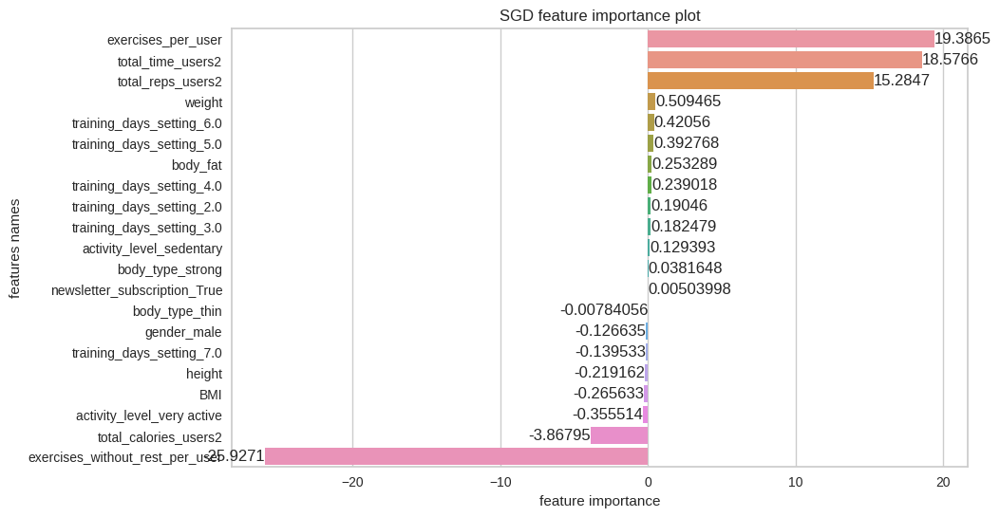

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [-0.6859338568598409, 1.3530466739684344, -0.9386222649824358, 0.2543215856176148, 17.57631812505216, 16.44868188447794, -3.65763799640148, 21.817225723421025, -28.71492675808721, -0.1388421415197229, 0.1259115081923094, -0.3777018853576283, 0.03329794677303614, -0.00996108001246139, 0.013129255838317713, 0.19441182189654233, 0.1851239512582213, 0.23952891583265243, 0.3753610092090877, 0.42449811806384385, -0.13125251631698268]


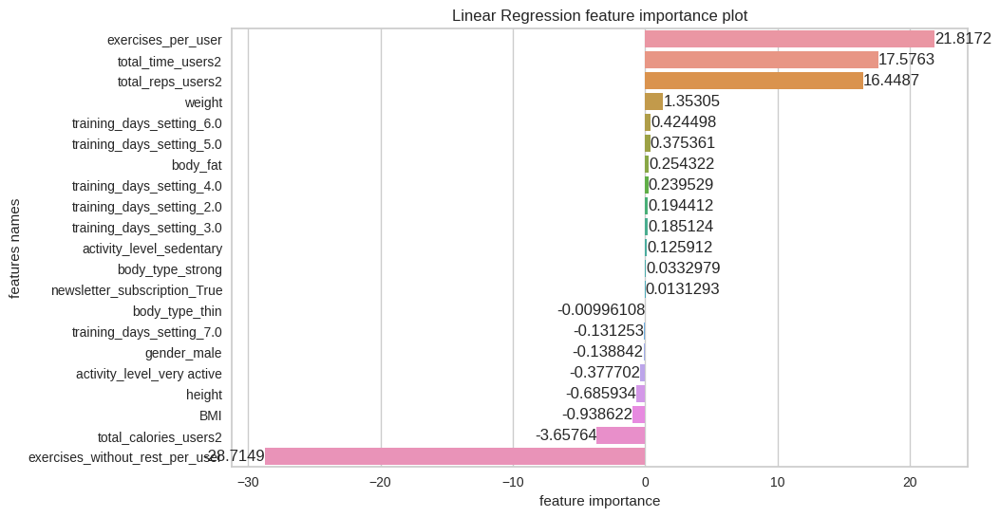

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [-0.6756244094461644, 1.3363974259599054, -0.9243165618101152, 0.25379762140908624, 17.645781143895668, 16.381086959406247, -3.6776286178103197, 21.592291473868578, -28.474628000791977, -0.13770756513824228, 0.1264128846699938, -0.376287600653455, 0.03363925541137665, -0.009993177945271055, 0.012705232680580018, 0.19407888899016498, 0.18464553753916366, 0.239498628953389, 0.376298545443817, 0.4237561899125593, -0.13150256879988217]


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.228e+04, tolerance: 9.549e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.091e+04, tolerance: 9.679e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

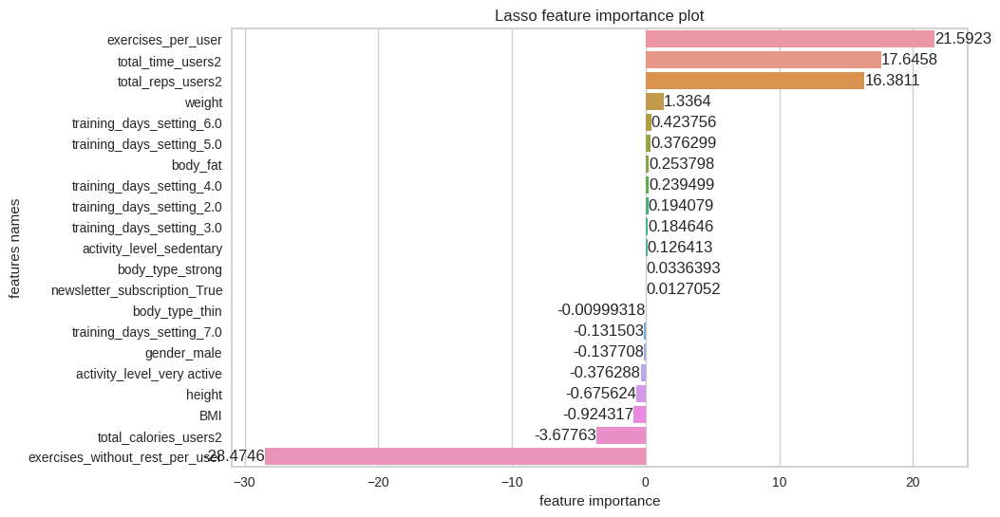

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [-0.6483996048146298, 1.2797008886691996, -0.882382011029574, 0.2520499206927893, 17.785901875540805, 16.01712062832463, -3.5999991109721767, 20.543726061795557, -27.286786572842114, -0.1303448875889614, 0.1277762322201662, -0.3699400914969763, 0.03485955073402301, -0.008857700812271387, 0.010846486387674334, 0.19355685989376267, 0.18569686828636592, 0.2414818618381181, 0.38146470596920706, 0.4214984398814932, -0.1336345285030401]


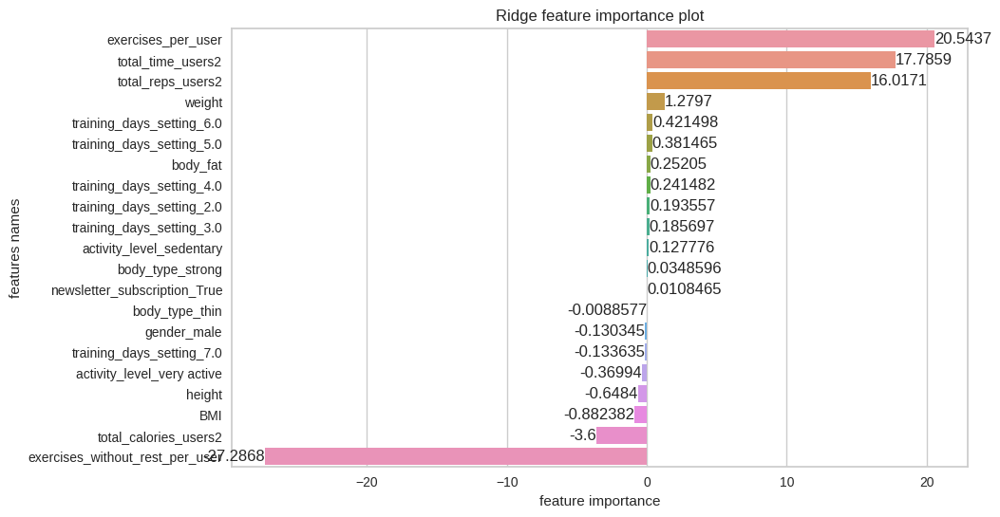

[Ridge] Best parameters are {'alpha': 0.28572285714285717, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.12348026868667512, 0.8765111250369655, 8.60627635948393e-06, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


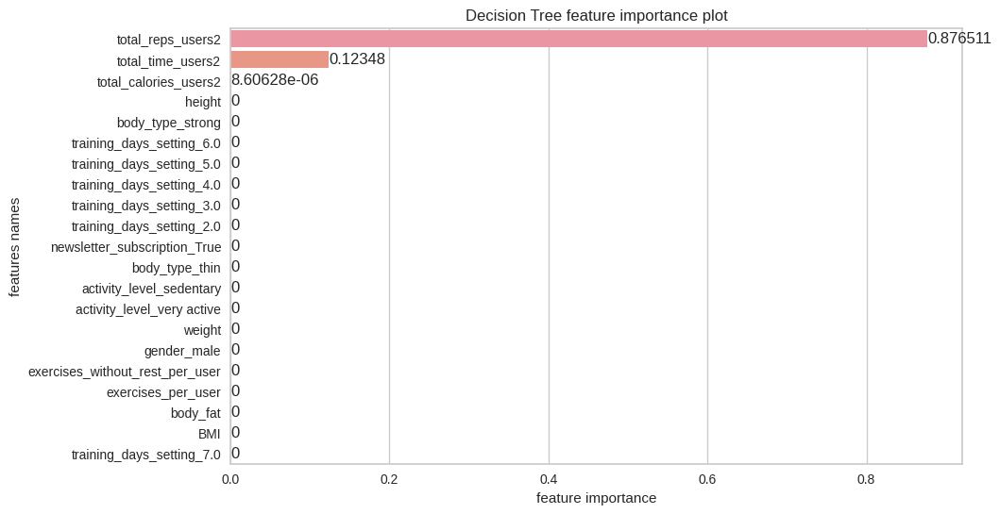

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0008876333371584769, 3.688005842308862e-05, 0.0013820680878015882, 0.00380726851065601, 0.32090079592649723, 0.18450839490109408, 0.2111841562966007, 0.16328295988318178, 0.09846691928872028, 0.004295524852035985, 0.010146110923312801, 0.0, 0.0, 5.1938638445511454e-05, 6.94670117728638e-05, 0.0, 0.0007248528377139423, 0.00016816607977659958, 8.686336680907313e-05, 0.0, 0.0]


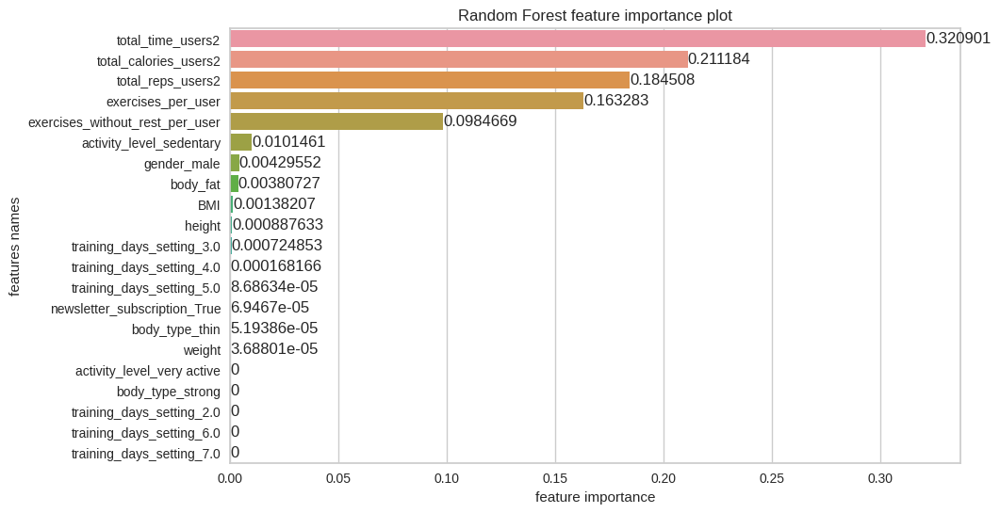

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0034497993833521984, 0.0017425609685632255, 0.0016442473123648973, 0.0009107802834798551, 0.5712802111108094, 0.4083984540670267, 0.0038163771265646664, 0.0029078894137492695, 0.0029158407582988667, 2.1332265673543933e-05, 0.0016896886226124487, 0.00020752130111695226, 3.3219358296939496e-05, 0.0001384803729269611, 0.00012936125051574732, 7.636714530920618e-06, 0.00010288349651317032, 9.478756000524667e-05, 0.0004090267242712231, 1.7059686302410017e-05, 8.284222302528176e-05]


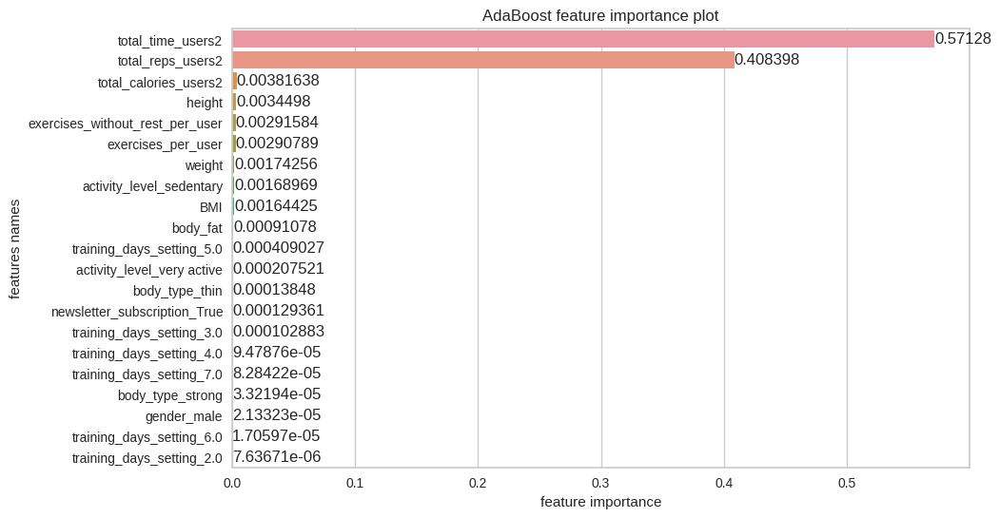

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.05, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.0003504292257614798, 2.8578869626624455e-05, 0.004047076630753973, 0.00018362903337587957, 0.38834345690808153, 0.16003162423224698, 0.2802264642448199, 0.12094749288445845, 0.045825769320432516, 0.0, 1.5478650442618897e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


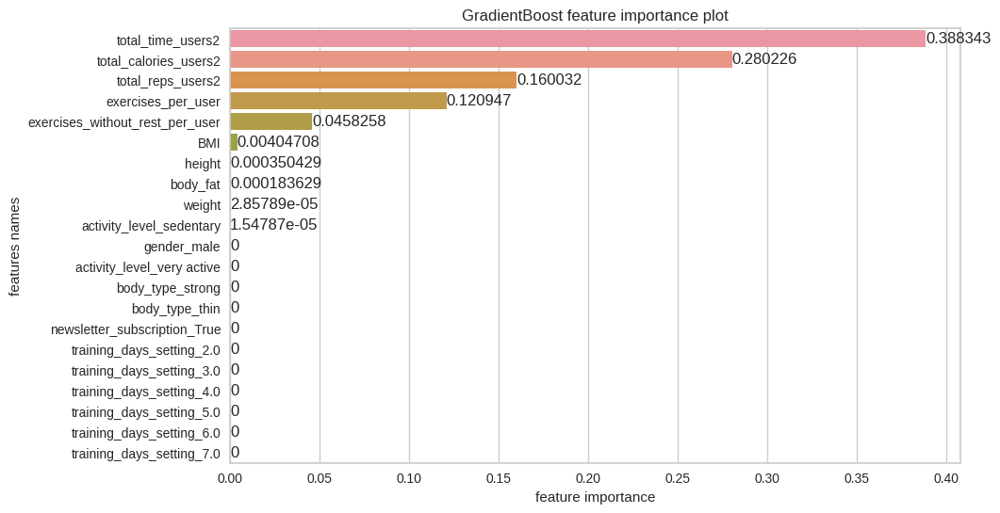

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 4, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [20]:
estimators_multiclass_u, X_test_u, y_test_u, X_train_u, y_train_u, X_train_inv, X_test_inv, features = train(X_users, 
                                                                                                   y_users, 
                                                         params, 
                                                         seed)

In [24]:
evaluation_table_u = evaluate_multiclass(estimators_multiclass_u, X_test_u, y_test_u, features)


In [25]:
evaluation_table_u

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.97,0.97,2.54,0.49,21.84,48.40
Linear Regression,0.97,0.97,2.55,0.49,21.59,46.30
Lasso,0.97,0.97,2.55,0.49,21.61,46.46
Ridge,0.97,0.97,2.54,0.49,21.58,46.58
Decision Tree,0.70,0.70,5.40,0.30,196.67,239.07
Random Forest,0.68,0.68,5.36,0.79,209.11,248.69
AdaBoost,0.95,0.94,2.36,0.20,35.87,95.00
GradientBoost,0.71,0.70,5.51,1.21,191.68,245.12


In [55]:
prediction_for_one_user(estimators_multiclass_u, X_test_u, y_test_u, X_test_inv, X_users.columns, ['total_sessions_users2'], features, name = 'AdaBoost')


,height,weight,BMI,body_fat,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,gender_male,activity_level_sedentary,activity_level_very active,body_type_strong,body_type_thin,newsletter_subscription_True,training_days_setting_2.0,training_days_setting_3.0,training_days_setting_4.0,training_days_setting_5.0,training_days_setting_6.0,training_days_setting_7.0,total_sessions_users2,total_sessions_users2_prediction
704,168.00,64.00,22.68,10.00,62865.00,12561.00,3512.13,60507.00,42457.00,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,50.00,45.37


Here, the best regression model is linear regression. The $R^2$ score is 97%, which is very good, adjusted $R^2$ is also 97%. MAE is 2.53, which is not the lowest for all of the algorithms, MAPE is 0.47, which is also not the lowest number. Max error is the lowest and it is 48.45. But on the other hand, AdaBoost has $R^2$ equal to 95% and the MAPE is 20% and is the lowest. So I would say that AdaBoost is here the best model, because it doesn't violate any of the assumptions.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

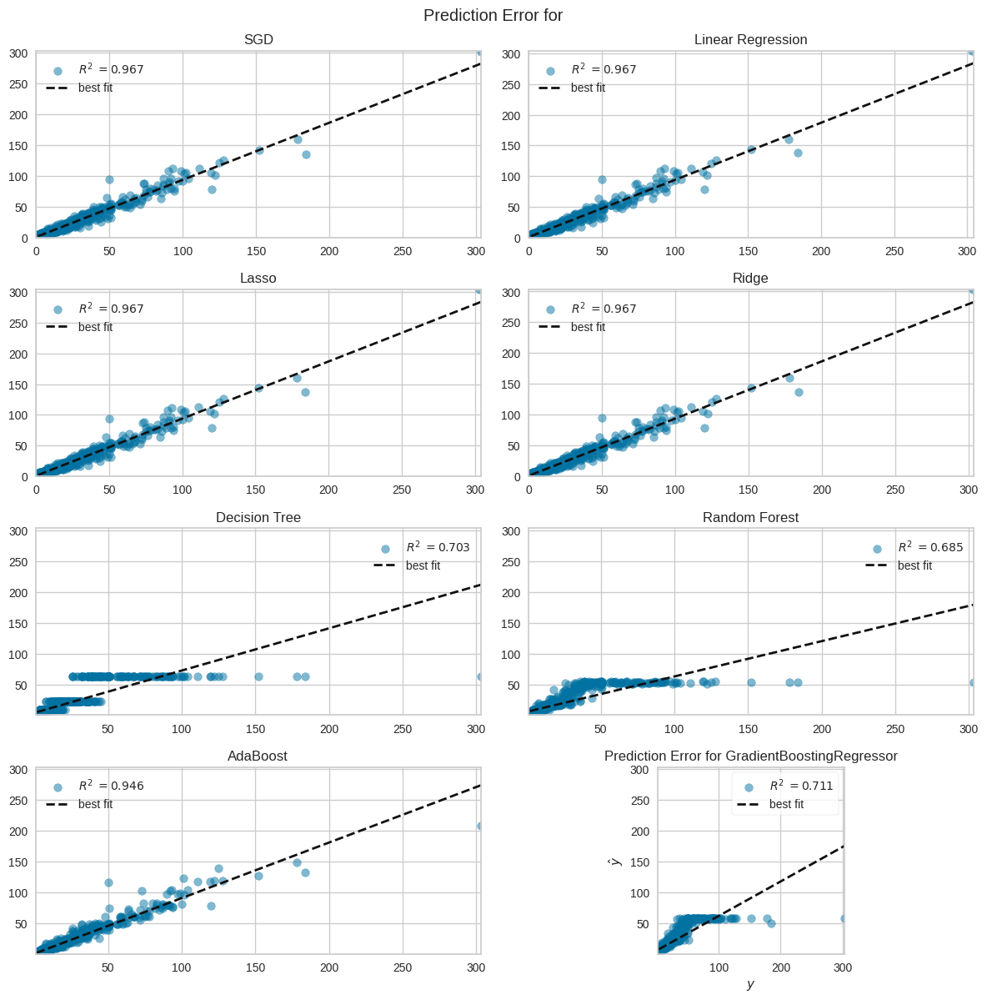

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [23]:
prediction_error_plot(estimators_multiclass_u, X_train_u, y_train_u, X_test_u, y_test_u, features,
                      features_selected = False,
                      name = 'all')

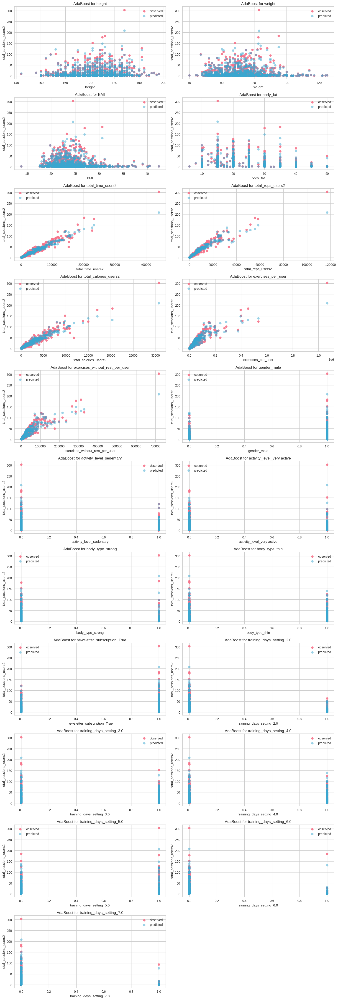

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [24]:
plots_regr(estimators_multiclass_u, X_users,y_users, X_train_u, y_train_u, X_test_u, y_test_u,
           X_train_inv, X_test_inv, features, features_selected = False,
           name = 'AdaBoost')

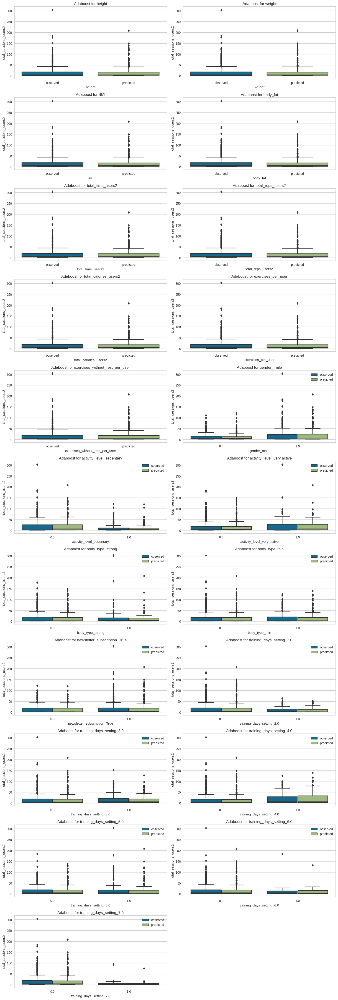

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [25]:
plots_box(estimators_multiclass_u, X_users,y_users, X_train_u, y_train_u, X_test_u, y_test_u, features,
          X_train_inv, 
          X_test_inv, features_selected = False, name = 'AdaBoost')

#### SFS Feature selection

In [26]:
estimators_multiclass_u_sel, X_test_u_sel, y_test_u_sel, X_train_u_sel, y_train_u_sel, X_train_inv_u_sel, X_test_inv_u_sel, features_u_sel = train(X_users, 
                                                                                                   y_users,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['total_time_users2', 'total_reps_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'training_days_setting_3.0',
       'training_days_setting_5.0'],
      dtype='object')
[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male',
       'activity_level_sedentary', 'activity_level_very active',
       'training_days_setting_5.0', 'training_days_setting_6.0'],
      dtype='object')
[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['total_time

In [27]:
evaluation_table_u_sel = evaluate_multiclass(estimators_multiclass_u_sel, X_test_u_sel, y_test_u_sel, features_u_sel, features_selected = True)

In [28]:
evaluation_table_u_sel

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.97,0.97,2.56,0.48,21.22,47.11
Linear Regression,0.97,0.97,2.54,0.48,21.74,46.80
Lasso,0.96,0.96,2.80,0.58,25.97,51.09
Ridge,0.97,0.97,2.55,0.48,21.81,46.96
Decision Tree,0.70,0.70,5.40,0.30,196.67,239.07
Random Forest,0.71,0.70,4.86,0.31,195.51,244.55
AdaBoost,0.94,0.94,2.42,0.20,37.02,95.00
GradientBoost,0.70,0.69,5.62,1.16,198.66,246.59


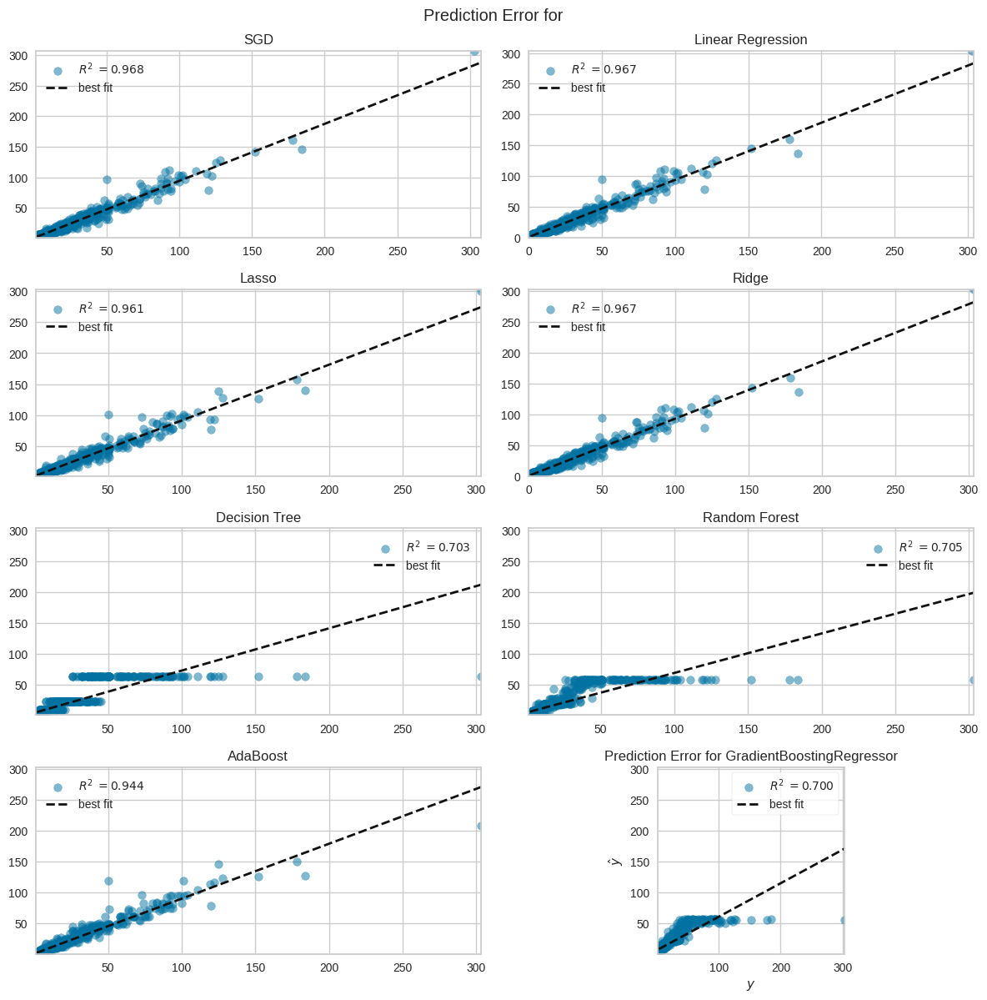

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [29]:
prediction_error_plot(estimators_multiclass_u_sel, X_train_u_sel, y_train_u_sel, X_test_u_sel, 
                      y_test_u_sel, features_u_sel, features_selected = True, name = 'all')

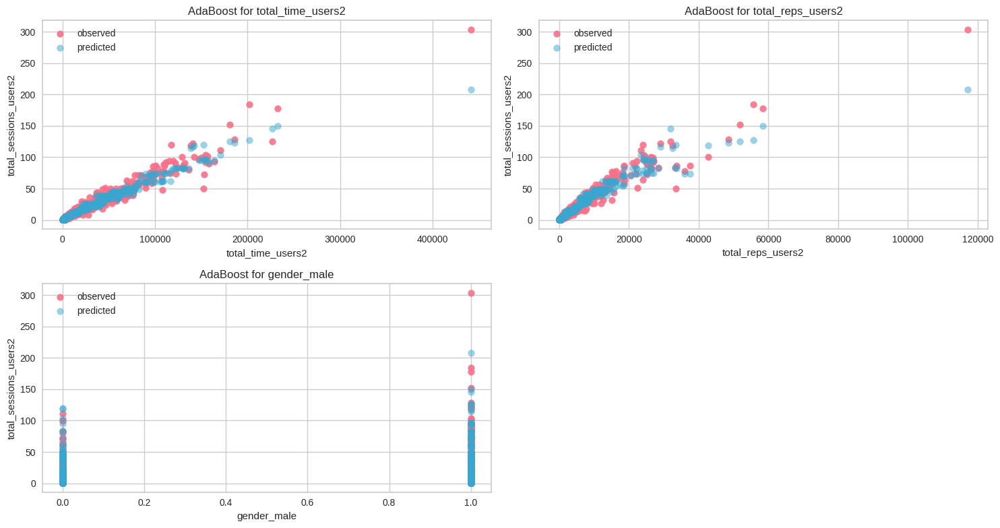

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [30]:
plots_regr(estimators_multiclass_u_sel, X_users,y_users, X_train_u_sel, y_train_u_sel, 
           X_test_u_sel, y_test_u_sel, X_train_inv_u_sel, 
           X_test_inv_u_sel, features_u_sel, features_selected = True, name = 'AdaBoost')

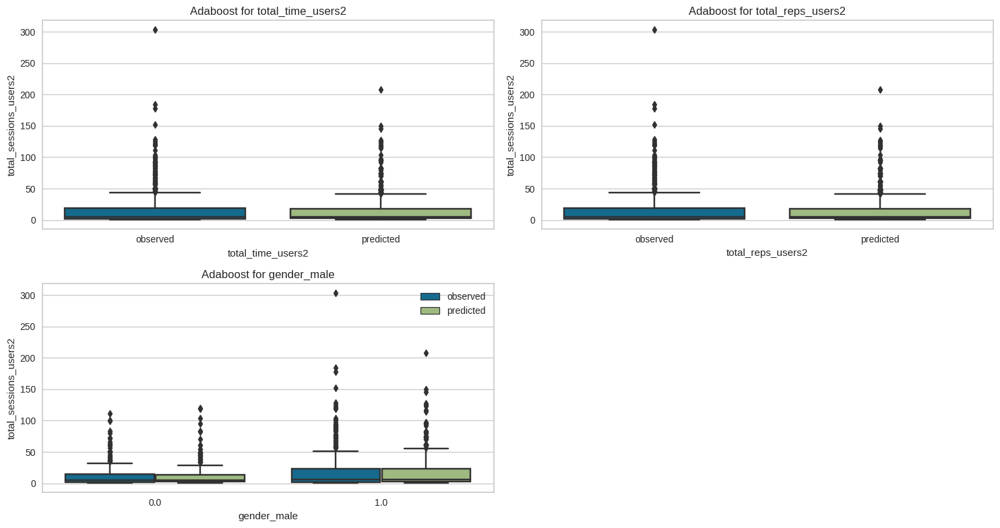

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [31]:
plots_box(estimators_multiclass_u_sel, X_users, y_users, X_train_u_sel, y_train_u_sel, X_test_u_sel, y_test_u_sel, features_u_sel, X_train_inv_u_sel, 
          X_test_inv_u_sel, features_selected = True, name = 'AdaBoost')

#### RFECV Feature Selection

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male',
       'activity_level_sedentary', 'activity_level_very active',
       'body_type_strong', 'body_type_thin', 'newsletter_subscription_True',
       'training_days_setting_2.0', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Features importances: [-0.21916248944919312, 0.5094648839939211, -0.2656332838408943, 0.25328935926207674, 18.57657970294541, 15.284708406343261, -3.8679487132026145, 19.386472377166125, -25.927077889160724, -0.12663520962121821, 0.12939333430967698, -0.35551379766486113, 0.03816479448795161, -0.007840555997071492, 0.005039984211613159, 0.19046030355066632, 0.182478

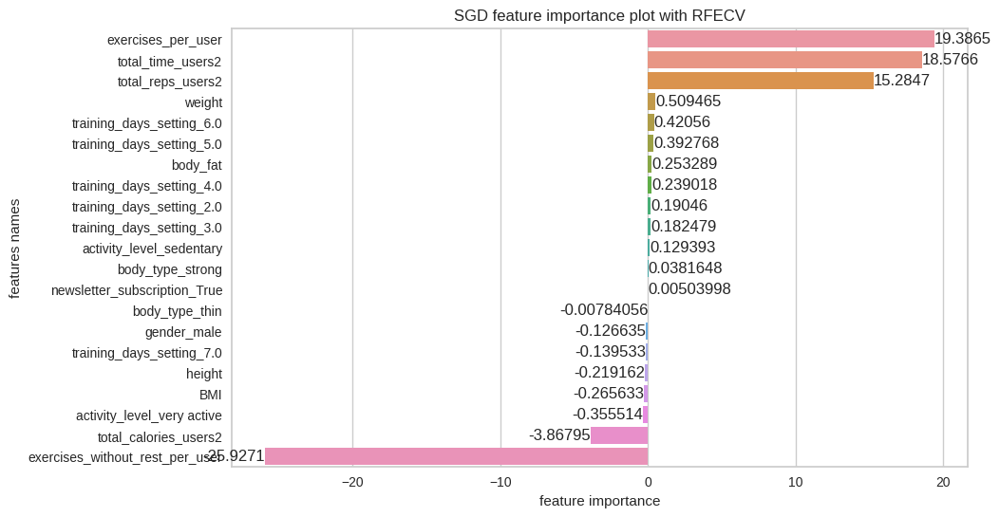

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_6.0'],
      dtype='object')
[Linear Regression] Features importances: [-0.7745027924030398, 1.3508410113837845, -0.9504727334766214, 0.2833938460490654, 17.500894072994406, 16.52906651770397, -3.6549107594073225, 22.03632772237239, -28.95031260042722, -0.4273946250504046, 0.34162493662597576]


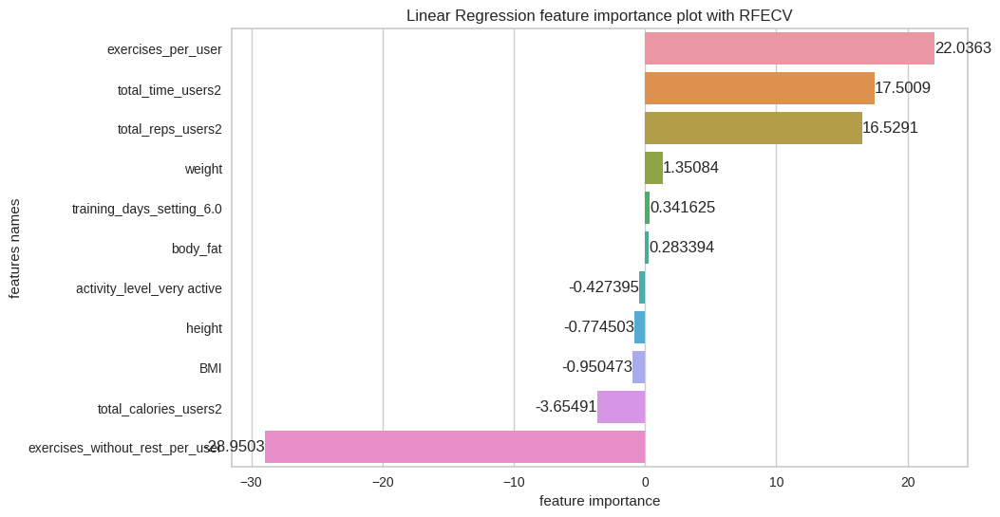

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['total_time_users2', 'total_reps_users2'], dtype='object')
[Lasso] Features importances: [18.89966925227309, 4.361573708847853]


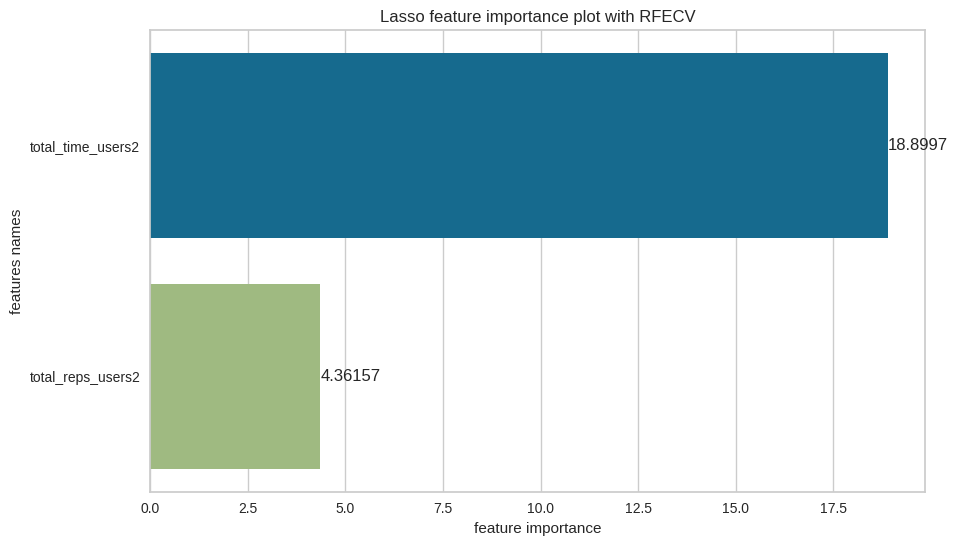

[Lasso] Best parameters are {'alpha': 0.28572285714285717, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features selected: Index(['height', 'weight', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_6.0'],
      dtype='object')
[Ridge] Features importances: [-0.8418580616014633, 1.459108648249954, -0.8517678168242817, 17.702198951430876, 16.122208374176918, -3.6203682221720386, 20.696101521387117, -27.469465973335684, -0.456505379774382, 0.3419771717776186]


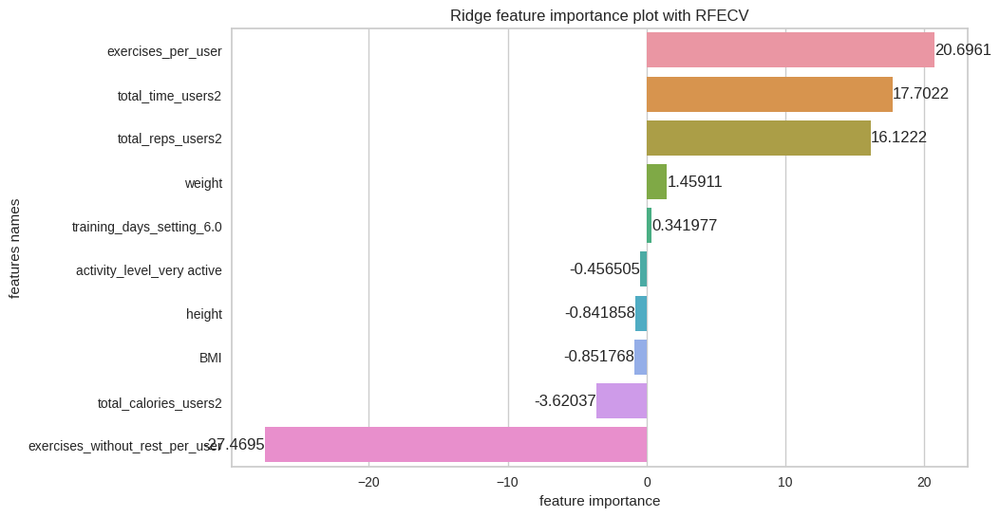

[Ridge] Best parameters are {'alpha': 0.28572285714285717, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user'],
      dtype='object')
[Decision Tree] Features importances: [0.12348026868667512, 0.8765111250369655, 8.60627635948393e-06, 0.0]


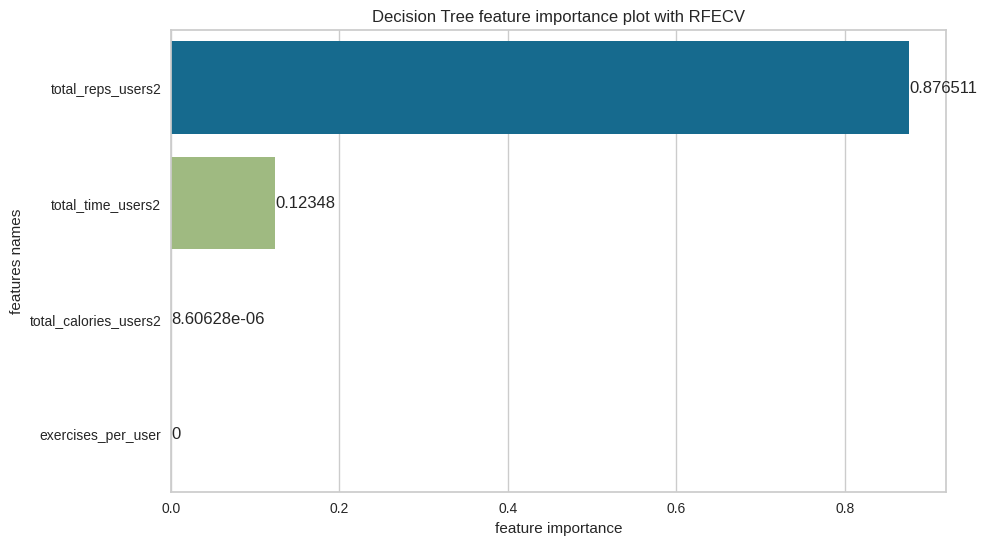

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_per_user', 'exercises_without_rest_per_user'],
      dtype='object')
[Random Forest] Features importances: [0.39023493860054087, 0.3132873622496424, 0.19760989882892982, 0.09853536309586301, 0.0003324372250240067]


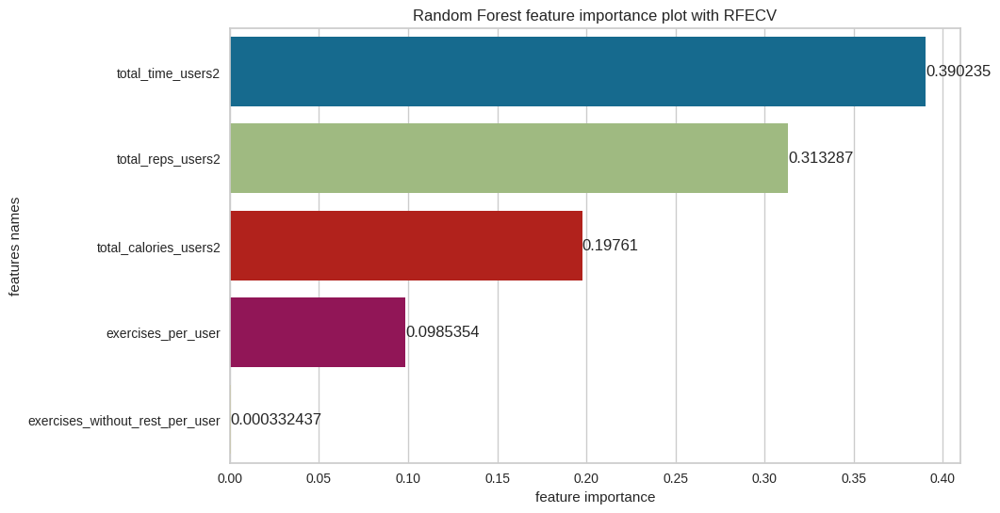

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['total_time_users2', 'total_reps_users2'], dtype='object')
[AdaBoost] Features importances: [0.5033768394044361, 0.49662316059556405]


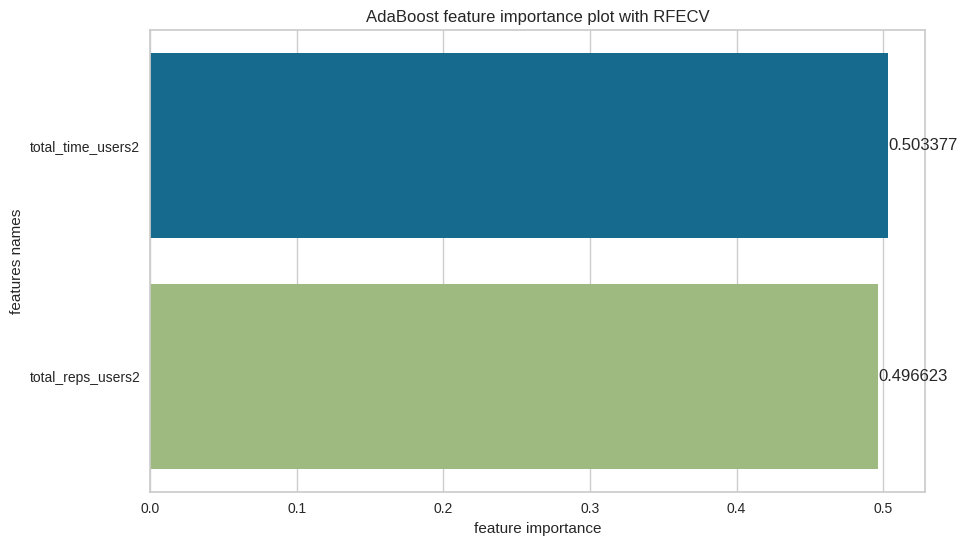

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['total_time_users2', 'total_reps_users2', 'total_calories_users2',
       'exercises_without_rest_per_user'],
      dtype='object')
[GradientBoost] Features importances: [0.32514290182178107, 0.513515348647779, 0.117283233273165, 0.044058516257274936]


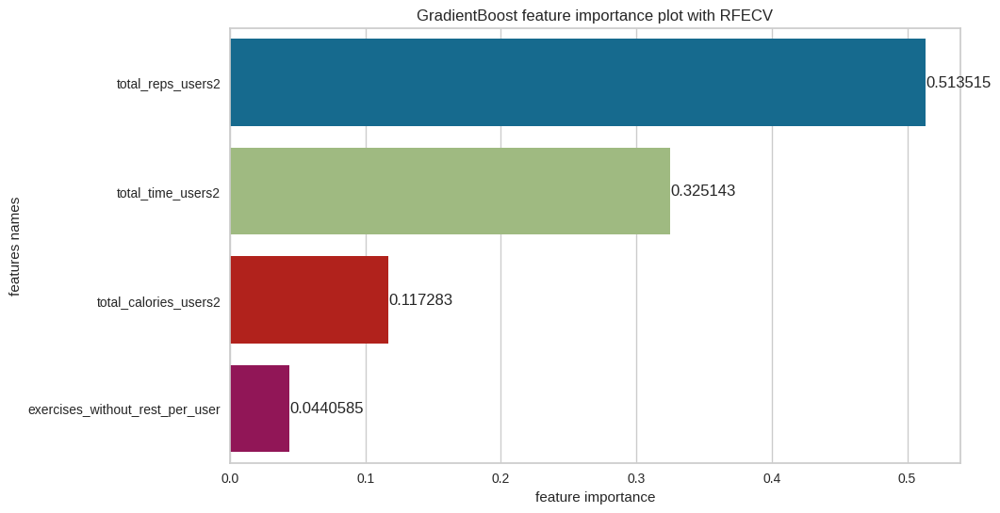

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [32]:
estimators_multiclass_u_sel_rfecv, X_test_u_sel_rfecv, y_test_u_sel_rfecv, X_train_u_sel_rfecv, y_train_u_sel_rfecv, X_train_inv_u_sel_rfecv, X_test_inv_u_sel_rfecv, features_u_sel_rfecv = train(X_users, 
                                                                                                   y_users,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [33]:
evaluation_table_u_sel_rfecv = evaluate_multiclass(estimators_multiclass_u_sel_rfecv, X_test_u_sel_rfecv, y_test_u_sel_rfecv, features_u_sel_rfecv, features_selected = True)

In [34]:
evaluation_table_u_sel_rfecv

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.97,0.97,2.54,0.49,21.84,48.40
Linear Regression,0.97,0.97,2.54,0.47,21.73,46.14
Lasso,0.96,0.96,2.80,0.58,25.97,51.09
Ridge,0.97,0.97,2.54,0.47,21.82,46.62
Decision Tree,0.70,0.70,5.40,0.30,196.67,239.07
Random Forest,0.70,0.70,4.90,0.29,195.78,244.05
AdaBoost,0.94,0.94,2.41,0.20,37.07,95.00
GradientBoost,0.72,0.72,5.30,1.08,186.98,245.17


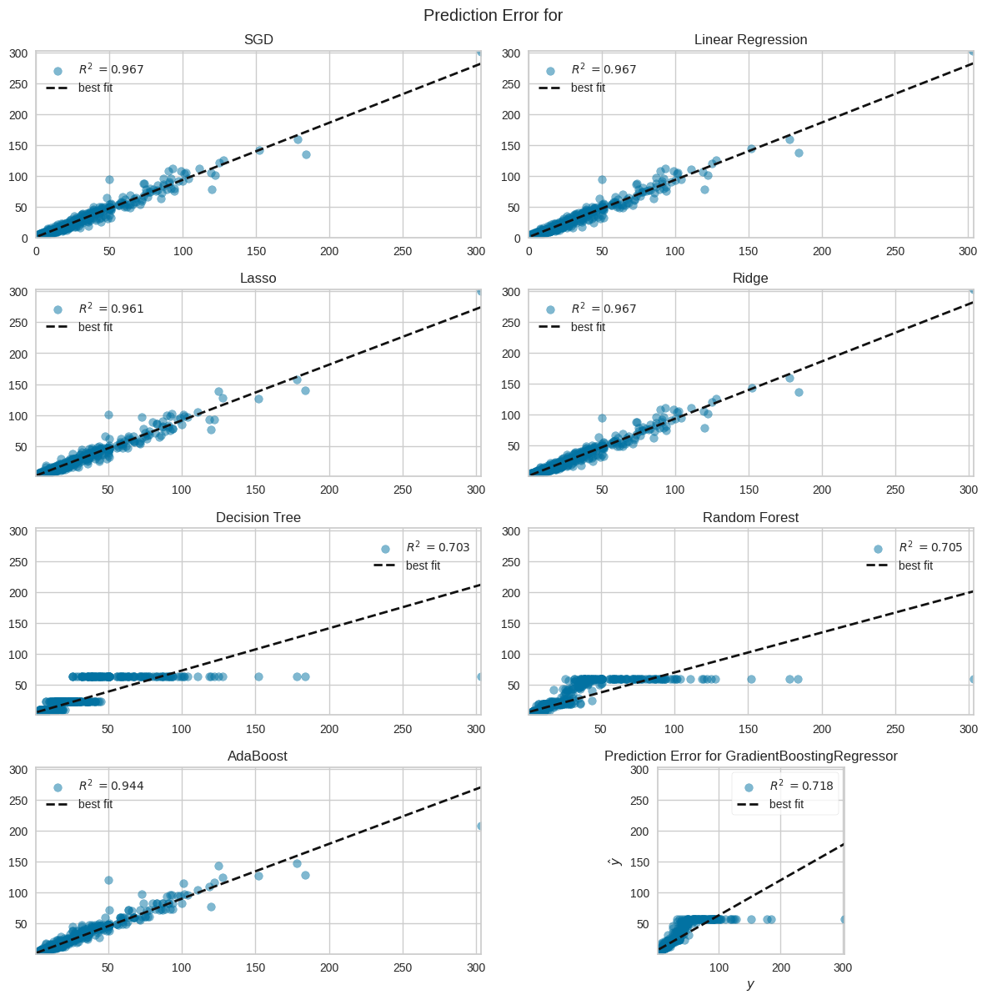

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [35]:
prediction_error_plot(estimators_multiclass_u_sel_rfecv, X_train_u_sel_rfecv, y_train_u_sel_rfecv, 
                      X_test_u_sel_rfecv, y_test_u_sel_rfecv, features_u_sel_rfecv, 
                      features_selected = True, name = 'all')

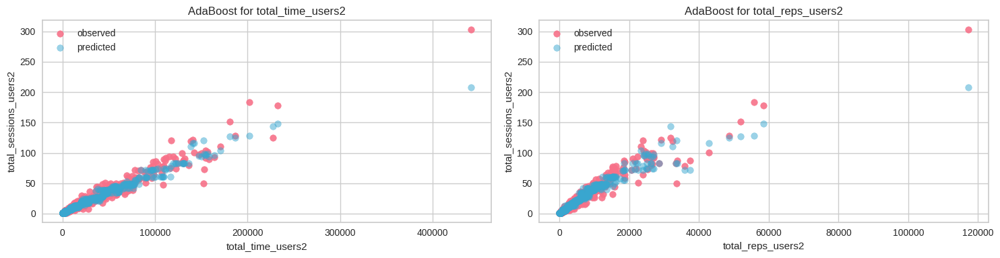

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [36]:
plots_regr(estimators_multiclass_u_sel_rfecv, X_users, y_users, X_train_u_sel_rfecv, y_train_u_sel_rfecv, 
           X_test_u_sel_rfecv, y_test_u_sel_rfecv, X_train_inv_u_sel_rfecv, 
           X_test_inv_u_sel_rfecv, features_u_sel_rfecv, features_selected = True, name = 'AdaBoost')

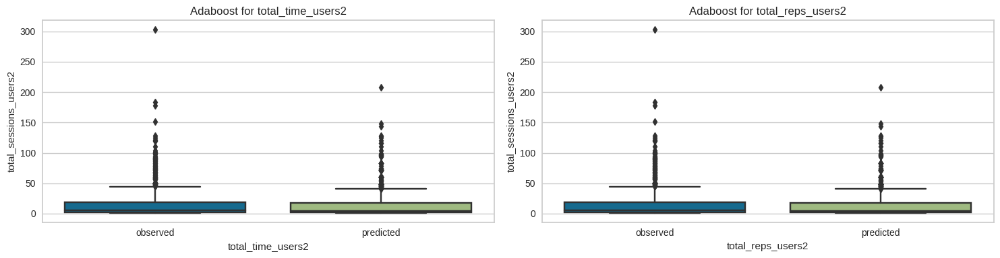

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [37]:
plots_box(estimators_multiclass_u_sel_rfecv, X_users, y_users, X_train_u_sel_rfecv, y_train_u_sel_rfecv, 
          X_test_u_sel_rfecv, y_test_u_sel_rfecv, features_u_sel_rfecv, X_train_inv_u_sel_rfecv, 
          X_test_inv_u_sel_rfecv, features_selected = True, name = 'AdaBoost')

#### SFM Feature Selection

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['body_fat', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_3.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[SGD] Features importances: [0.37262453658348776, 18.303160569392173, 15.506563660460898, -3.771617504586856, 20.0475118384228, -26.648605974181436, -0.3912746565183515, -0.07275657836574223, 0.19516941430686896, 0.33721043563593234, -0.2116600431015205]


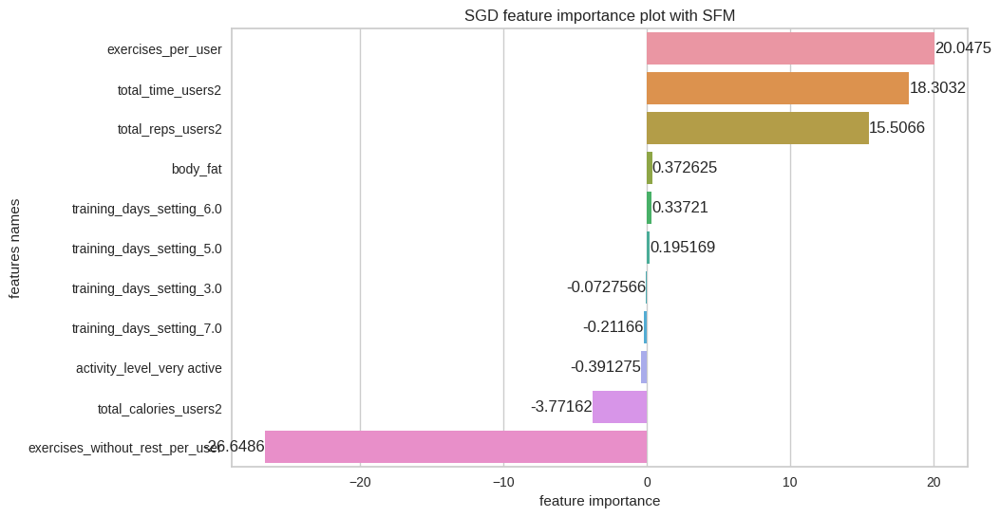

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['height', 'weight', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_5.0', 'training_days_setting_6.0'],
      dtype='object')
[Linear Regression] Features importances: [-0.8853262875306158, 1.5510584272150814, -0.9303316431336133, 17.593594660126108, 16.467665575408407, -3.718134506770919, 21.746563451779938, -28.674160623483104, -0.4605115065167114, 0.23267444181028346, 0.3653886734511574]


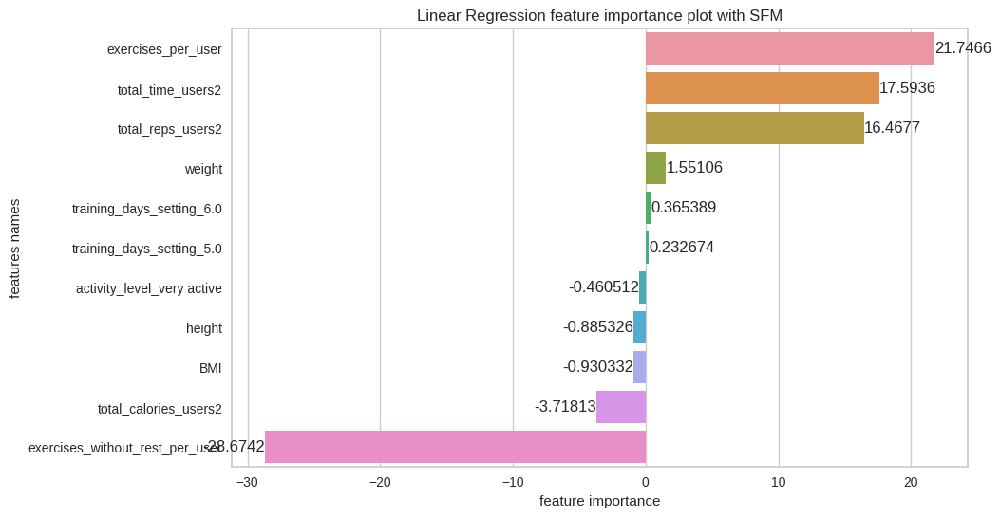

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'gender_male',
       'activity_level_sedentary', 'activity_level_very active',
       'body_type_strong', 'body_type_thin', 'newsletter_subscription_True',
       'training_days_setting_2.0', 'training_days_setting_3.0',
       'training_days_setting_4.0', 'training_days_setting_5.0',
       'training_days_setting_6.0', 'training_days_setting_7.0'],
      dtype='object')
[Lasso] Features importances: [-0.6756244094461533, 1.33639742595989, -0.9243165618101024, 0.2537976214090877, 17.645781143895682, 16.381086959406236, -3.6776286178103286, 21.592291473868507, -28.474628000791913, -0.13770756513824214, 0.12641288466999104, -0.3762876006534559, 0.03363925541

/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.064e+04, tolerance: 9.347e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.155e+04, tolerance: 1.040e+02
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

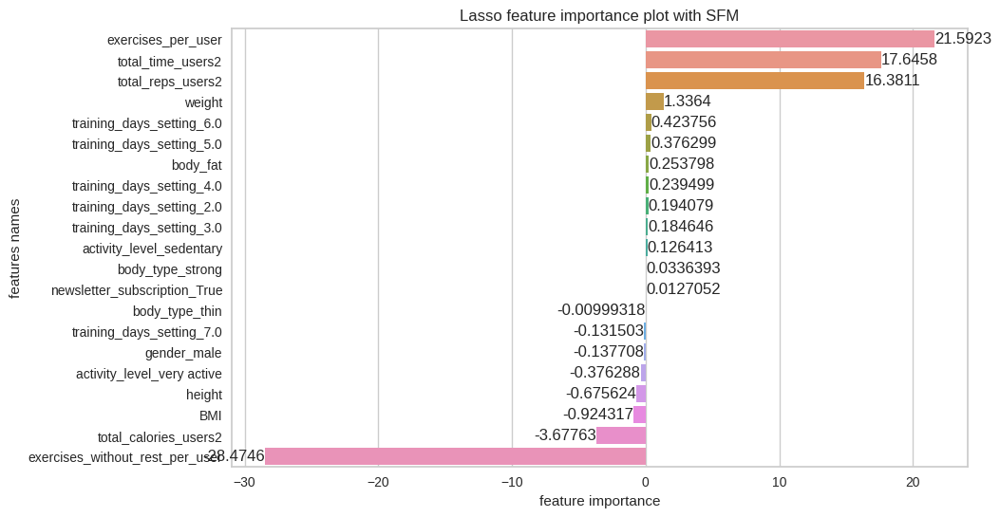

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features selected: Index(['height', 'weight', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_very active',
       'training_days_setting_5.0', 'training_days_setting_6.0'],
      dtype='object')
[Ridge] Features importances: [-0.8370766990021833, 1.4683258385725033, -0.8669034130796159, 17.802455023831392, 16.038527528897575, -3.660314593176805, 20.483280931579714, -27.2576204783914, -0.45234451451575475, 0.2385816236699452, 0.3623087147069301]


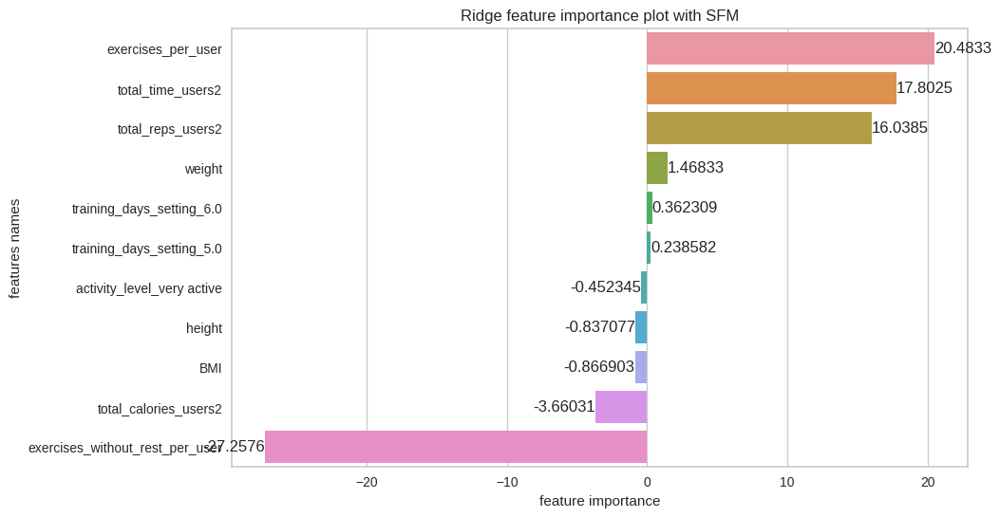

[Ridge] Best parameters are {'alpha': 0.28572285714285717, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary',
       'newsletter_subscription_True'],
      dtype='object')
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.12348026868667512, 0.8765111250369655, 8.60627635948393e-06, 0.0, 0.0, 0.0, 0.0]


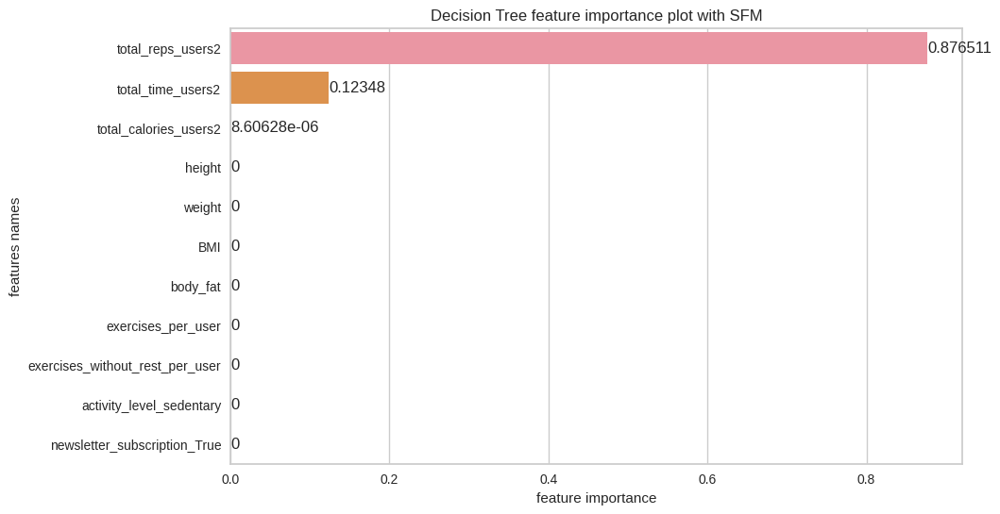

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary',
       'training_days_setting_4.0'],
      dtype='object')
[Random Forest] Features importances: [0.0009403089425272124, 0.0005367437789011972, 0.0015359807338694359, 0.0006763324228427064, 0.2446031136857984, 0.24912135132377317, 0.19989616242190567, 0.19009823219438016, 0.10746464149870243, 0.005127132997299792, 0.0]


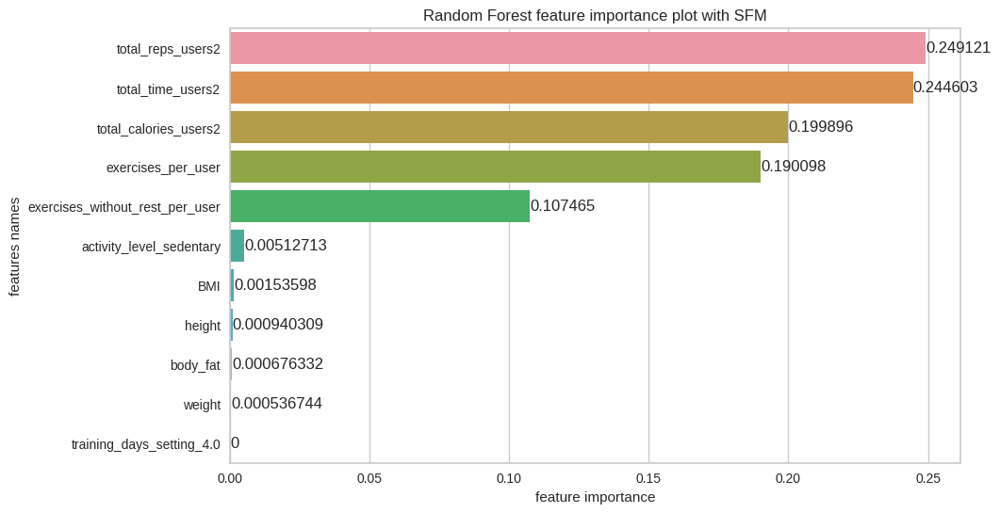

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'BMI', 'total_time_users2', 'total_reps_users2',
       'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'body_type_thin',
       'training_days_setting_5.0', 'training_days_setting_6.0'],
      dtype='object')
[AdaBoost] Features importances: [0.005292641750814301, 0.0012658726127620693, 0.0023818969119542765, 0.6648108603717274, 0.3119184612254058, 0.004919685362204852, 0.003984481712405544, 0.004122745583249981, 0.00025822075438235214, 0.0008575410763972133, 0.0001875926386964849]


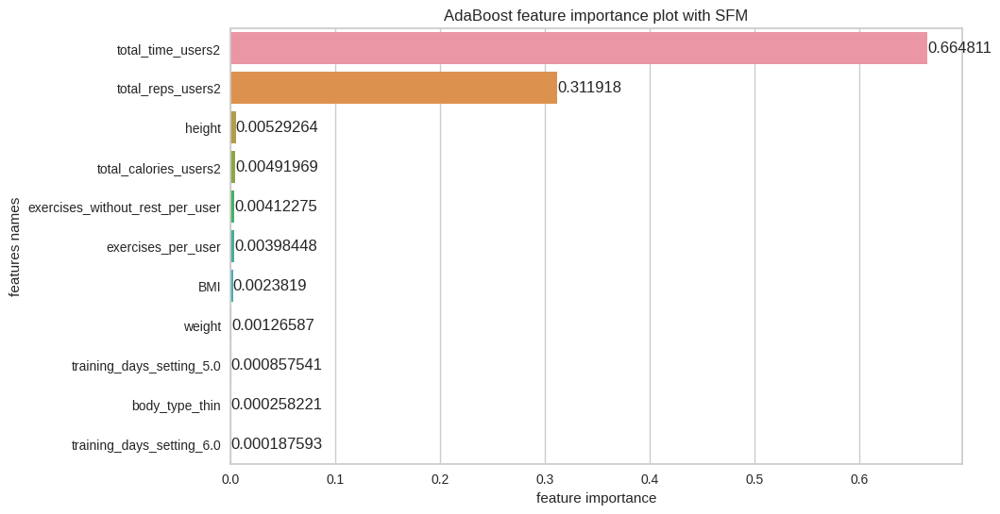

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.075, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'total_time_users2',
       'total_reps_users2', 'total_calories_users2', 'exercises_per_user',
       'exercises_without_rest_per_user', 'activity_level_sedentary',
       'training_days_setting_5.0'],
      dtype='object')
[GradientBoost] Features importances: [3.719528231602745e-06, 1.0572200151213657e-05, 0.0018204904587003203, 0.0001191728341369106, 0.35029478239433764, 0.3899092136588316, 0.11561989661159847, 0.07168567971108365, 0.06916443871444367, 0.000549009619806684, 0.0008230242686783942]


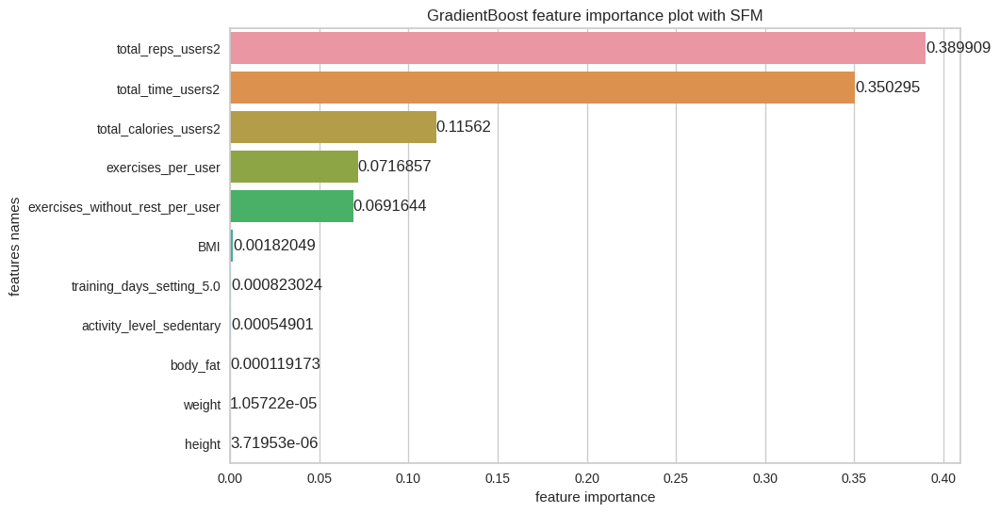

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [38]:
estimators_multiclass_u_sel_sfm, X_test_u_sel_sfm, y_test_u_sel_sfm, X_train_u_sel_sfm, y_train_u_sel_sfm, X_train_inv_u_sel_sfm, X_test_inv_u_sel_sfm, features_u_sel_sfm = train(X_users, 
                                                                                                   y_users,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [39]:
evaluation_table_u_sel_sfm = evaluate_multiclass(estimators_multiclass_u_sel_sfm,
                                                 X_test_u_sel_sfm, y_test_u_sel_sfm, 
                                                 features_u_sel_sfm, features_selected = True)

In [40]:
evaluation_table_u_sel_sfm

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.97,0.97,2.55,0.48,21.91,47.93
Linear Regression,0.97,0.97,2.56,0.48,21.85,46.75
Lasso,0.97,0.97,2.55,0.49,21.61,46.46
Ridge,0.97,0.97,2.56,0.49,21.84,47.03
Decision Tree,0.70,0.70,5.40,0.30,196.67,239.07
Random Forest,0.70,0.69,4.98,0.45,201.27,246.02
AdaBoost,0.94,0.94,2.42,0.20,37.22,95.00
GradientBoost,0.70,0.70,5.61,1.22,198.23,247.42


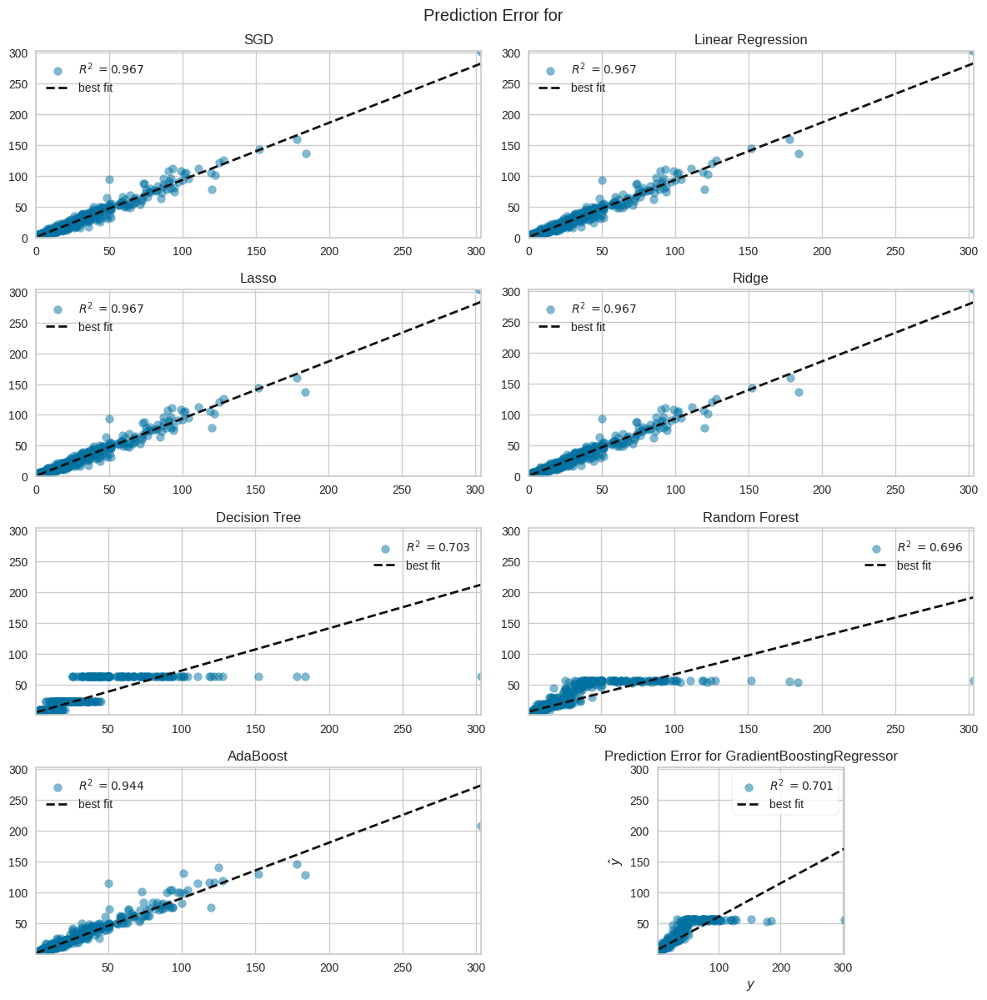

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [41]:
prediction_error_plot(estimators_multiclass_u_sel_sfm, X_train_u_sel_sfm, y_train_u_sel_sfm, 
                      X_test_u_sel_sfm, y_test_u_sel_sfm, features_u_sel_sfm, 
                      features_selected = True, name = 'all')

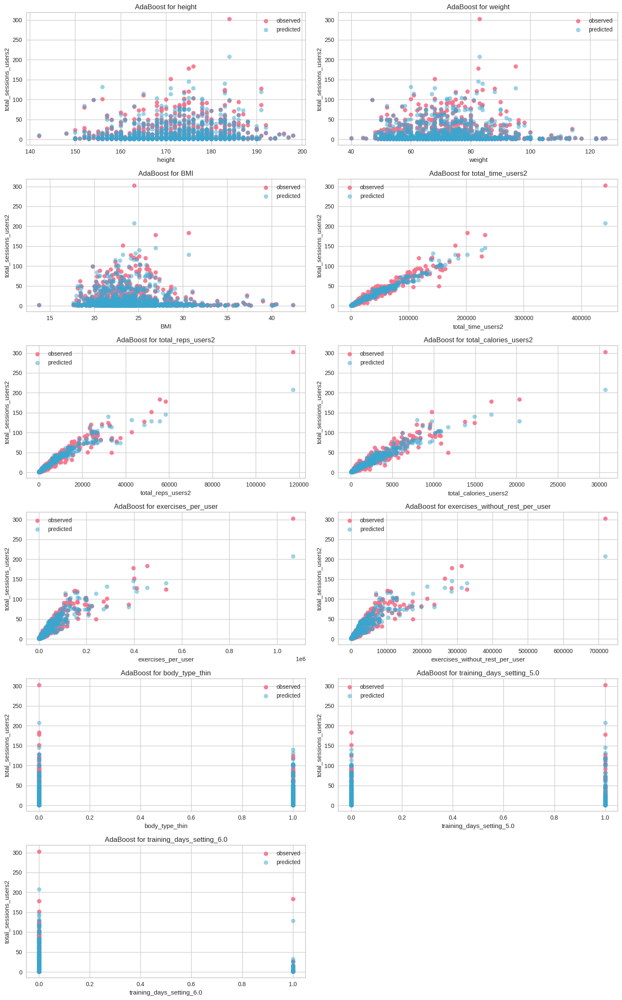

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [42]:
plots_regr(estimators_multiclass_u_sel_sfm, X_users, y_users, X_train_u_sel_sfm, y_train_u_sel_sfm, 
           X_test_u_sel_sfm, y_test_u_sel_sfm, X_train_inv_u_sel_sfm, 
           X_test_inv_u_sel_sfm, features_u_sel_sfm, features_selected = True, name = 'AdaBoost')

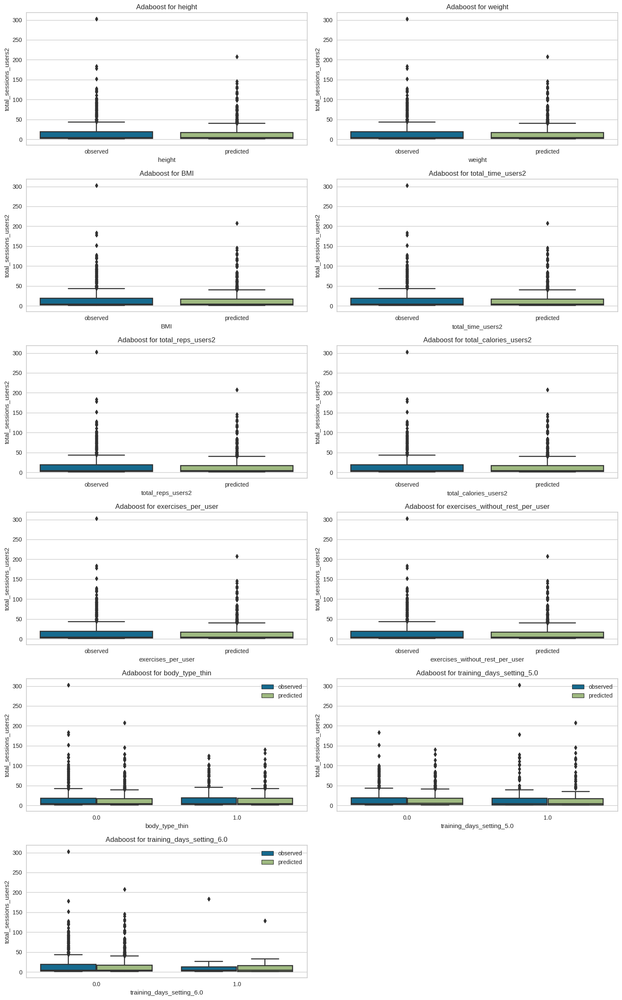

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [43]:
plots_box(estimators_multiclass_u_sel_sfm, X_users, y_users, X_train_u_sel_sfm, y_train_u_sel_sfm, 
          X_test_u_sel_sfm, y_test_u_sel_sfm, features_u_sel_sfm, X_train_inv_u_sel_sfm, 
          X_test_inv_u_sel_sfm, features_selected = True, name = 'AdaBoost')

### No violation of assumptions of linear models

In [44]:
X_users = df_users_only.loc[:, ['gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 
                                'reps_per_session_users2', 'kcal_per_session_users2']]
'''
for col in ['gender', 'activity_level', 'body_type', 'newsletter_subscription']:
    X_users[col] = LabelEncoder().fit_transform(X_users[col])
'''

cat_cols = ['gender', 'activity_level', 'body_type', 'newsletter_subscription', 'training_days_setting']
X_users = pd.get_dummies(X_users, columns = cat_cols, drop_first = True)

y_users = df_users_only['total_sessions_users2']

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [6.4792303150131145, -12.974694156173145, 8.1904823563987, -1.0901566248575314, 3.2124255369786425, 3.080302908192629, 2.1748211604680567, -1.3026437804983972, 0.9993456448126199, -0.4297963789364656, -0.960343687417784, 0.23238828689545638, 0.7448872073726515, 1.920042065771827, 3.59938997951541, 4.069535430967624, 2.1941060698237616, 1.9610335462782935]


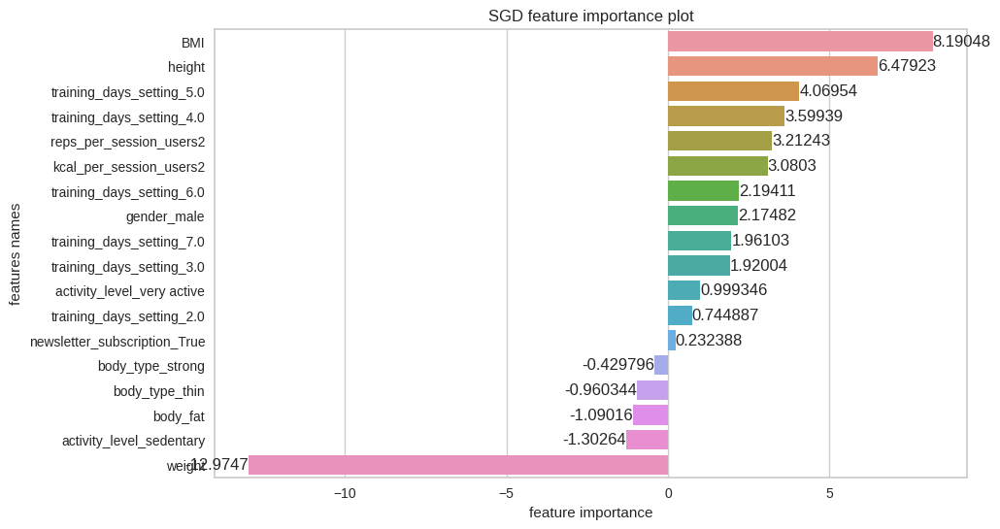

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.1, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [2.7506190997798012, -6.152023247301924, 2.860002537365125, -1.1385587361565004, 3.209230684436991, 3.0964626762599843, 2.232078076852328, -1.289722069518738, 1.0208498554187322, -0.4580763034761796, -0.9686659821138327, 0.23072009653632045, 0.7600308063375992, 1.941630939579116, 3.626439196376707, 4.088112209654281, 2.1984622875552944, 1.97638746887422]


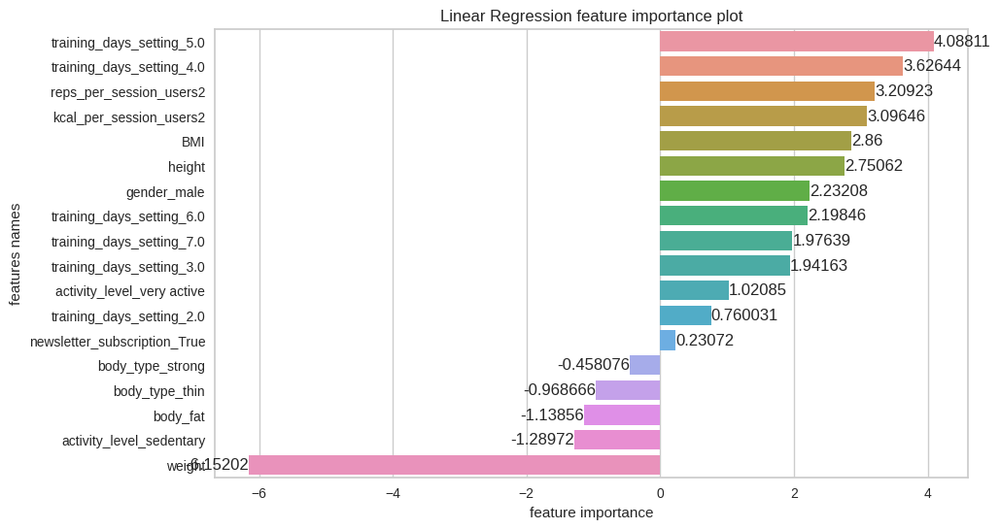

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [2.746852648448693, -6.1451260082021735, 2.854631887413201, -1.138596395173053, 3.209250476432451, 3.09644497925005, 2.2321315650183755, -1.2897117795428148, 1.0208577532307452, -0.4580914984270399, -0.9686564635068453, 0.2307206544126455, 0.7599455213431832, 1.9414784574296284, 3.6263223945211824, 4.087995173573333, 2.1984028555955195, 1.976324395987255]


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.171e+05, tolerance: 9.347e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.127e+05, tolerance: 9.549e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

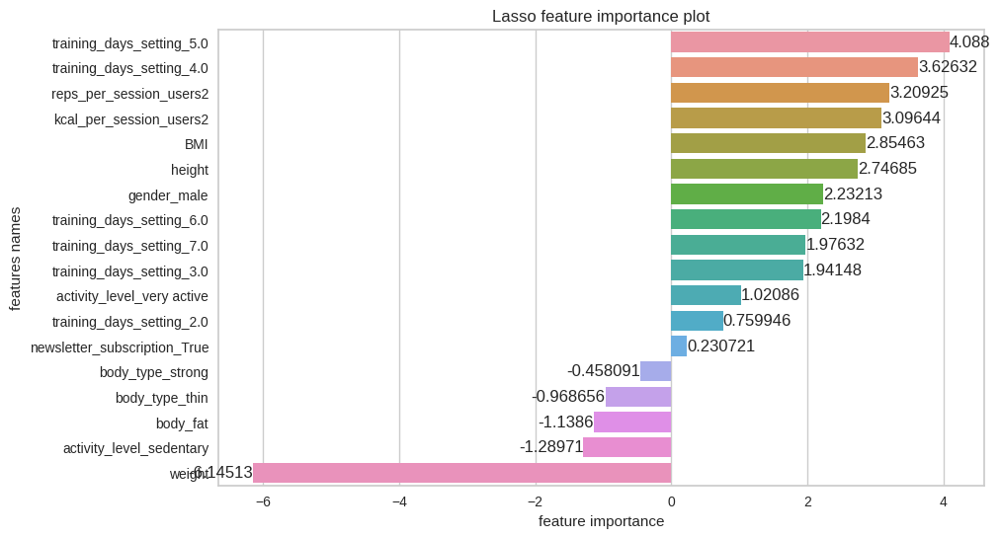

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [2.170075227965608, -5.080534539991971, 2.026061248816397, -1.1450890379146994, 3.2113873364008083, 3.0917767490091386, 2.237596973489925, -1.289152750258486, 1.0228712475264006, -0.4614981241303125, -0.9684744798622534, 0.23316541253438136, 0.740404482658404, 1.9042169593652973, 3.5955670736638625, 4.057563129697738, 2.1840136113915642, 1.9617053356126724]


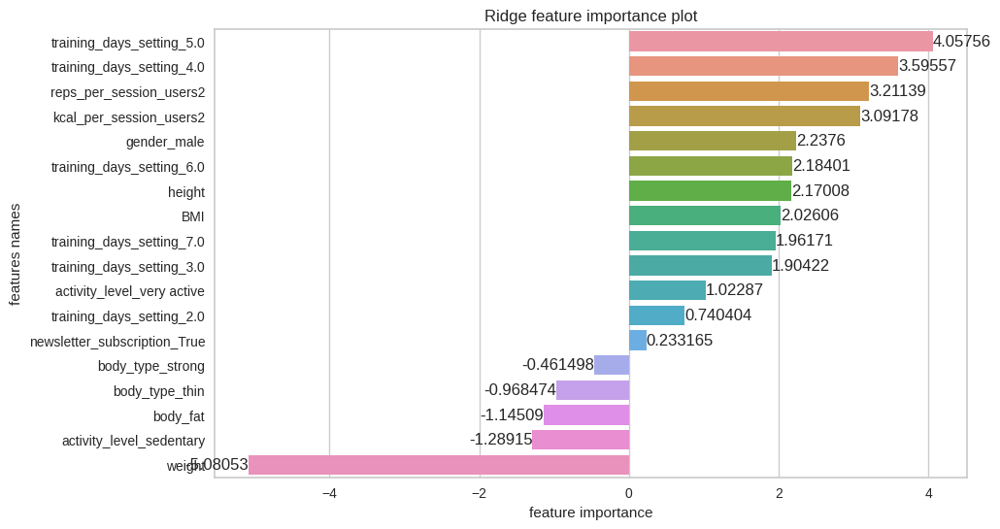

[Ridge] Best parameters are {'alpha': 2.0, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.04083069124270001, 0.6938515613948737, 0.17062444041503264, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.09469330694739381, 0.0, 0.0, 0.0, 0.0]


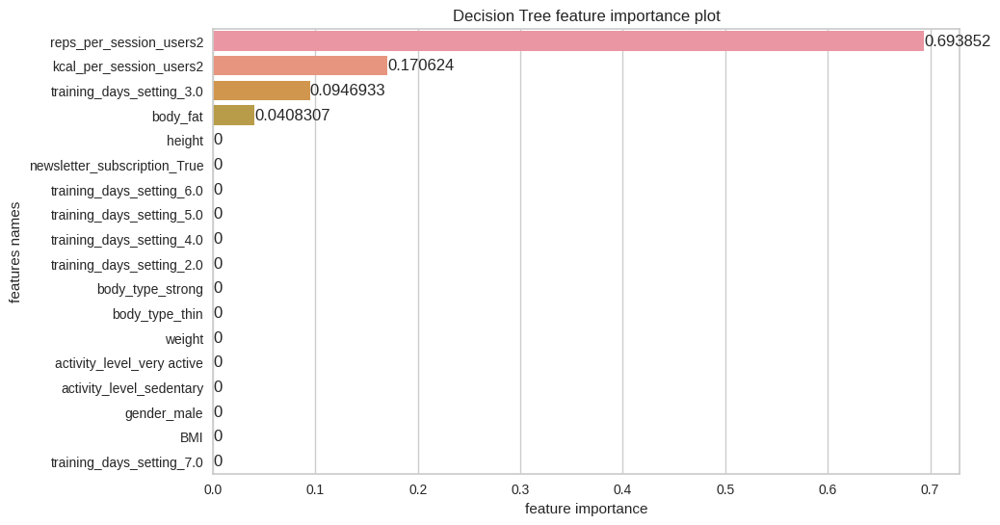

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.05404340513518914, 0.03103872519731446, 0.04581920949409339, 0.06178374311345313, 0.3273586483268645, 0.3001710207538115, 0.06090704606660793, 0.08265770425512525, 0.0, 0.0, 0.004334183616554834, 0.00042737145072592366, 0.0, 0.029357812926537087, 0.0, 0.0021011296637229483, 0.0, 0.0]


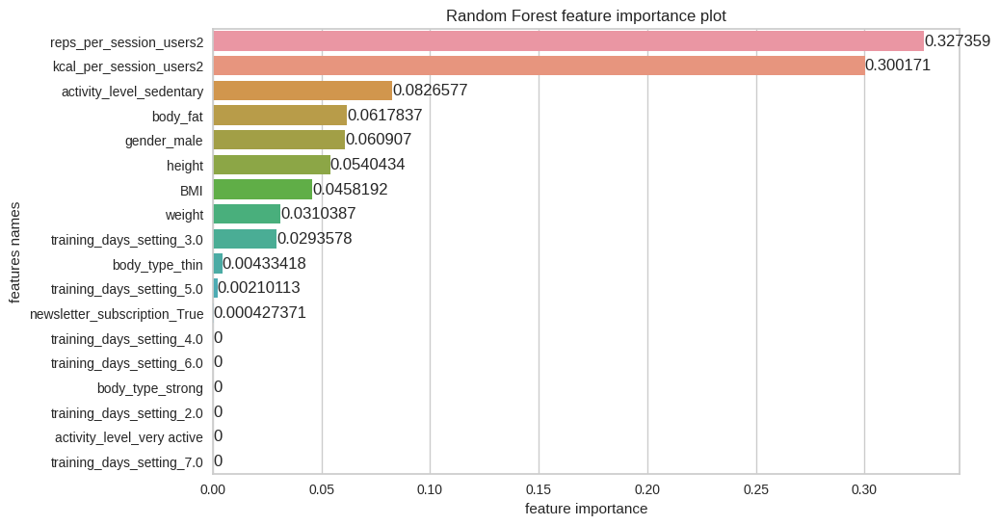

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.029068938086258825, 0.05952538008400133, 0.06926484384543301, 0.03347110158112676, 0.44238058229252, 0.20169781821134516, 0.0031862988274212163, 0.011337261239425543, 0.01871795925310859, 0.0032421023486938847, 0.002949586171372547, 0.005731703535300778, 0.0010502738610048894, 0.026911483875558702, 0.0038651268643841233, 0.03660952977790784, 0.011995239210023875, 0.03899477093511269]


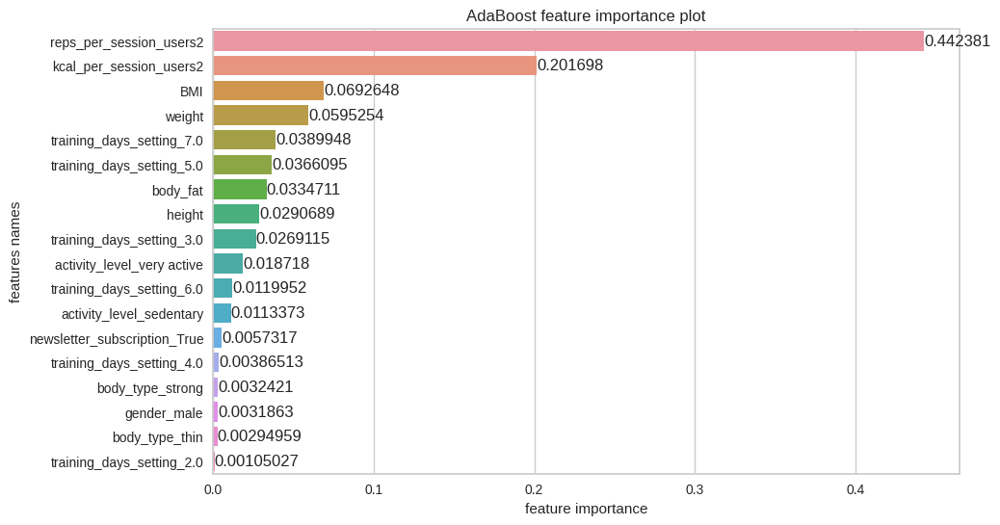

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.01, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.01655946575976749, 0.017667973868674823, 0.04811845220969774, 0.04548371711073786, 0.4416065152596016, 0.28487291401020876, 0.022002025686424936, 0.0690859667901613, 0.0, 0.0, 0.003934269663812674, 0.0, 0.0, 0.03161751076074016, 0.0086946794187572, 0.010356509461415494, 0.0, 0.0]


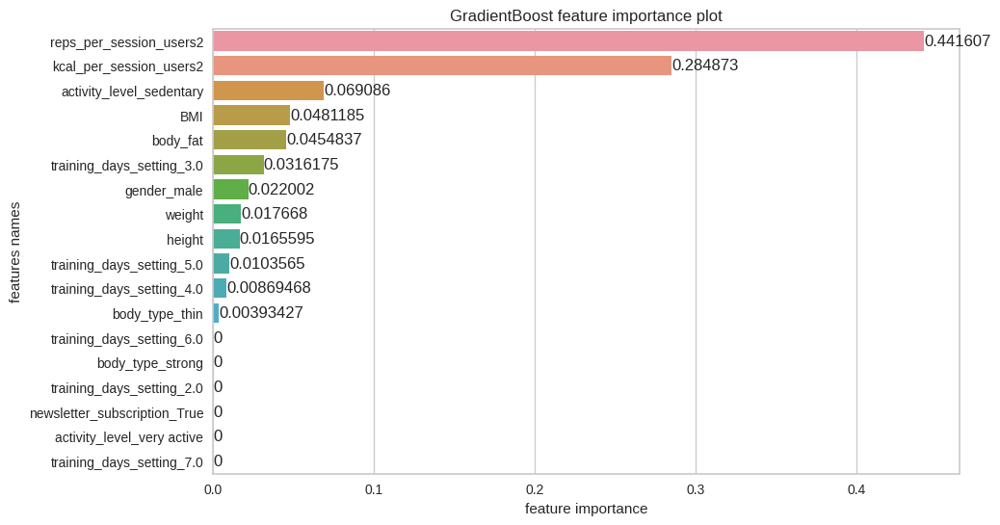

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 4, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [45]:
estimators_multiclass_u, X_test_u, y_test_u, X_train_u, y_train_u, X_train_inv_u, X_test_inv_u, features_u = train(X_users, 
                                                                                                   y_users, 
                                                         params, 
                                                         seed)

In [46]:
evaluation_table_u = evaluate_multiclass(estimators_multiclass_u, X_test_u, y_test_u, features_u)

In [47]:
evaluation_table_u

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.08,0.07,15.48,4.21,606.90,268.75
Linear Regression,0.09,0.07,15.46,4.20,606.09,268.62
Lasso,0.09,0.07,15.46,4.20,606.09,268.62
Ridge,0.09,0.07,15.46,4.20,606.00,268.61
Decision Tree,0.13,0.11,14.49,3.52,577.47,272.47
Random Forest,0.11,0.09,15.02,4.08,590.98,279.54
AdaBoost,0.16,0.14,14.07,3.41,558.70,267.26
GradientBoost,0.12,0.10,14.90,4.02,585.29,277.88


Here, the best regression model is AdaBoost. The $R^2$ score is 17%, which is very bad. MAE is 13.89, MAPE is 3.22. Max error is the lowest and it is 265.25.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

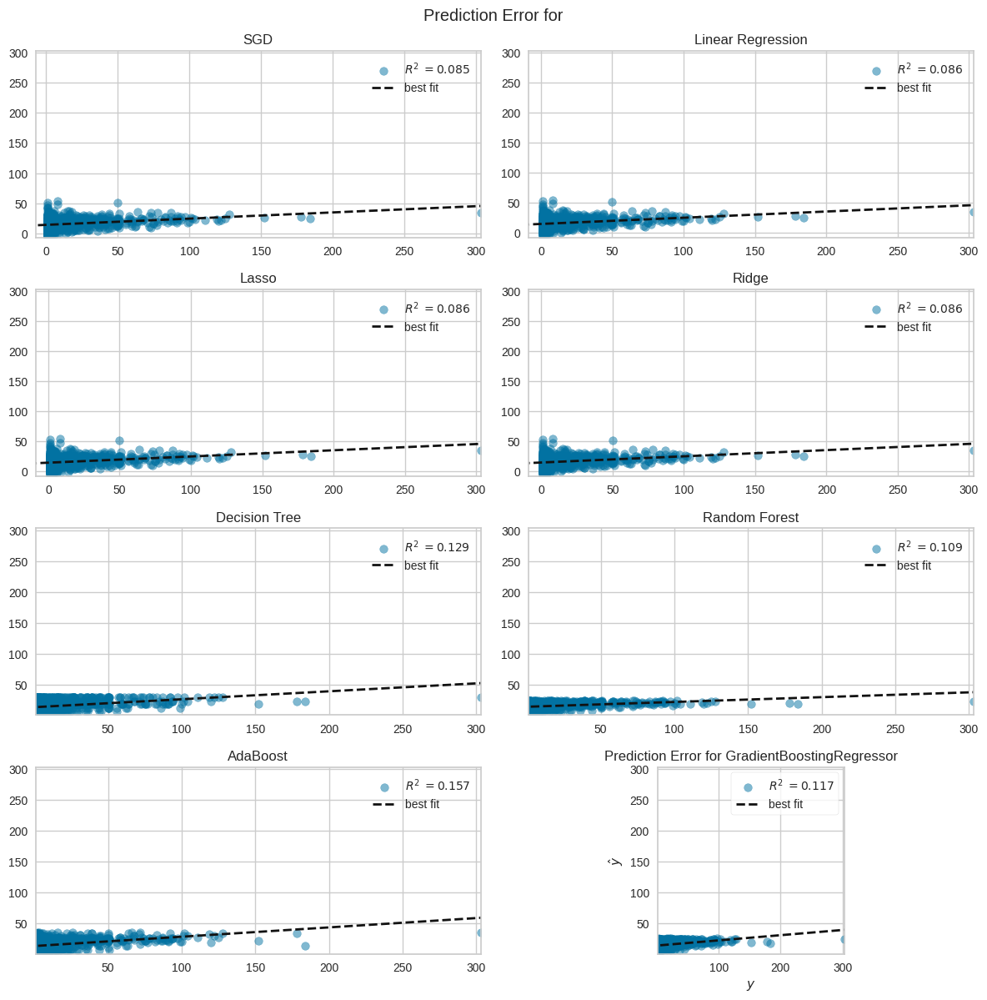

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [48]:
prediction_error_plot(estimators_multiclass_u, X_train_u, y_train_u, X_test_u, y_test_u,
                      features_u,
                      features_selected = False,
                      name = 'all')

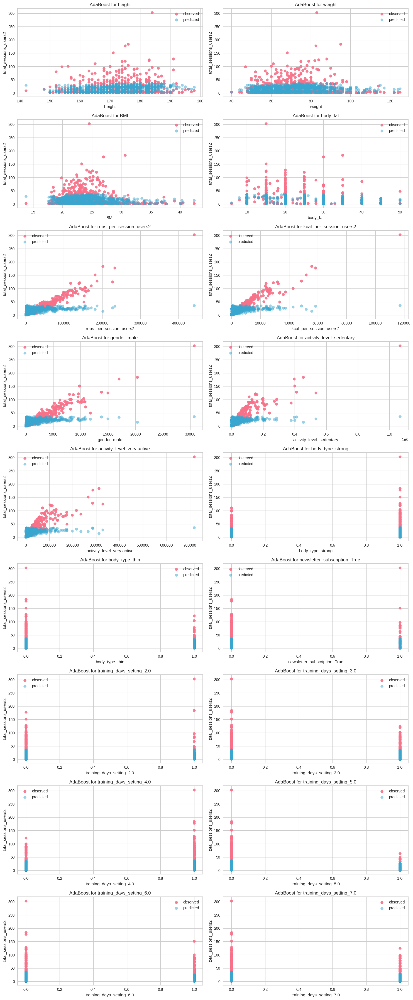

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [49]:
plots_regr(estimators_multiclass_u, X_users,y_users, X_train_u, y_train_u, X_test_u, y_test_u, X_train_inv, 
           X_test_inv,
           features_u,
           features_selected = False,
           name = 'AdaBoost')

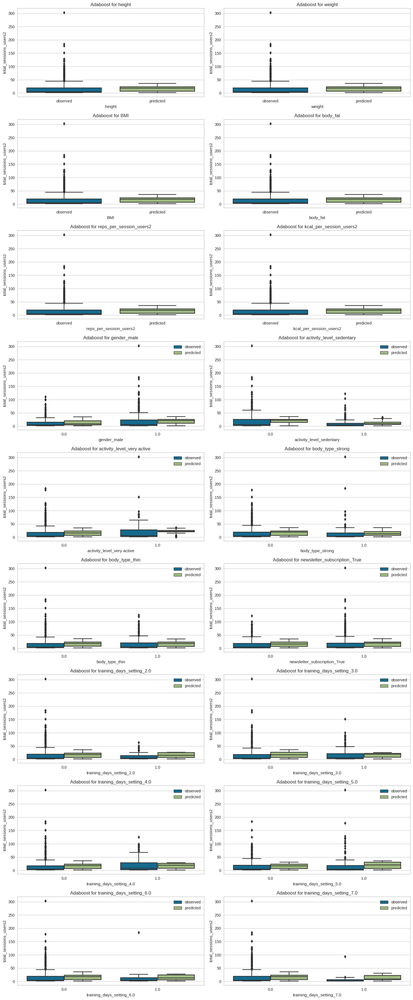

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [50]:
plots_box(estimators_multiclass_u, X_users, y_users, X_train_u, y_train_u, 
          X_test_u, y_test_u, features_u, X_train_inv_u, 
          X_test_inv_u, features_selected = False, name = 'AdaBoost')

## For users (number of sessions only with demographic data)

In [89]:
X_users2 = df_users_only.loc[:, ['gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 'cluster']]

for col in ['gender', 'activity_level', 'body_type', 'newsletter_subscription', 'cluster']:
    X_users2[col] = LabelEncoder().fit_transform(X_users2[col])

#cat_cols = ['gender', 'activity_level', 'body_type', 'newsletter_subscription', 'training_days_setting']
#X_users2 = pd.get_dummies(X_users2, columns = cat_cols, drop_first = True)


y_users2 = df_users_only['total_sessions_users2']

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [3.2966270608293176, -0.22755985905177314, -1.4552055140083593, 0.35644068692782804, 0.7935585525352074, -0.6822583788930731, -1.156532560959153, -3.022682796772057, 3.272998702595848, 0.15772663019998226]


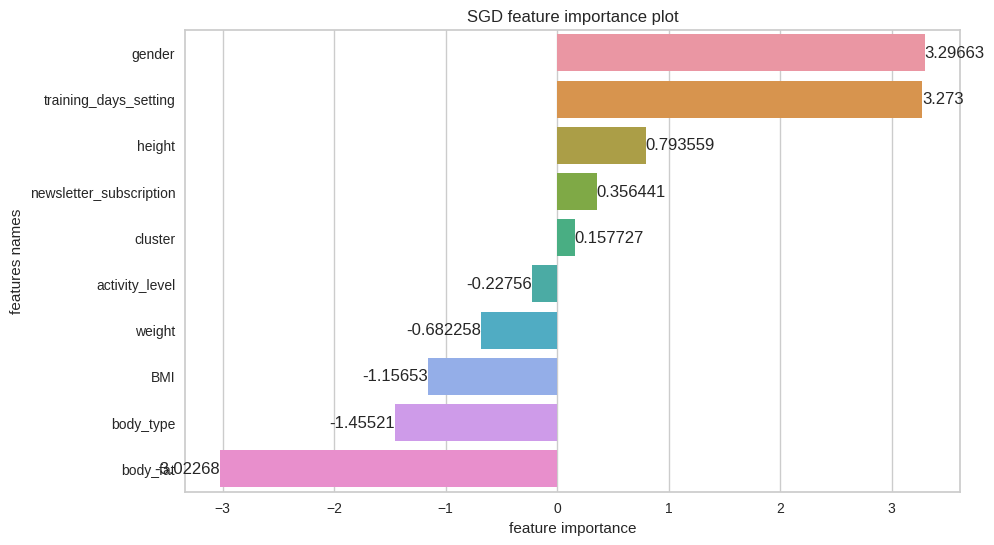

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'max_iter': 1000000, 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [3.676846023874171, -0.25377505880266193, -1.4825282944148344, 0.3750957149910198, 4.0265218852241915, -7.417284112141842, 4.229132638630402, -3.1579115246012273, 3.318869537500276, 0.17255775336303855]


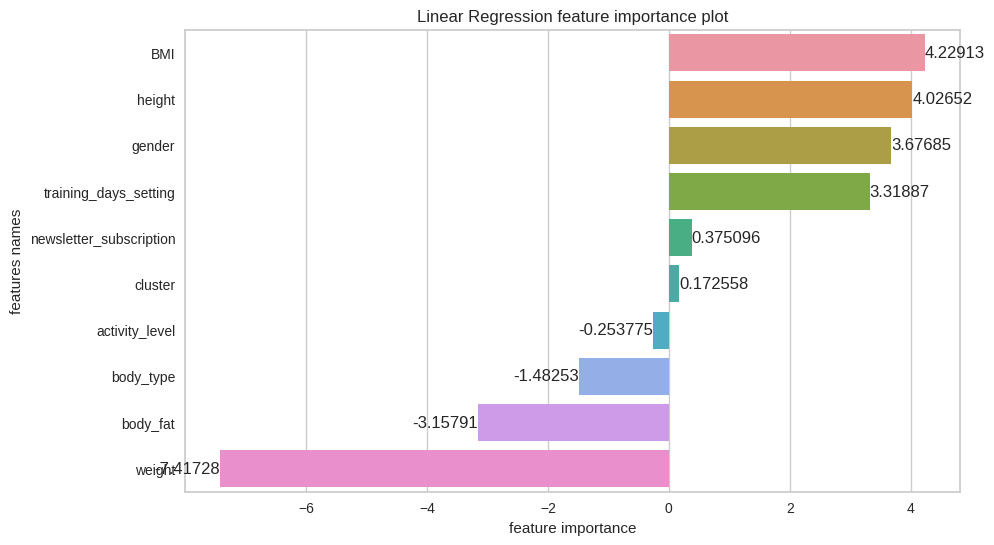

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [3.4284020603387777, -0.0, -1.1181588485654756, 0.038875252375217065, 0.0, -0.0, -1.170461250224796, -3.0721743920233022, 3.0376414317832747, -0.0]


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.750e+04, tolerance: 1.040e+02
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.101e+05, tolerance: 9.285e+01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

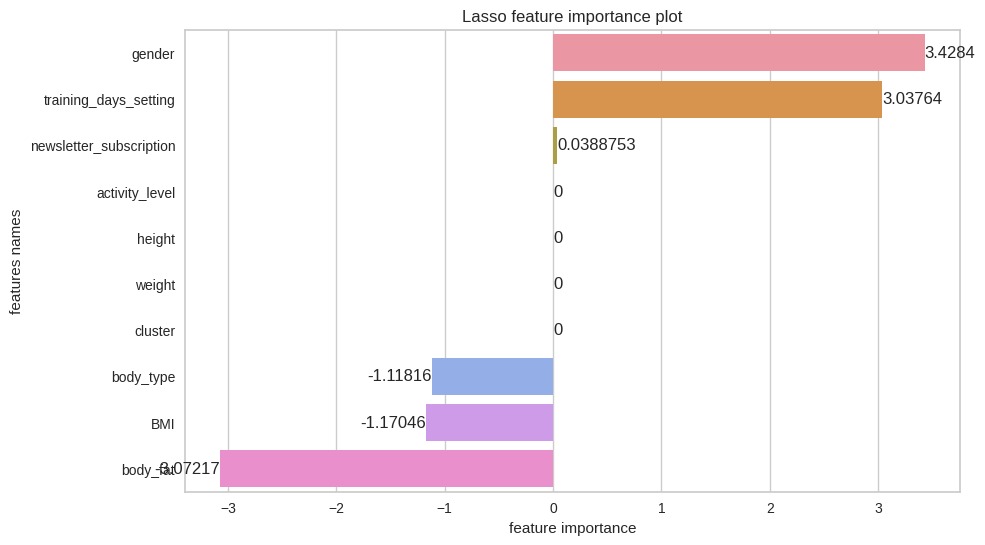

[Lasso] Best parameters are {'alpha': 0.28572285714285717, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [3.6806880918327955, -0.2504213025794362, -1.4853563584603713, 0.37868741544956114, 3.2668836389279985, -6.018270860716203, 3.1336229761953085, -3.1631237614254615, 3.316308982832889, 0.1823143976633123]


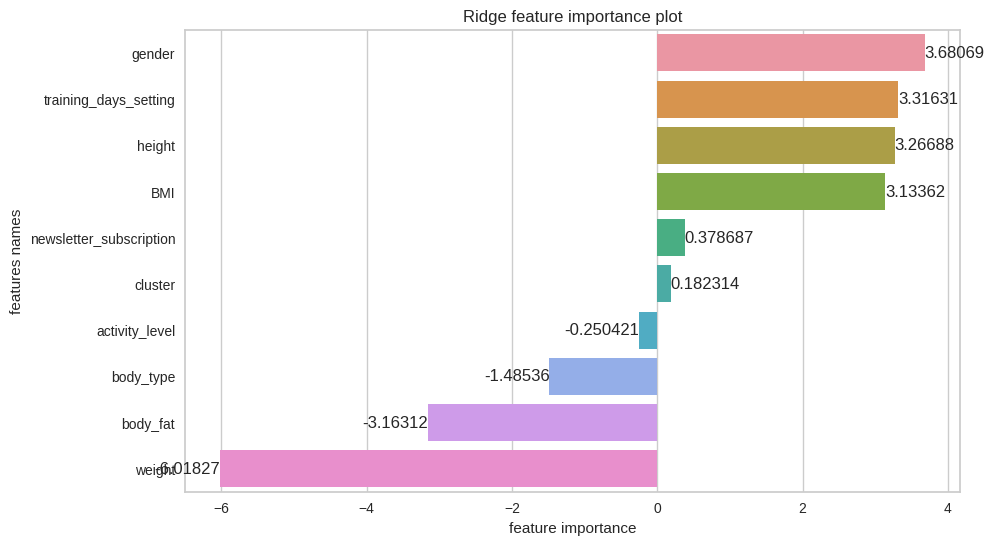

[Ridge] Best parameters are {'alpha': 2.0, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.3087743070654465, 0.04602888948642218, 0.0, 0.0, 0.0, 0.0, 0.09112641309453227, 0.2234916610303936, 0.3305787293232053, 0.0]


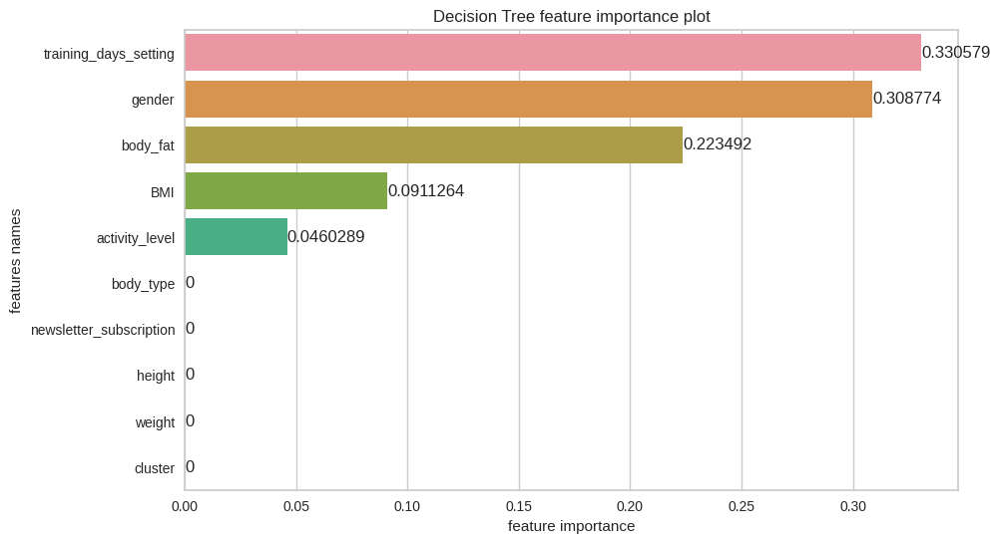

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.26, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.2103292761363682, 0.028364059387439026, 0.02309711584038446, 0.0, 0.1262365858136463, 0.060526312637574596, 0.12908995277474986, 0.195412146033841, 0.21032575686216096, 0.016618794513835466]


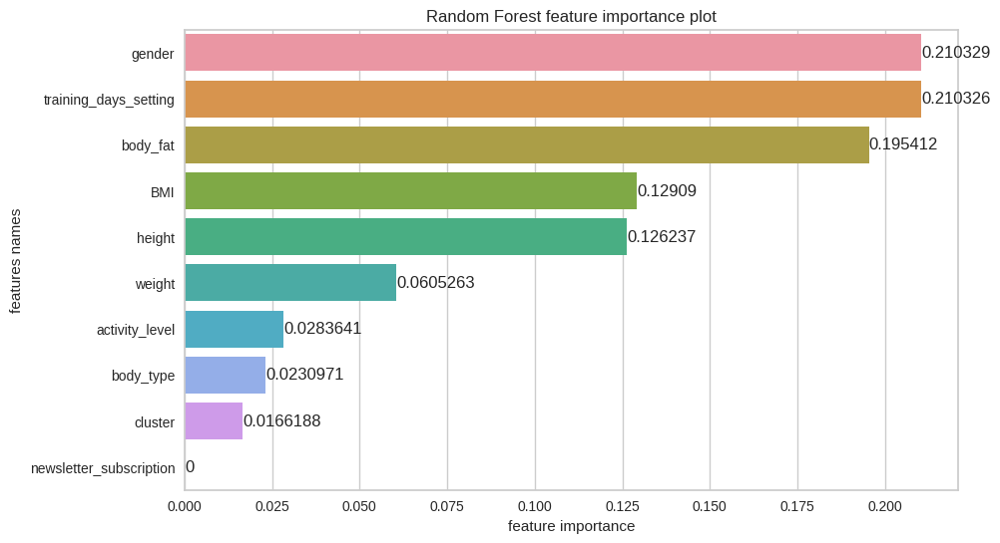

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.08086448437814607, 0.09394439158526928, 0.011909653098493308, 0.024190670380256175, 0.08837488401612006, 0.083109578099818, 0.24927976662056936, 0.1169638856449732, 0.20120415634776856, 0.05015852982858605]


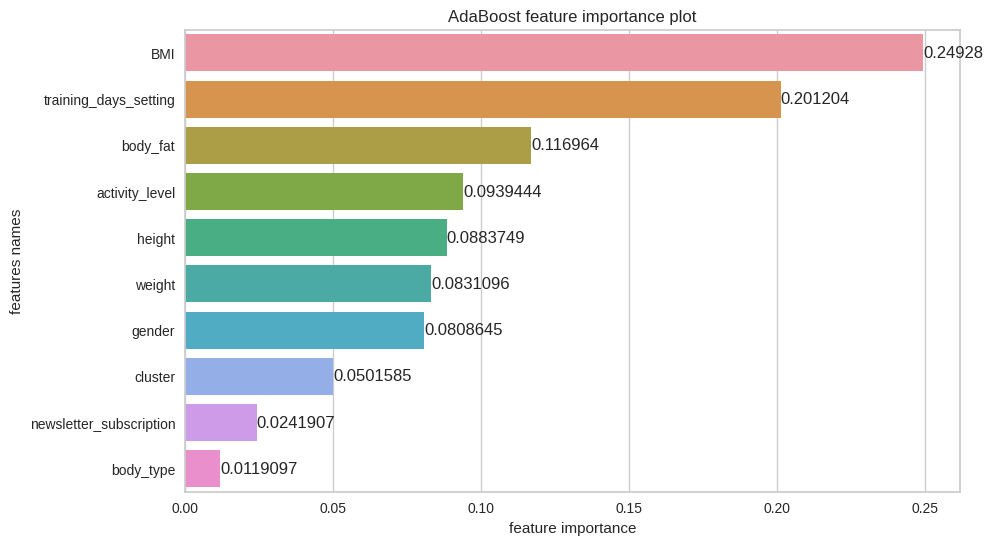

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.05, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.22129983842690218, 0.053327065943670295, 0.043013564321607654, 0.0006224724207219547, 0.05297640878858158, 0.10441766055562605, 0.12769911211876875, 0.14204804450896702, 0.24201040927709538, 0.012585423638059203]


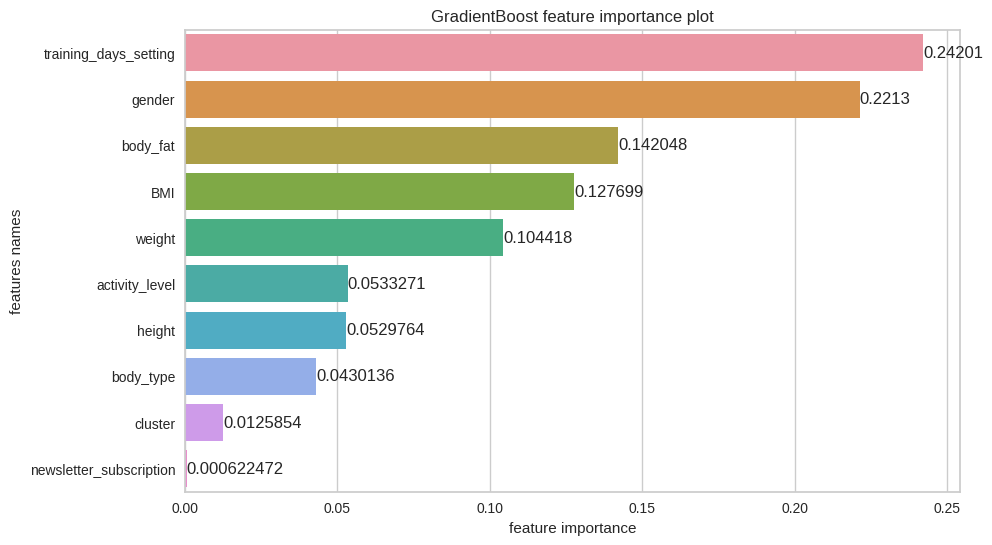

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 4, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [90]:
estimators_multiclass_u2, X_test_u2, y_test_u2, X_train_u2, y_train_u2, X_train_inv2, X_test_inv2, features_u2 = train(X_users2, 
                                                                                                   y_users2, 
                                                         params, 
                                                         seed)

In [91]:
evaluation_table_u2 = evaluate_multiclass(estimators_multiclass_u2, X_test_u2, y_test_u2, features_u2)


In [92]:
evaluation_table_u2

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.05,0.04,15.99,4.52,631.78,278.03
Linear Regression,0.05,0.04,16.09,4.61,632.19,277.94
Lasso,0.05,0.04,16.06,4.61,631.56,278.33
Ridge,0.05,0.04,16.09,4.61,631.98,277.89
Decision Tree,0.05,0.04,16.04,4.63,630.80,273.26
Random Forest,0.04,0.03,16.04,4.60,633.46,281.91
AdaBoost,0.07,0.06,15.79,4.48,615.44,267.50
GradientBoost,0.05,0.04,15.93,4.59,628.03,282.88


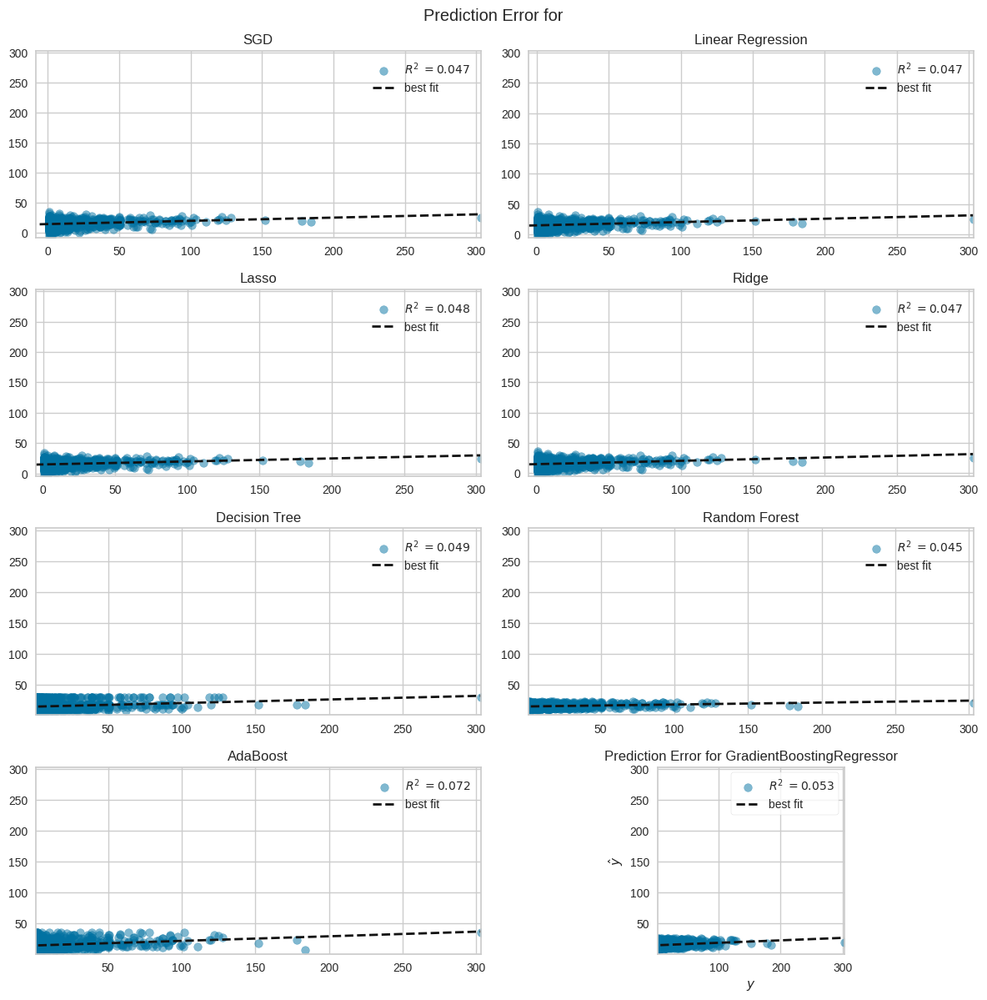

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [93]:
prediction_error_plot(estimators_multiclass_u2, X_train_u2, y_train_u2, X_test_u2, y_test_u2,
                      features_u2,
                      features_selected = False,
                      name = 'all')

In [94]:
prediction_for_one_user(estimators_multiclass_u2, X_test_u2, y_test_u2, X_test_inv2, X_users2.columns, ['total_sessions_users2'], features_u2, name = 'AdaBoost')


,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,cluster,total_sessions_users2,total_sessions_users2_prediction
704,1.00,0.00,2.00,1.00,168.00,64.00,22.68,10.00,5.00,5.00,50.00,32.13


In [95]:
df_users_only.iloc[704, :]

id_users                                              2196.00
created_at_users                   2021-10-25 11:04:20.165338
updated_at_users                   2022-06-22 12:17:20.720069
gender                                                 female
date_of_birth                             1979-11-24 00:00:00
height                                                 163.00
weight                                                  70.90
activity_level                                         active
goal                                                     lose
body_type                                                thin
body_fat                                                30.00
newsletter_subscription                                  True
notifications_setting                                    True
training_days_setting                                    3.00
language                                                   es
points                                               18404.00
scientif

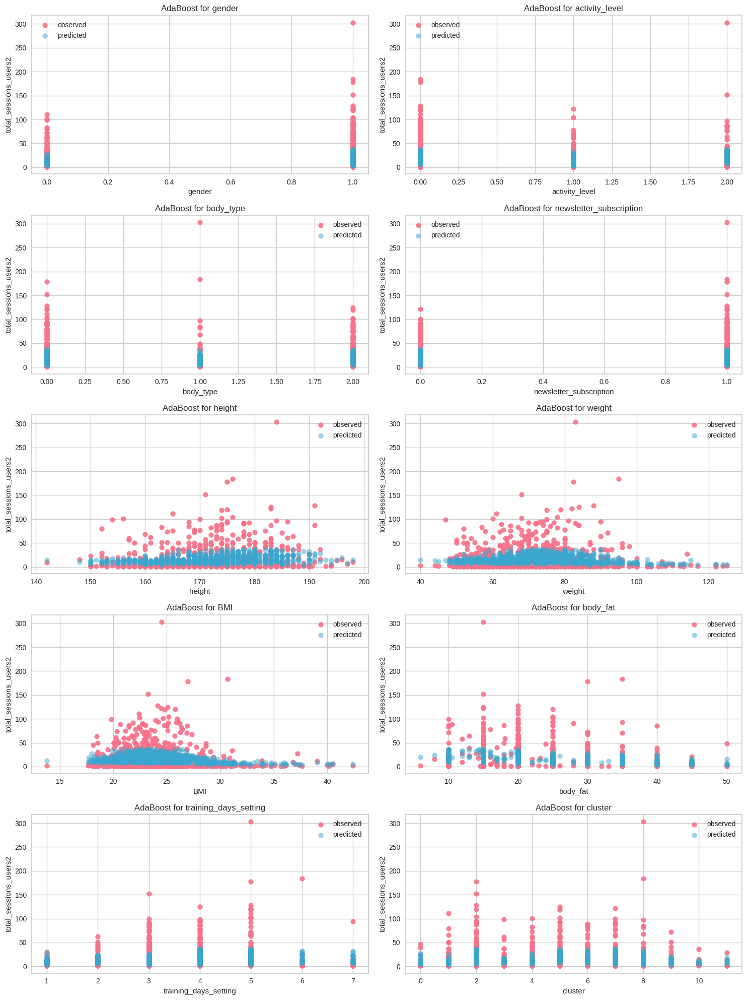

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [26]:
plots_regr(estimators_multiclass_u2, X_users2,y_users2, X_train_u2, y_train_u2, 
           X_test_u2, y_test_u2, X_train_inv2, 
           X_test_inv2,
           features_u2,
           features_selected = False,
           name = 'AdaBoost')

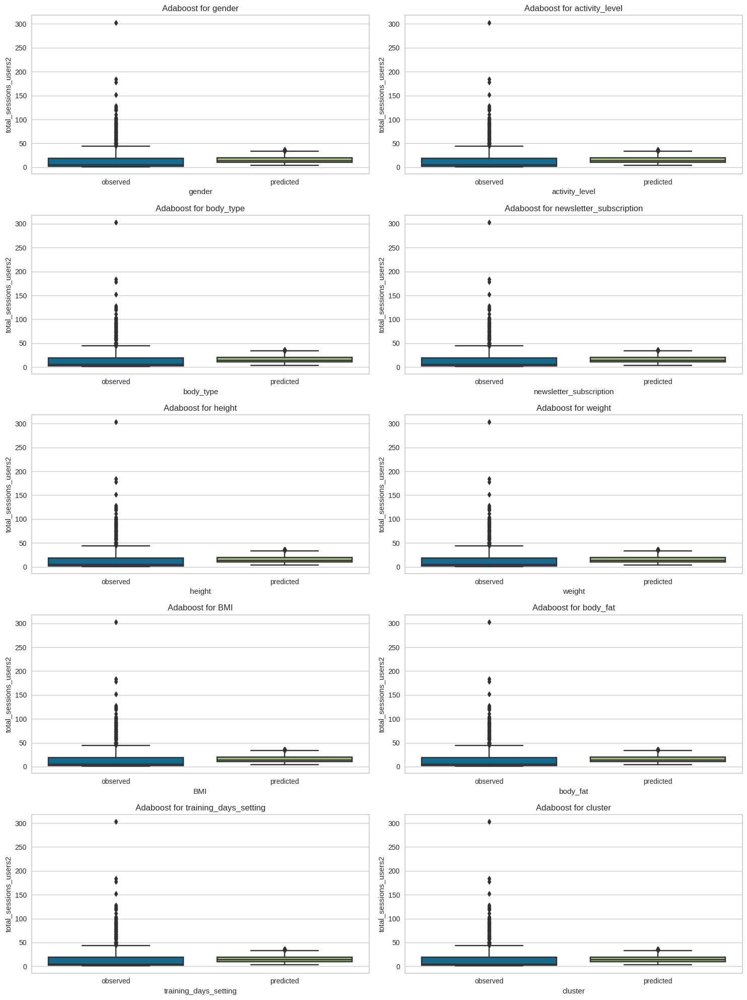

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [27]:
plots_box(estimators_multiclass_u2, X_users2, y_users2, X_train_u2, y_train_u2, 
          X_test_u2, y_test_u2, features_u2, X_train_inv2, 
          X_test_inv2, features_selected = False, name = 'AdaBoost')

### SFS Feature selection

In [68]:
estimators_multiclass_u_sel2, X_test_u_sel2, y_test_u_sel2, X_train_u_sel2, y_train_u_sel2, X_train_inv_u_sel2, X_test_inv_u_sel2, features_u_sel2 = train(X_users2, 
                                                                                                   y_users2,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFS')

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['gender', 'body_type', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting'],
      dtype='object')
[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['gender', 'body_type', 'BMI', 'body_fat', 'training_days_setting'], dtype='object')
[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['gender', 'newsletter_subscription', 'weight', 'BMI', 'body_fat',
       'training_days_setting'],
      dtype='object')
[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features selected: Index(['gender', 'bod

In [69]:
evaluation_table_u_sel2 = evaluate_multiclass(estimators_multiclass_u_sel2, X_test_u_sel2, y_test_u_sel2,
                                              features_u_sel2, features_selected = True)

In [70]:
evaluation_table_u_sel2

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.04,0.04,16.13,4.63,633.35,277.82
Linear Regression,0.05,0.04,16.12,4.62,632.85,277.69
Lasso,0.05,0.04,16.08,4.63,630.84,277.50
Ridge,0.04,0.04,16.12,4.62,633.37,277.87
Decision Tree,0.03,0.03,16.32,4.66,642.46,279.31
Random Forest,0.04,0.03,16.19,4.64,638.93,284.09
AdaBoost,0.04,0.04,16.26,4.69,635.42,275.44
GradientBoost,0.04,0.03,16.25,4.68,639.63,283.36


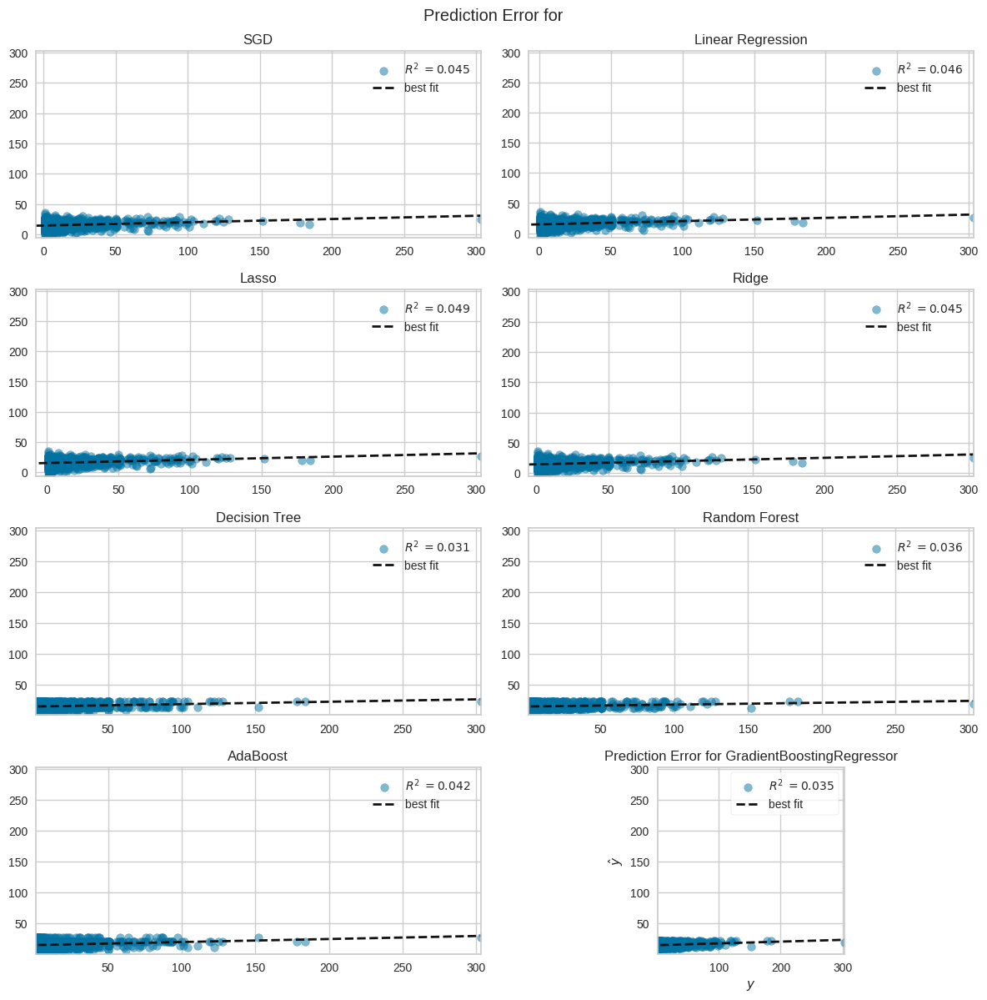

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [71]:
prediction_error_plot(estimators_multiclass_u_sel2, X_train_u_sel2, y_train_u_sel2, X_test_u_sel2, 
                      y_test_u_sel2, features_u_sel2, features_selected = True, name = 'all')

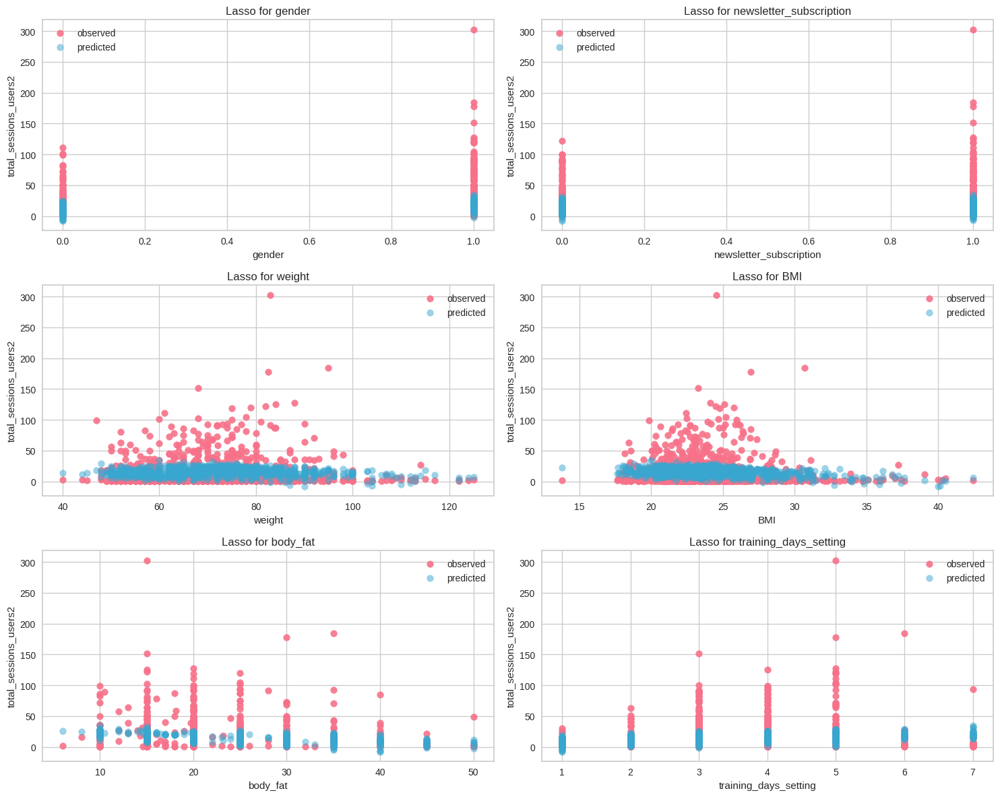

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [32]:
plots_regr(estimators_multiclass_u_sel2, X_users2, y_users2, X_train_u_sel2, y_train_u_sel2, 
           X_test_u_sel2, y_test_u_sel2, X_train_inv_u_sel2, 
           X_test_inv_u_sel2, features_u_sel2, features_selected = True, name = 'Lasso')

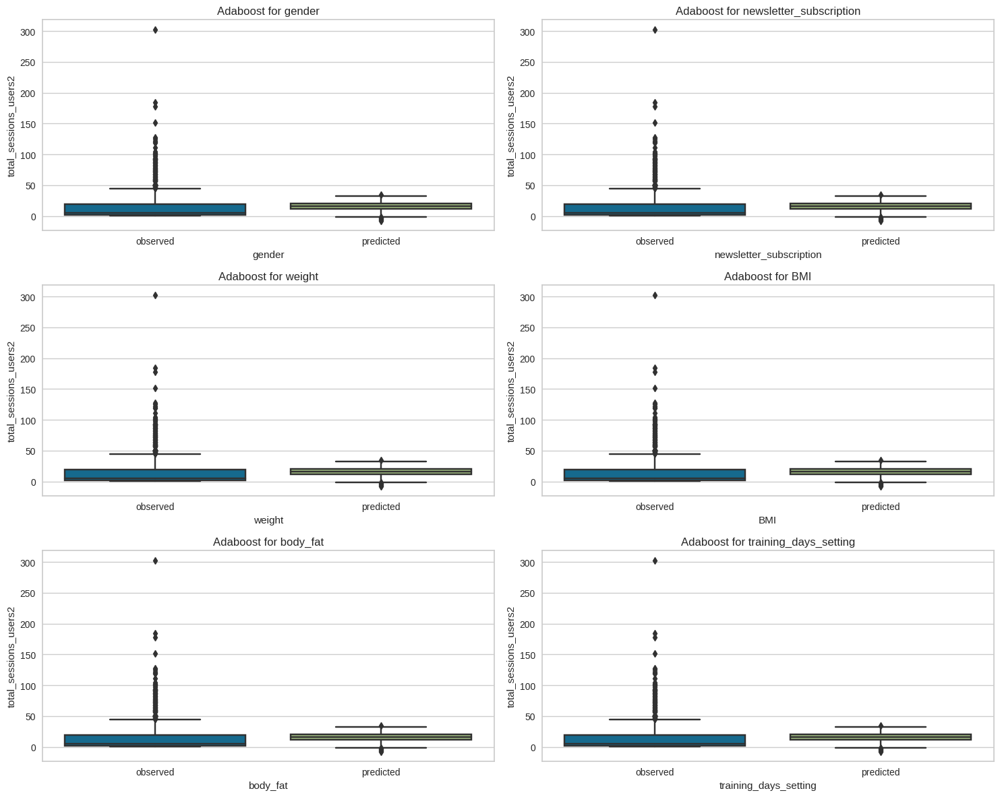

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [33]:
plots_box(estimators_multiclass_u_sel2, X_users2, y_users2, X_train_u_sel2, 
          y_train_u_sel2, X_test_u_sel2, y_test_u_sel2, features_u_sel2, X_train_inv_u_sel2, 
          X_test_inv_u_sel2, features_selected = True, name = 'Lasso')

### RFECV Feature Selection

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['gender', 'body_type', 'height', 'weight', 'body_fat',
       'training_days_setting'],
      dtype='object')
[SGD] Features importances: [3.318116227022284, -1.4043603530925906, 1.18306109854797, -1.6482492015694428, -3.342359597630474, 3.2827034245533557]


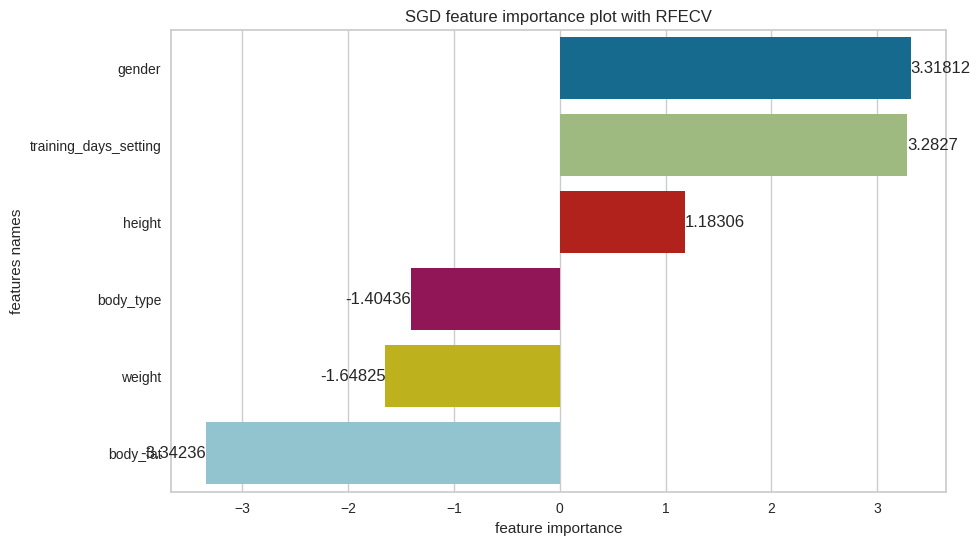

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'max_iter': 1000000, 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['gender', 'body_type', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting'],
      dtype='object')
[Linear Regression] Features importances: [3.6841967290913926, -1.4728331949449622, 4.057864627207712, -7.470155301586196, 4.265506382837007, -3.136979394303154, 3.34080476680039]


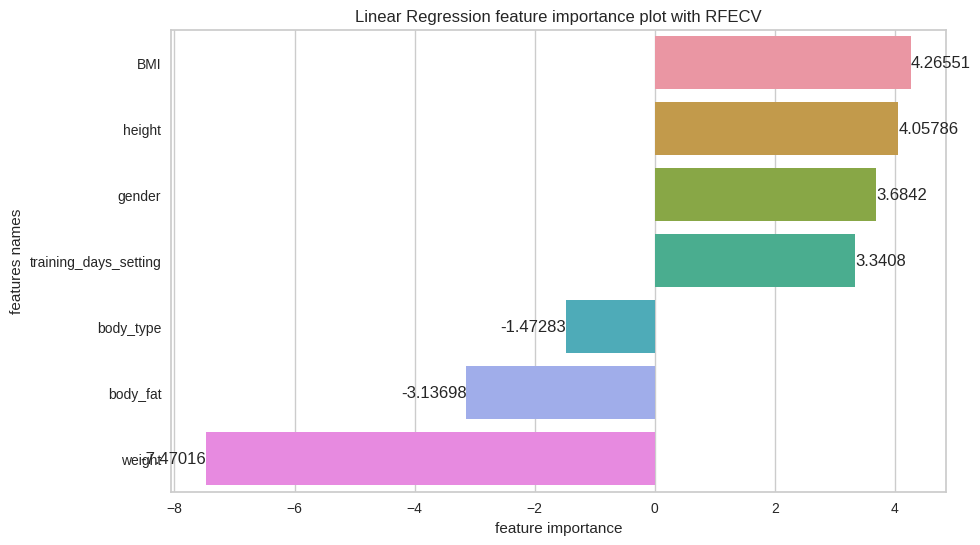

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['gender', 'body_fat', 'training_days_setting'], dtype='object')
[Lasso] Features importances: [3.6955454054174277, -3.978281601186508, 3.2815766798942763]


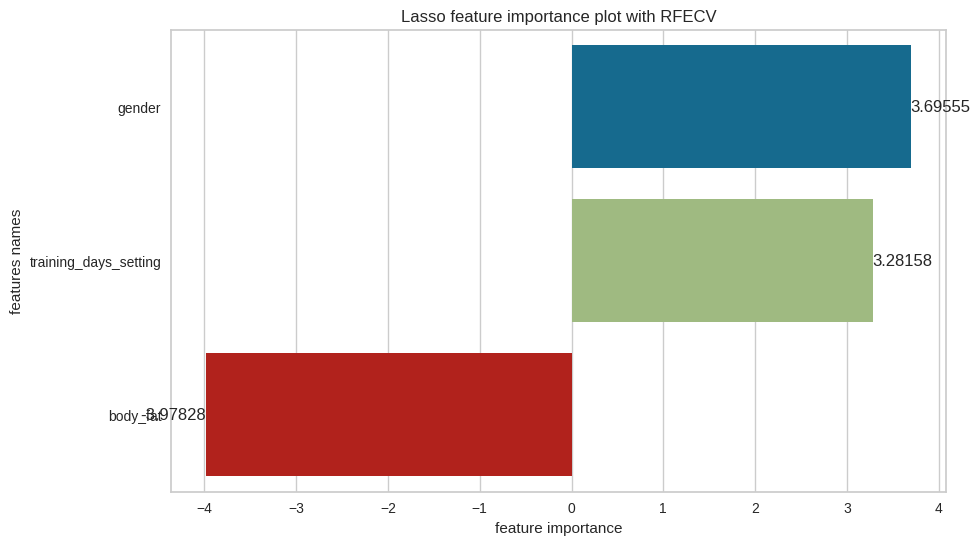

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features selected: Index(['gender', 'body_type', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting'],
      dtype='object')
[Ridge] Features importances: [3.6897253492416584, -1.4728433090775737, 3.2955960545515897, -6.067155291649413, 3.168141880754944, -3.141826219504483, 3.3382461061122624]


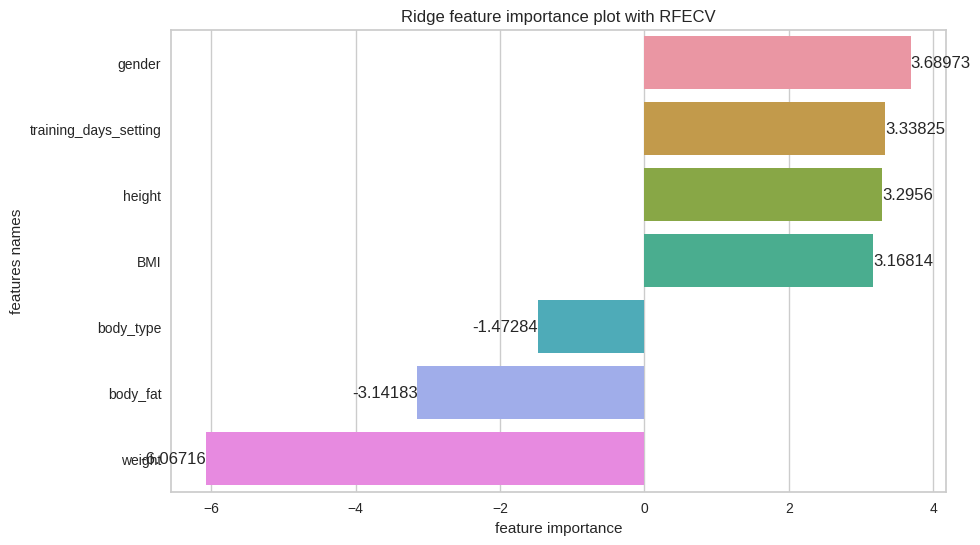

[Ridge] Best parameters are {'alpha': 2.0, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'BMI'], dtype='object')
[Decision Tree] Features importances: [0.41868280648005735, 0.5813171935199427]


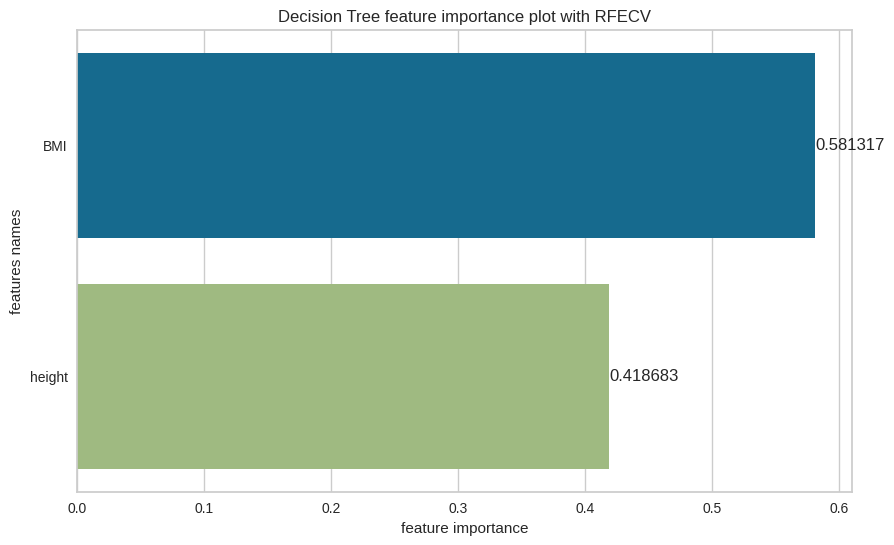

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 3, 'min_samples_leaf': 0.18, 'min_samples_split': 0.42000000000000004, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['gender', 'activity_level', 'body_type', 'newsletter_subscription',
       'height', 'weight', 'BMI', 'body_fat', 'training_days_setting',
       'cluster'],
      dtype='object')
[Random Forest] Features importances: [0.2103292761363682, 0.028364059387439026, 0.02309711584038446, 0.0, 0.1262365858136463, 0.060526312637574596, 0.12908995277474986, 0.195412146033841, 0.21032575686216096, 0.016618794513835466]


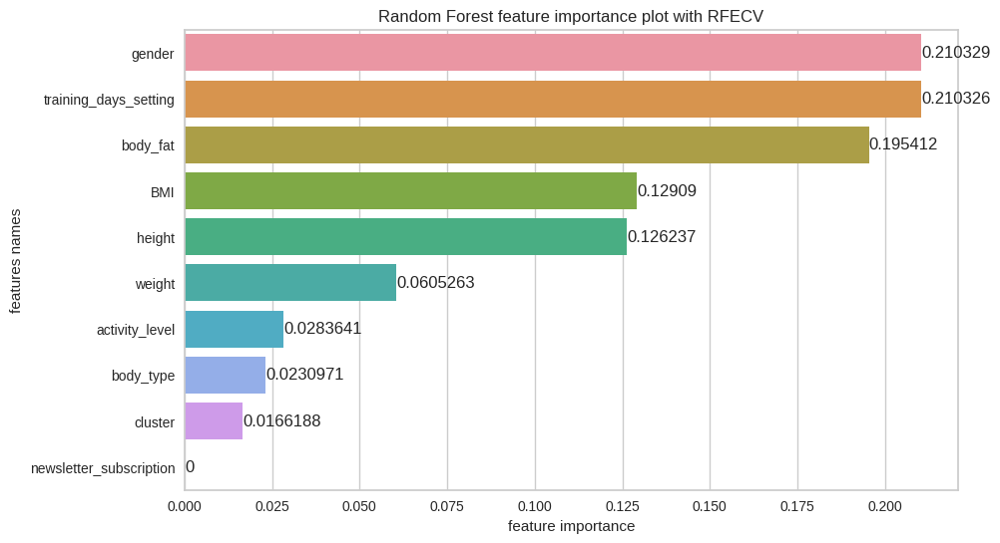

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['BMI', 'training_days_setting'], dtype='object')
[AdaBoost] Features importances: [0.6684878977835731, 0.33151210221642674]


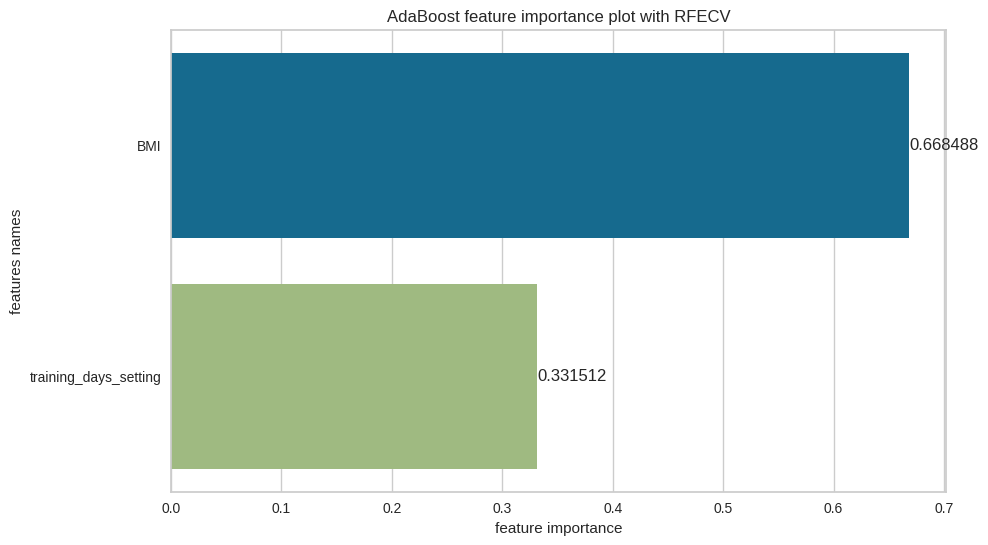

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=3), 'learning_rate': 0.01, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['gender', 'activity_level', 'height', 'weight', 'BMI', 'body_fat',
       'training_days_setting'],
      dtype='object')
[GradientBoost] Features importances: [0.2194136540374092, 0.08685895561983836, 0.08152913846021696, 0.07661056806295279, 0.15992794408847988, 0.15842214830707038, 0.21723759142403246]


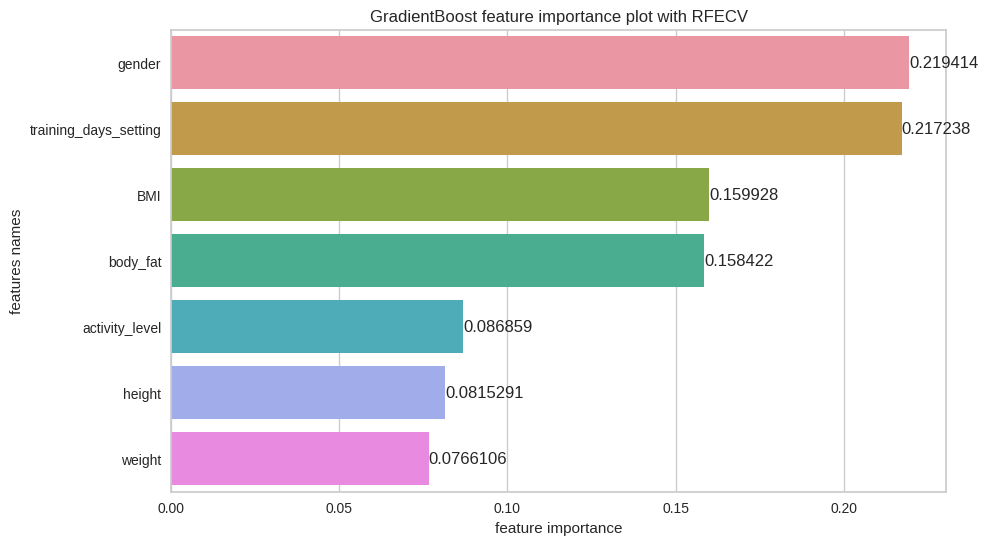

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [64]:
estimators_multiclass_u_sel_rfecv2, X_test_u_sel_rfecv2, y_test_u_sel_rfecv2, X_train_u_sel_rfecv2, y_train_u_sel_rfecv2, X_train_inv_u_sel_rfecv2, X_test_inv_u_sel_rfecv2, features_u_sel_rfecv2 = train(X_users2, 
                                                                                                   y_users2,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'RFECV')

In [65]:
evaluation_table_u_sel_rfecv2 = evaluate_multiclass(estimators_multiclass_u_sel_rfecv2, X_test_u_sel_rfecv2, 
                                                    y_test_u_sel_rfecv2, features_u_sel_rfecv2, 
                                                    features_selected = True)

In [66]:
evaluation_table_u_sel_rfecv2

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.05,0.04,16.00,4.52,632.65,277.83
Linear Regression,0.04,0.04,16.12,4.62,633.57,277.89
Lasso,0.05,0.05,16.08,4.63,630.49,276.81
Ridge,0.04,0.04,16.12,4.62,633.37,277.87
Decision Tree,0.02,0.02,16.25,4.66,651.47,285.25
Random Forest,0.04,0.03,16.04,4.60,633.46,281.91
AdaBoost,0.03,0.03,16.36,4.73,641.10,279.45
GradientBoost,0.05,0.04,15.99,4.59,629.61,281.77


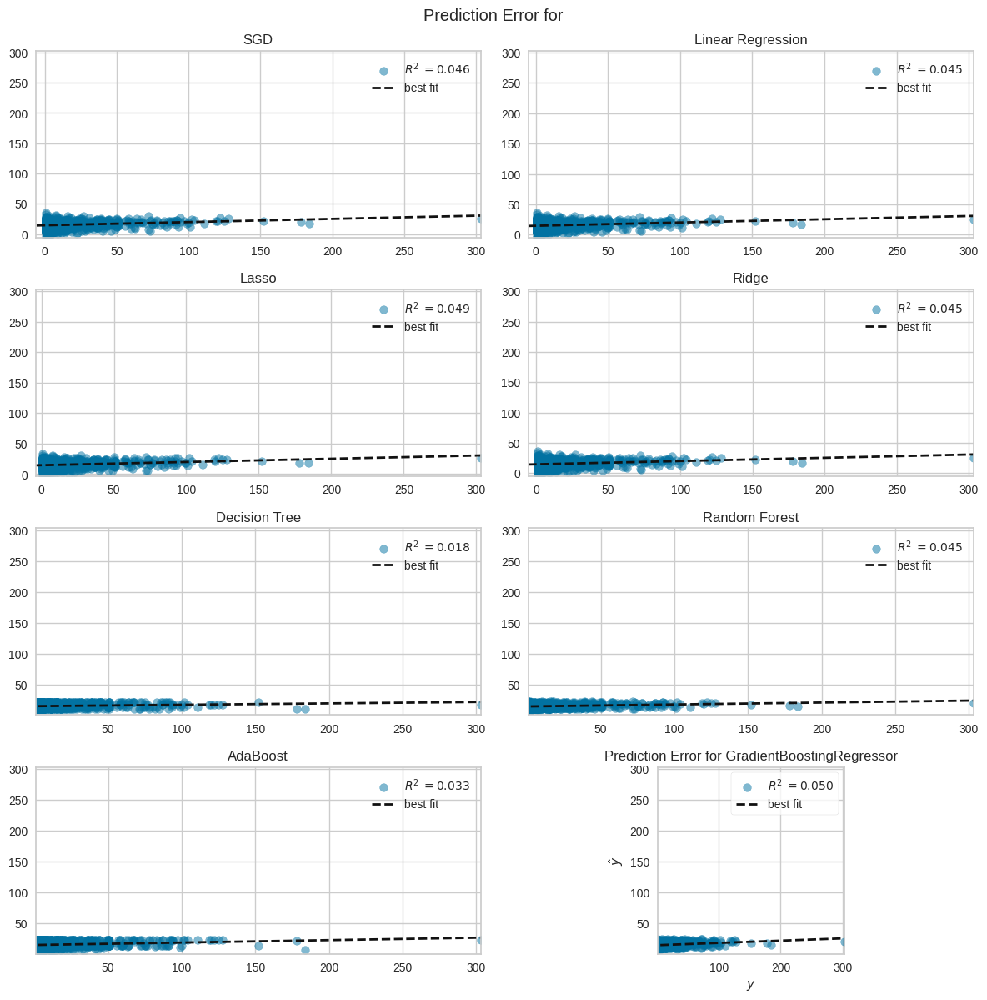

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [67]:
prediction_error_plot(estimators_multiclass_u_sel_rfecv2, X_train_u_sel_rfecv2, y_train_u_sel_rfecv2, 
                      X_test_u_sel_rfecv2, y_test_u_sel_rfecv2, features_u_sel_rfecv2, 
                      features_selected = True, name = 'all')

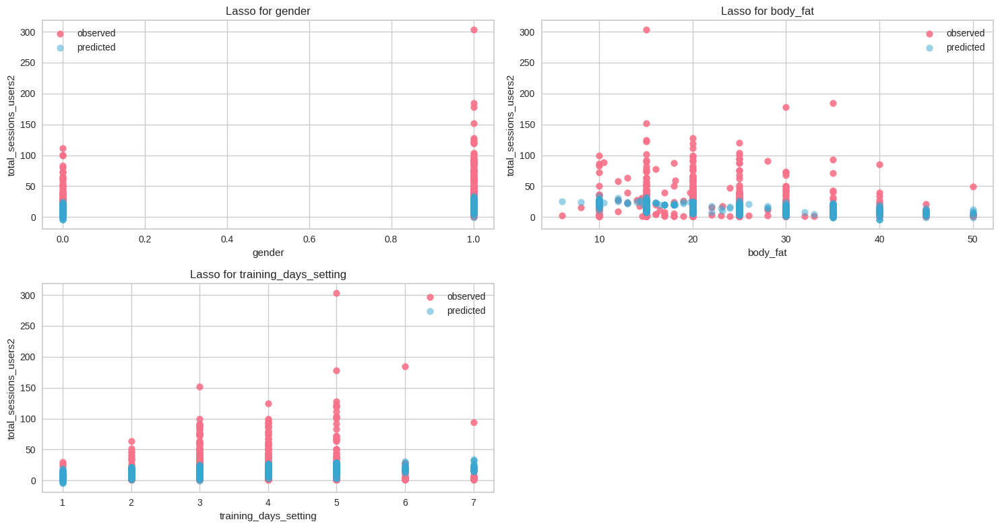

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [38]:
plots_regr(estimators_multiclass_u_sel_rfecv2, X_users2, y_users2, X_train_u_sel_rfecv2, y_train_u_sel_rfecv2, 
           X_test_u_sel_rfecv2, y_test_u_sel_rfecv2, X_train_inv_u_sel_rfecv2, 
           X_test_inv_u_sel_rfecv2, features_u_sel_rfecv2, features_selected = True, name = 'Lasso')

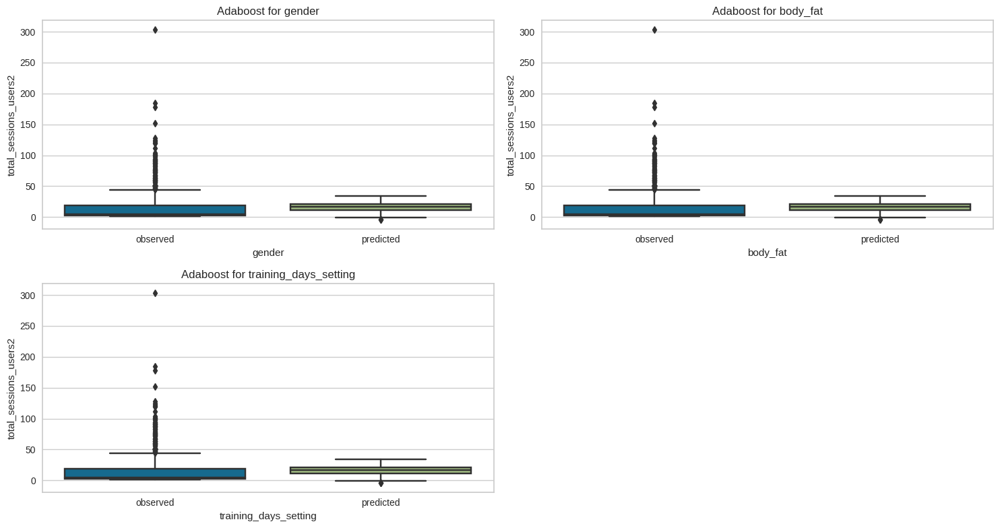

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [39]:
plots_box(estimators_multiclass_u_sel_rfecv2, X_users2, y_users2, X_train_u_sel_rfecv2, y_train_u_sel_rfecv2, 
          X_test_u_sel_rfecv2, y_test_u_sel_rfecv2, features_u_sel_rfecv2, X_train_inv_u_sel_rfecv2, 
          X_test_inv_u_sel_rfecv2, features_selected = True, name = 'Lasso')

### SFM Feature Selection

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features selected: Index(['gender', 'body_type', 'weight', 'body_fat', 'training_days_setting'], dtype='object')
[SGD] Features importances: [3.850500332100248, -1.3382761127929101, -1.056552418676395, -3.6176805243569157, 3.2542395848438463]


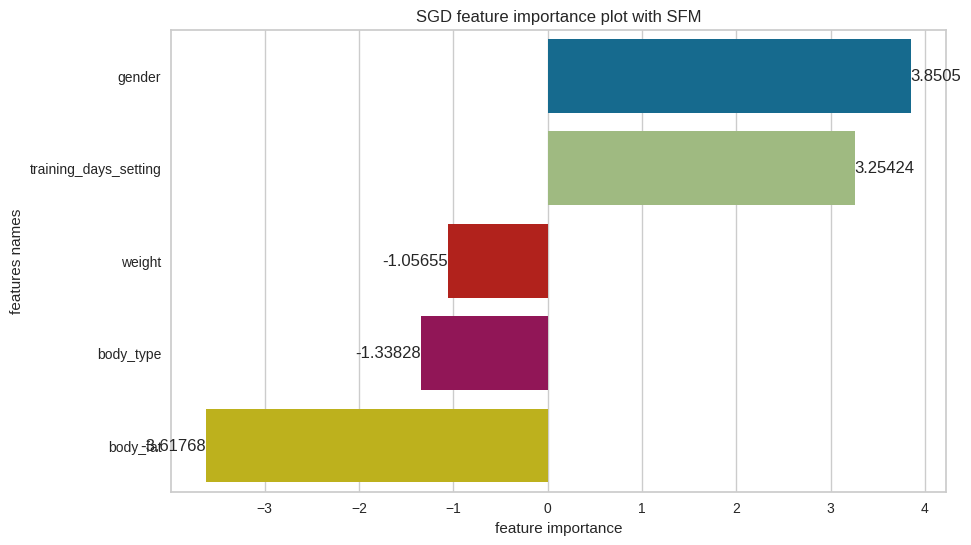

[SGD] Best parameters are {'alpha': 0.0007525, 'eta0': 0.0001, 'learning_rate': 'invscaling', 'max_iter': 1000000, 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features selected: Index(['gender', 'height', 'weight', 'BMI', 'training_days_setting'], dtype='object')
[Linear Regression] Features importances: [4.149002611593367, 5.377362806322981, -9.881044551349275, 4.3790803859739995, 3.237332011530822]


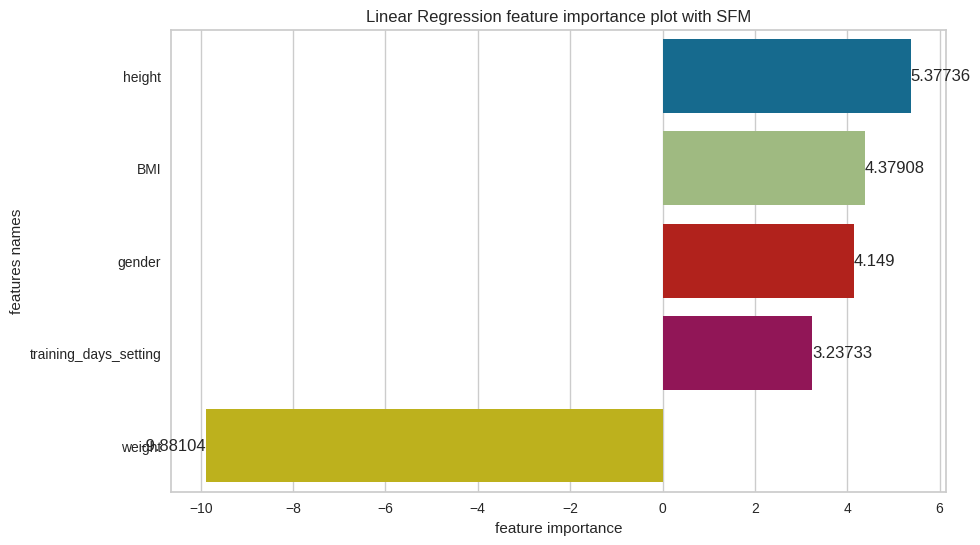

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features selected: Index(['gender', 'body_type', 'BMI', 'body_fat', 'training_days_setting'], dtype='object')
[Lasso] Features importances: [3.72385559700145, -1.4753653565794782, -1.5353582447629965, -3.208702025605544, 3.3432259144380096]


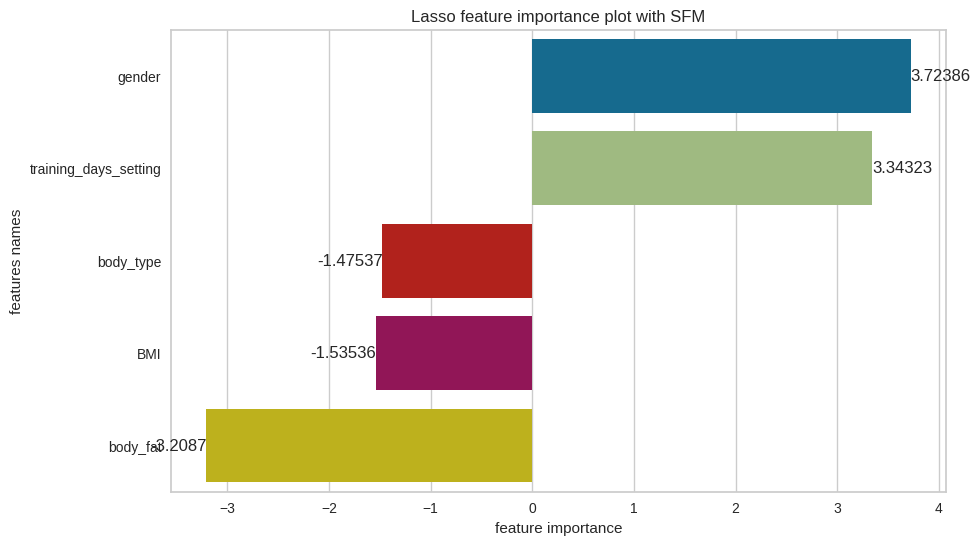

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features selected: Index(['gender', 'height', 'weight', 'BMI', 'training_days_setting'], dtype='object')
[Ridge] Features importances: [4.157364959284271, 4.427710231125831, -8.134990732473394, 3.0100793803351564, 3.2347943034954802]


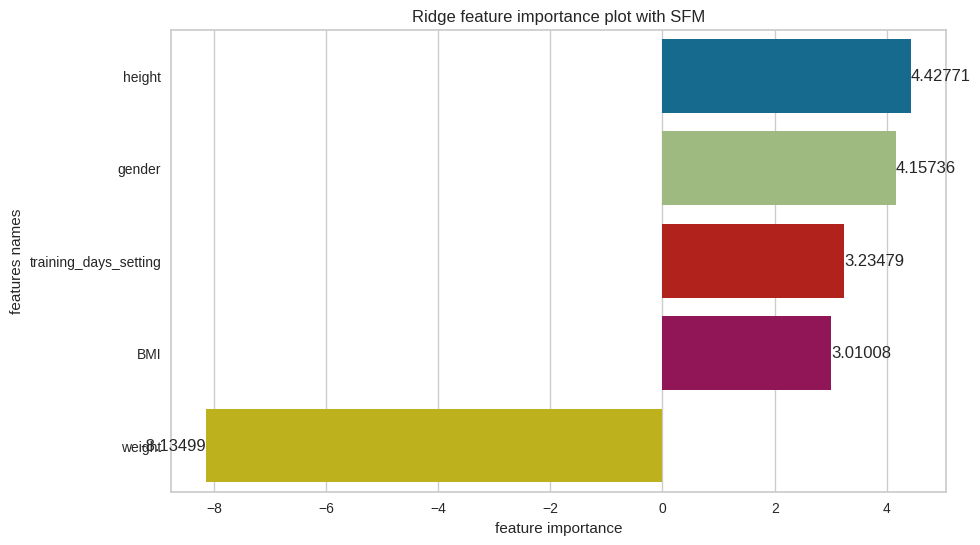

[Ridge] Best parameters are {'alpha': 2.0, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'training_days_setting'], dtype='object')
[Decision Tree] Features importances: [0.29557671042956496, 0.00943519042893436, 0.05696051253587654, 0.3394696810096932, 0.2985579055959308]


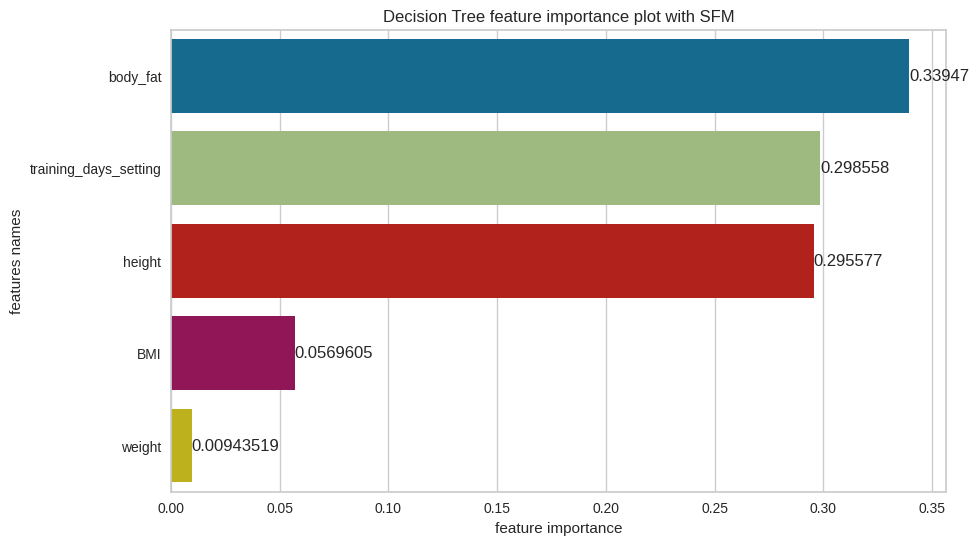

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features selected: Index(['height', 'weight', 'BMI', 'body_fat', 'training_days_setting'], dtype='object')
[Random Forest] Features importances: [0.19870593186152324, 0.09394461059522399, 0.17085719761248075, 0.25012850501884154, 0.2863637549119304]


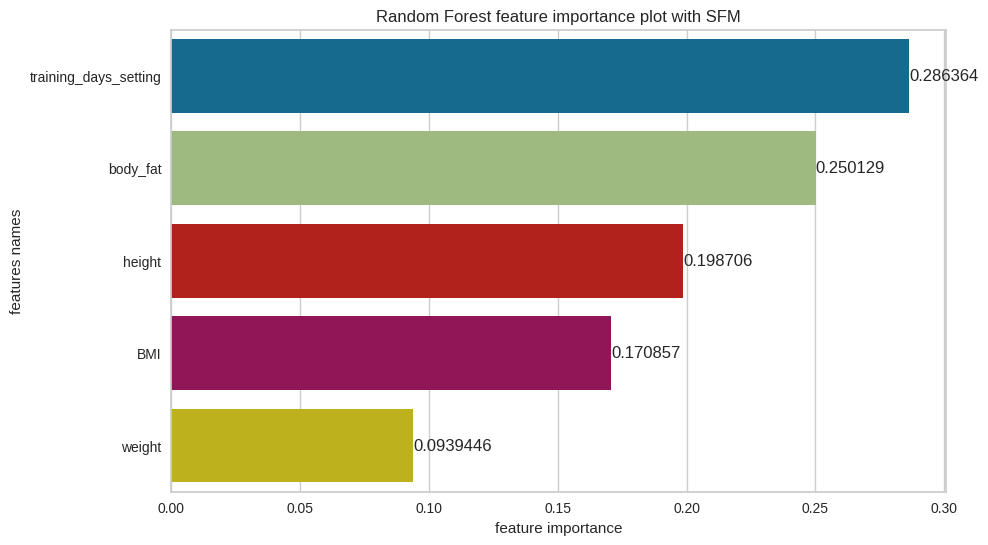

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features selected: Index(['height', 'weight', 'BMI', 'training_days_setting', 'cluster'], dtype='object')
[AdaBoost] Features importances: [0.208753183727936, 0.13207822907783787, 0.34494752861076355, 0.22744129315145342, 0.08677976543200921]


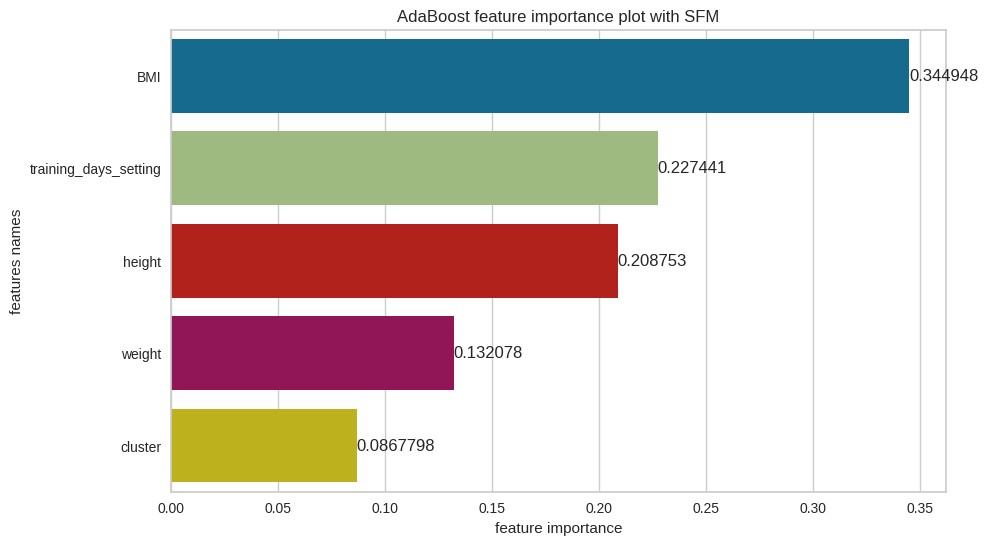

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=4), 'learning_rate': 0.01, 'n_estimators': 40, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features selected: Index(['activity_level', 'height', 'BMI', 'body_fat', 'training_days_setting'], dtype='object')
[GradientBoost] Features importances: [0.06760278720552501, 0.20105815133640317, 0.2880217413789813, 0.17997502013212566, 0.2633422999469649]


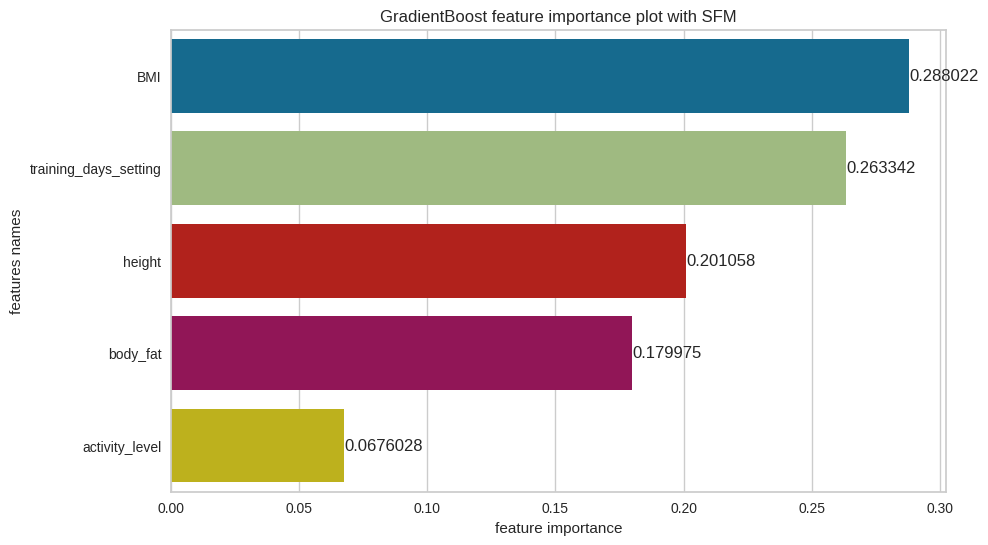

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [60]:
estimators_multiclass_u_sel_sfm2, X_test_u_sel_sfm2, y_test_u_sel_sfm2, X_train_u_sel_sfm2, y_train_u_sel_sfm2, X_train_inv_u_sel_sfm2, X_test_inv_u_sel_sfm2, features_u_sel_sfm2 = train(X_users2, 
                                                                                                   y_users2
                                                                                                   ,
                                                         params, 
                                                         seed, feature_selection = True, 
                                                         feature_sel_type = 'SFM')

In [61]:
evaluation_table_u_sel_sfm2 = evaluate_multiclass(estimators_multiclass_u_sel_sfm2,
                                                 X_test_u_sel_sfm2, y_test_u_sel_sfm2, 
                                                 features_u_sel_sfm2, features_selected = True)

In [62]:
evaluation_table_u_sel_sfm2

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.05,0.04,15.98,4.52,632.95,278.32
Linear Regression,0.03,0.03,16.26,4.69,640.17,280.96
Lasso,0.05,0.04,16.12,4.62,632.85,277.69
Ridge,0.03,0.03,16.26,4.69,639.95,280.93
Decision Tree,0.05,0.04,16.08,4.65,633.14,274.74
Random Forest,0.04,0.04,16.06,4.60,634.55,280.69
AdaBoost,0.05,0.05,16.12,4.61,629.15,274.65
GradientBoost,0.05,0.05,15.97,4.57,627.50,278.87


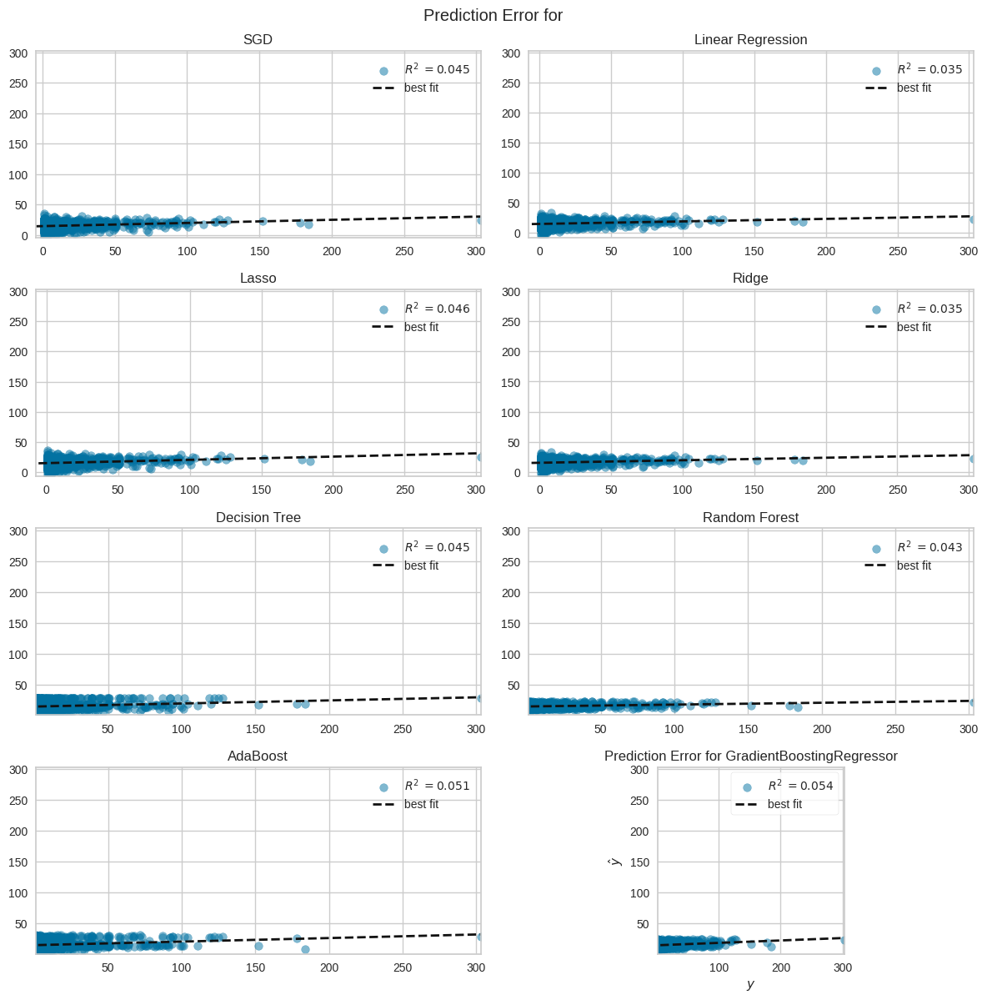

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [63]:
prediction_error_plot(estimators_multiclass_u_sel_sfm2, X_train_u_sel_sfm2, y_train_u_sel_sfm2, 
                      X_test_u_sel_sfm2, y_test_u_sel_sfm2, features_u_sel_sfm2, 
                      features_selected = True, name = 'all')

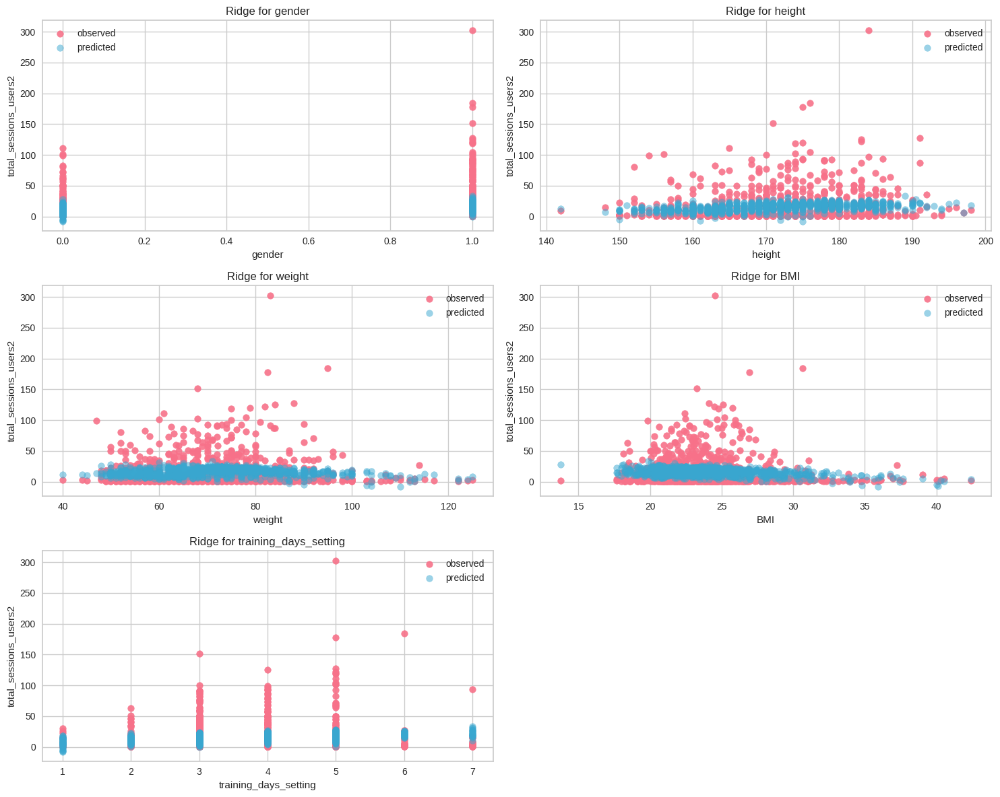

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [44]:
plots_regr(estimators_multiclass_u_sel_sfm2, X_users2, y_users2, X_train_u_sel_sfm2, y_train_u_sel_sfm2, 
           X_test_u_sel_sfm2, y_test_u_sel_sfm2, X_train_inv_u_sel_sfm2, 
           X_test_inv_u_sel_sfm2, features_u_sel_sfm2, features_selected = True, name = 'Ridge')

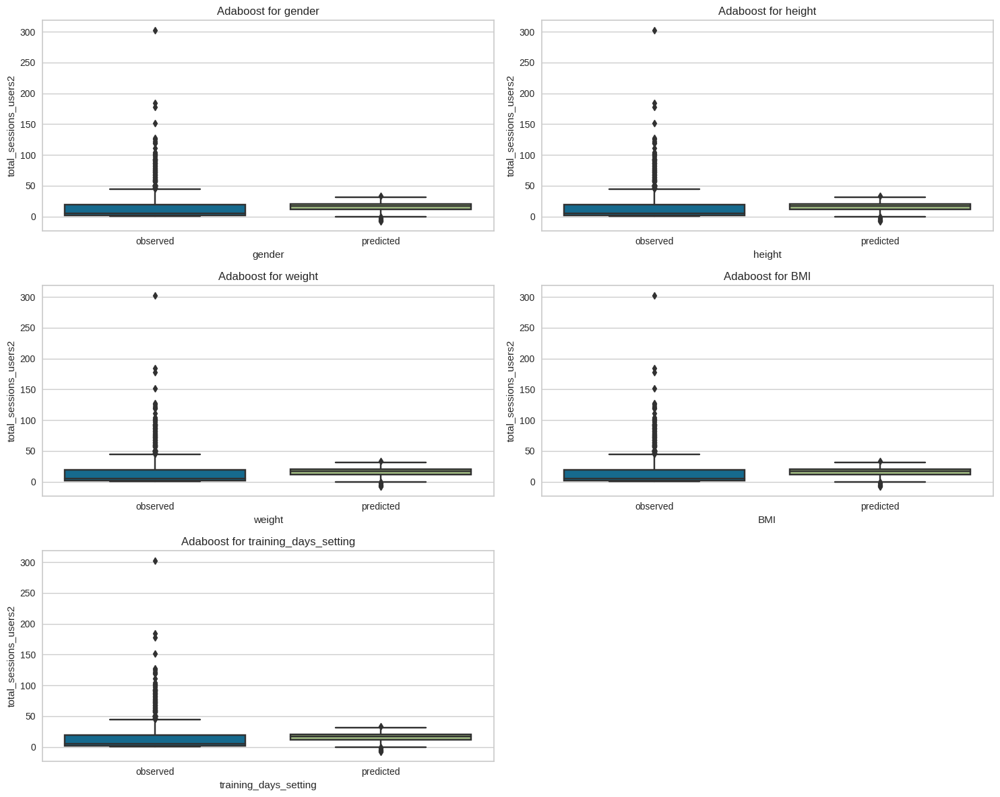

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [45]:
plots_box(estimators_multiclass_u_sel_sfm2, X_users2, y_users2, X_train_u_sel_sfm2, y_train_u_sel_sfm2, 
          X_test_u_sel_sfm2, y_test_u_sel_sfm2, features_u_sel_sfm2, X_train_inv_u_sel_sfm2, 
          X_test_inv_u_sel_sfm2, features_selected = True, name = 'Ridge')

## For session execution (total_time_session_execution)

In this subsection, we'll do a regression of total_time_session_execution.

The features are:
* difficulty_feedback_session_execution,
* enjoyment_feedback_session_execution,
* active_user_programs,
* completed_user_programs,
* endurance_programs,
* technique_programs,
* flexibility_programs,
* intensity_programs,
* total_reps_session_execution,
* reps_per_min_session_execution,
* calories_session_execution,
* number_exercises_in_session,
* number_exercises_without_rest_in_session.

In [46]:
X_sessions = df_session_exe.loc[:, ['difficulty_feedback_session_execution',
                                    'enjoyment_feedback_session_execution', 'active_user_programs', 
                                    'completed_user_programs', 'endurance_programs', 'technique_programs', 
                                    'flexibility_programs', 'intensity_programs', 
                                    'total_reps_session_execution','reps_per_min_session_execution', 
                                    'calories_session_execution', 'number_exercises_in_session',
                                    'number_exercises_without_rest_in_session']]

for col in ['difficulty_feedback_session_execution', 'enjoyment_feedback_session_execution', 
            'active_user_programs', 'completed_user_programs', 'endurance_programs', 'technique_programs', 
            'flexibility_programs', 'intensity_programs']:
    X_sessions[col] = X_sessions[col].astype('category')
    
'''
for col in ['difficulty_feedback_session_execution', 'enjoyment_feedback_session_execution', 
            'active_user_programs', 'completed_user_programs', 'endurance_programs', 'technique_programs', 
            'flexibility_programs', 'intensity_programs']:
    X_sessions[col] = LabelEncoder().fit_transform(X_sessions[col])
'''
cat_cols = ['difficulty_feedback_session_execution', 'enjoyment_feedback_session_execution', 
            'active_user_programs', 'completed_user_programs', 'endurance_programs', 'technique_programs', 
            'flexibility_programs', 'intensity_programs']
X_sessions = pd.get_dummies(X_sessions, columns = cat_cols, drop_first = True)



y_sessions = df_session_exe['total_time_session_execution']

In [34]:
# corr_heatmap_p(X_sessions) # to check multicollinearity

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [155.20003889419505, -134.6856521253884, 443.95023750107, 173.84760316274262, -69.74932138533981, 4.563683088108155, 9.267358354705147, 10.735505454425915, 22.35757153705531, 27.165938252193534, 24.430977590243497, 16.348812909856257, 14.118944158976245, 12.15826794798504, 9.399397644304292, 38.74386658304754, 46.19995481616132, 39.3639539245513, -2.2813950895787882, -12.081116539995497, -67.52818448003013, -49.83339028440692, 71.34523584298891, 14.05725339016653, 28.964259689573645, 43.61631938784706, -57.42373934089823, 6.412388491663941, -76.09231461012268, 28.15495529868302, -5.923997247232757, 15.375648601176795, -2.6714424504193364, 59.44267734190773, -30.38941496496856, -17.30644173304924]


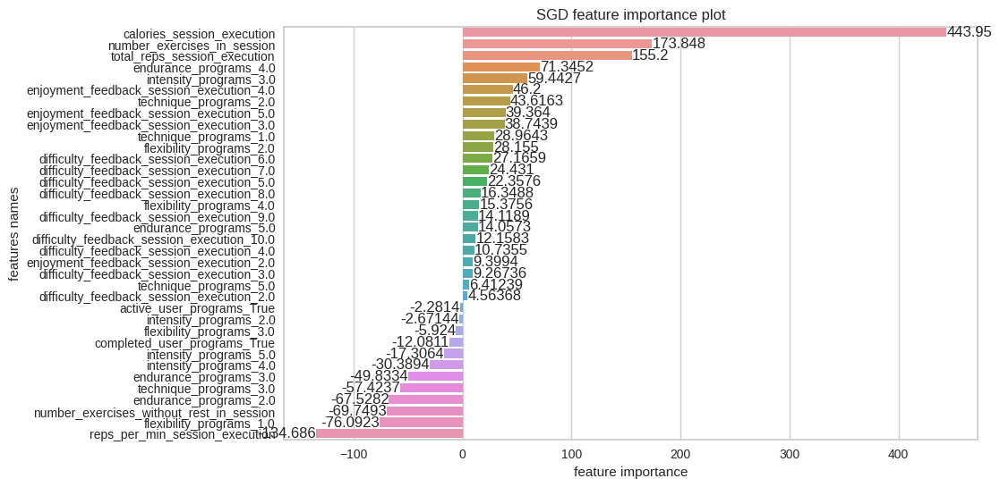

[SGD] Best parameters are {'alpha': 1e-05, 'eta0': 0.07502500000000001, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'elasticnet', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [155.15182365475616, -134.69665916931885, 443.9792186556588, 174.13461785495767, -69.8485117351811, 4.384410002571334, 9.050728169575464, 10.625289946421171, 22.063179050703845, 26.700444026988425, 24.0755326874065, 16.153052875351115, 14.077780715781952, 12.079874305929959, 9.345444694298806, 37.638407404272094, 45.157894082384026, 38.82319848798805, -2.373198704471917, -12.29905892195524, 30070972773913.84, 33239345604763.164, 42859478563247.78, 21508106442627.82, -17679417336154.402, -9318927915409.006, -19850517642286.008, -11234251430259.44, -46098783694425.414, -74019741409269.17, -51010015610868.71, -75522137000751.88, 39230939018142.55, 34173742608463.67, 52519329336685.62, 41188394999492.766]


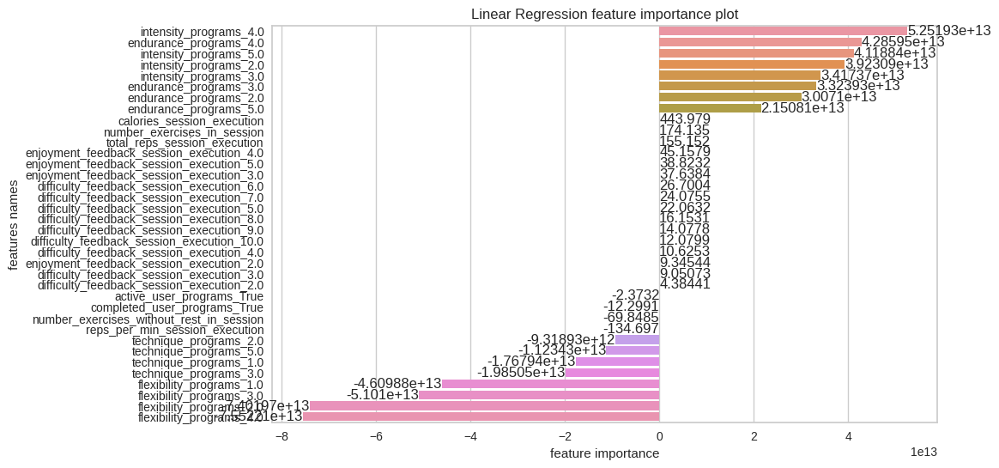

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.112e+07, tolerance: 1.206e+06
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.255e+07, tolerance: 1.205e+06
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

[Lasso] Features importances: [155.1517942490736, -134.65543265513998, 443.9115559573726, 173.86548174542395, -69.7823737956869, 4.493009281187457, 9.154655481395356, 10.607477409284307, 22.07212803429682, 26.970652094034918, 24.244149423080433, 16.19211847692592, 14.010414717312077, 12.088793138783315, 9.23080824274301, 38.17166911401803, 45.62742614642144, 38.957088267203275, -2.2841394090891796, -12.056220596025623, -100.396686844988, -86.14580714738759, 24.53825227891952, -9.434871788633528, 60.22840079132204, 60.14344467701969, -22.41527971488979, 26.255838837865966, -81.76991567338628, 19.20402038462453, -12.156204930404128, 6.207964743860498, 13.96767212915172, 74.00015368787874, -7.973668322895275, 0.282868345895571]


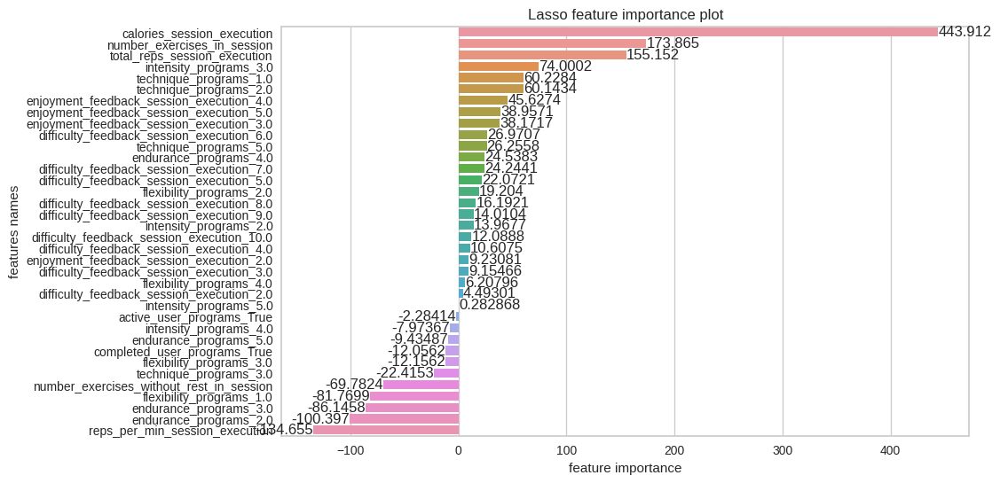

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [155.1645331146632, -134.6618557974686, 443.8457083799924, 173.80736539638323, -69.69923837900978, 4.463488175395695, 9.10476947848081, 10.553507953259675, 21.95829254616801, 26.888488900616455, 24.165257842934768, 16.134731302126113, 13.969611417140884, 12.054899192256356, 9.150417028451772, 37.886370591637174, 45.3627704251857, 38.739754472452454, -2.2813592867116346, -12.05435011726159, -67.27093520533143, -49.59435806430178, 71.19879784225976, 13.941164806620298, 28.967048778475018, 43.6375308787744, -57.30626664426492, 6.515870339802622, -76.0244414258989, 28.251433890434253, -5.965324481207823, 15.441389332953367, -2.874585777158837, 59.247779651238986, -30.186965211991616, -17.0856147444475]


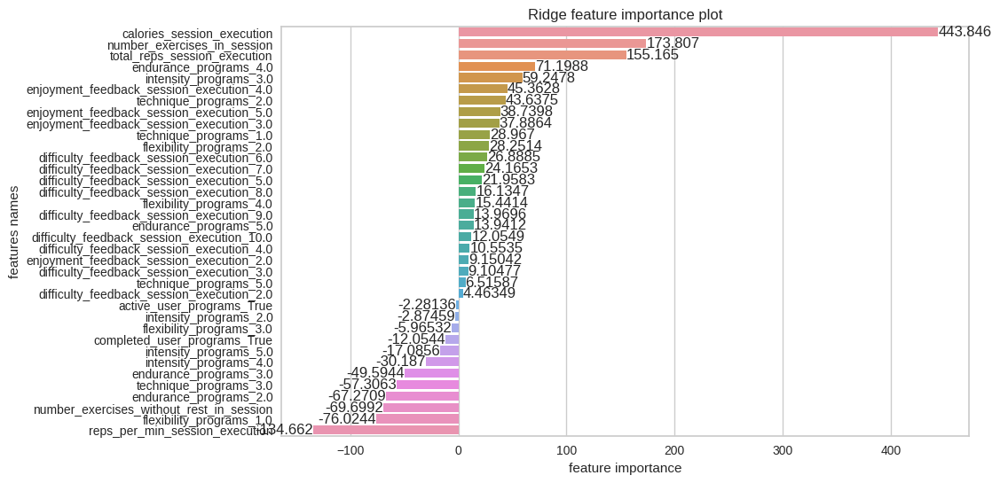

[Ridge] Best parameters are {'alpha': 2.0, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.9464632536039803, 0.05353674639601972, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


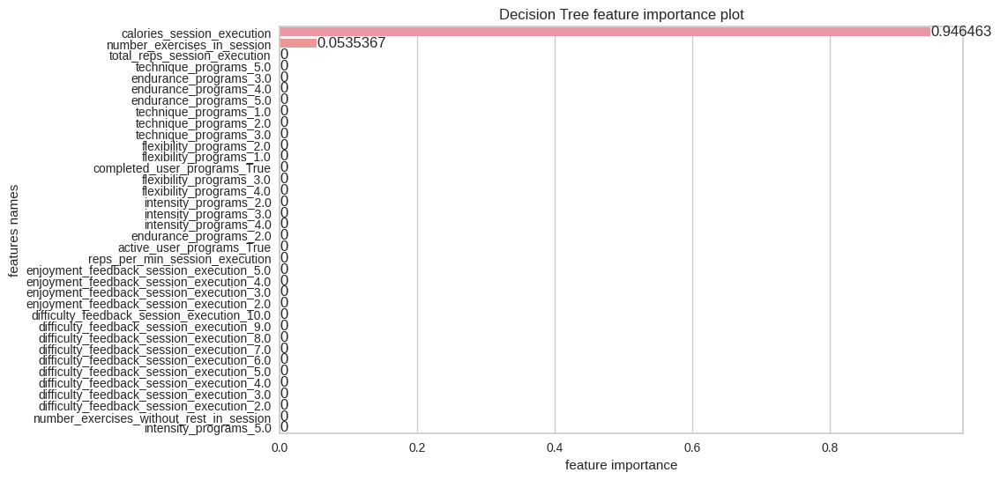

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.20559466356102335, 0.05229723072451258, 0.31584179045244043, 0.20766436205642744, 0.08012762266287597, 0.0, 0.0, 0.0, 0.0034241538972945174, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0012735363506170259, 0.00030357445505102613, 0.0002192746681324121, 0.0, 0.001776079189485814, 0.0, 0.0006967138193810753, 0.03651860742094268, 0.0, 0.005740630625119457, 0.0, 0.003511928752952259, 0.0, 0.0, 0.0019663798697748046, 0.0, 0.004351621435689791, 0.046174786881199165, 0.0, 0.001961676494933591, 0.030555366682146676]


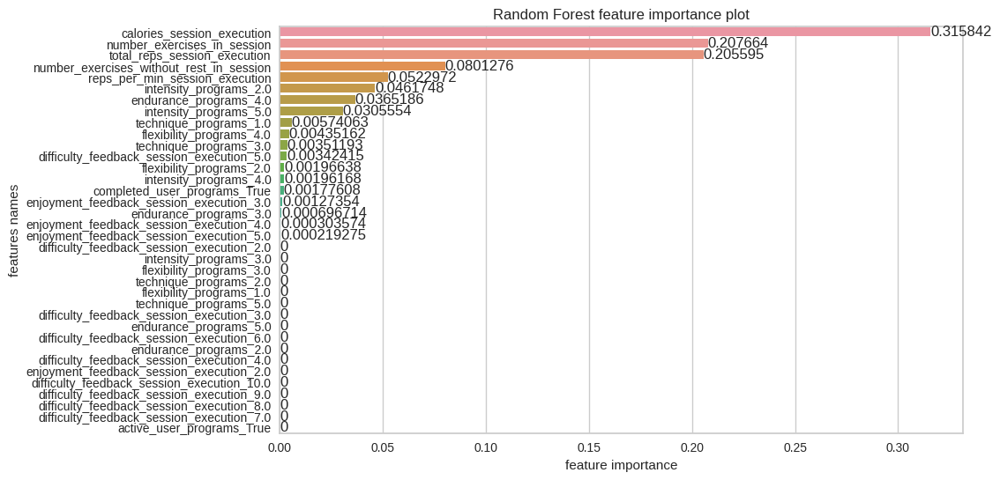

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.025610700086586925, 0.06295879066721478, 0.8473657504668131, 0.0490928351688542, 0.009889816660761042, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 5.57126272296432e-05, 0.0, 4.876881619669085e-05, 0.00040499996832907796, 0.0, 0.0, 0.00013736311093524173, 0.0, 1.1091233164103475e-05, 0.0002980378997677269, 0.0009584746538273017, 4.853818329635037e-05, 0.0, 2.1228320985493912e-05, 0.0, 0.0009848145441374598, 0.0009018049633109869, 0.00042866236945010463, 5.5278004000509696e-05, 0.0006666435616732199, 4.791670953061001e-05, 0.0, 1.2771983935143318e-05]


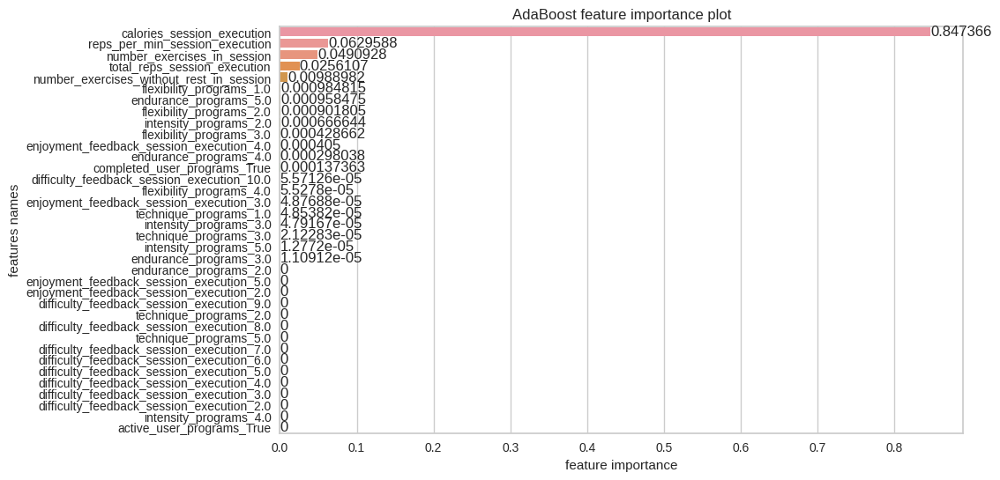

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.1, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost


In [ ]:
estimators_multiclass_s, X_test_s, y_test_s, X_train_s, y_train_s, X_train_inv_s, X_test_inv_s, features_s = train(X_sessions, y_sessions, 
                                                         params, 
                                                         seed)

In [ ]:
evaluation_table_s = evaluate_multiclass(estimators_multiclass_s, X_test_s, y_test_s, features_s)


In [ ]:
evaluation_table_s 

Here, the best regression model is AdaBoost with Decision Tree with max depth equal to 5 as base estimator, learning rate equal to 0.1 and number of estimators equal to 80. The $R^2$ score is 89%, which is very good, adjusted $R^2$ is also 89%. MAE is 166.2, which is the lowest for all of the algorithms, MAPE is 0.17, which is also the lowest and a good number. MSE is 49782.35 (the lowest value). MMAx error is not the lowest value and it is 3082.38.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

In [ ]:
prediction_error_plot(estimators_multiclass_s, X_train_s, y_train_s, X_test_s, y_test_s,
                      features_s,
                      features_selected = False,
                      name = 'all')

In [ ]:
plots_regr(estimators_multiclass_s, X_sessions,y_sessions, X_train_s, y_train_s, 
           X_test_s, y_test_s, X_train_inv_s, 
           X_test_inv_s,
           features_s,
           features_selected = False,
           name = 'AdaBoost')

In [ ]:
plots_box(estimators_multiclass_s, X_sessions, y_sessions, X_train_s, y_train_s, 
          X_test_s, y_test_s, features_s, X_train_inv_s, 
          X_test_inv_s, features_selected = False, name = 'AdaBoost')

## For adherence

In [25]:
# Preparation

df_session_exe_days_setting['YYYY/WW'].min() # min week and year is 2021/21

df_session_exe_days_setting['YYYY/WW'].max() # maximum week and year is 2022/21

# here we create new df with dates (for whole year, week by week)

week_year_table = pd.DataFrame({'Date': pd.date_range('24-05-2021', '28-05-2022')})
week_year_table = week_year_table.assign(weeknum1= week_year_table['Date'].dt.strftime('%Y/%V'))


week_year_table.rename(columns={'weeknum1': 'YYYY/WW'},
           inplace = True)

week_year_table = week_year_table.assign(weeknum2= week_year_table['Date'].dt.strftime('%V'))
week_year_table.rename(columns={'weeknum2': 'WW'},
           inplace = True)

week_year_table = week_year_table.assign(weeknum3= week_year_table['Date'].dt.strftime('%Y'))
week_year_table.rename(columns={'weeknum3': 'YYYY'},
           inplace = True)


week_year_table['YYYY/WW'] = np.where((week_year_table['YYYY/WW'] == '2022/52') & 
                           (week_year_table['Date'].dt.year == 2022) & 
                           (week_year_table['Date'].dt.month == 1) &
                           (week_year_table['Date'].dt.strftime("%V") == '52'),
                          '2021/52', week_year_table['YYYY/WW'] )

week_year_table = week_year_table.drop_duplicates(subset=['YYYY/WW'], keep = 'first').reset_index()

week_year_table.drop(['index'], axis = 1, inplace = True)

# we are copying the old dataframe

df_session_exe_days_setting_all_weeks = df_session_exe_days_setting.copy()

# here we are mergining new dataframe with the dataframe will only dates

df_session_exe_days_setting_all_weeks = df_session_exe_days_setting_all_weeks.merge(week_year_table, how = 'left', left_on = 'YYYY/WW', right_on = 'YYYY/WW')

# this is the funtion for giving dates weekly - from the start date till the end date (it will be used for each user - from first training to the last one)

def expand_dates(ser):
    return pd.DataFrame({'Date': pd.date_range(ser['Date'].min(), ser['Date'].max(), freq='W')})


newdf = df_session_exe_days_setting_all_weeks.groupby(['id_users']) # we are grouping the users and creating new df

newdf = newdf.apply(expand_dates).reset_index() # now we are using the functions

# below we merge new df with previous one, to get all of the weeks
newdf2 = newdf.merge(df_session_exe_days_setting_all_weeks, how = 'outer', left_on = ['Date', 'id_users'], right_on = ['Date', 'id_users'])

newdf2.drop(['level_1'], axis = 1, inplace = True)

newdf3 = newdf2.copy()

# we are dropping old week and year values to create new ones (for nan sake)
newdf3.drop(['YYYY/WW', 'WW', 'YYYY'], axis = 1, inplace = True)

# creation of new time variables
newdf3 = newdf3.assign(weeknum1= newdf3['Date'].dt.strftime('%Y/%V'))

newdf3.rename(columns={'weeknum1': 'YYYY/WW'},
           inplace = True)

newdf3 = newdf3.assign(weeknum2= newdf3['Date'].dt.strftime('%V'))
newdf3.rename(columns={'weeknum2': 'WW'},
           inplace = True)

newdf3 = newdf3.assign(weeknum3= newdf3['Date'].dt.strftime('%Y'))
newdf3.rename(columns={'weeknum3': 'YYYY'},
           inplace = True)


newdf3['YYYY/WW'] = np.where((newdf3['YYYY/WW'] == '2022/52') & 
                           (newdf3['Date'].dt.year == 2022) & 
                           (newdf3['Date'].dt.month == 1) &
                           (newdf3['Date'].dt.strftime("%V") == '52'),
                          '2021/52', newdf3['YYYY/WW'] )

# sorting values by id user and date, to get non-null values before the null one
newdf3.sort_values(['id_users','YYYY/WW', 'Date'], inplace = True, na_position='last')

newdf3 = newdf3.reset_index()

newdf3.drop(['index'], axis = 1, inplace = True)

newdf4 = newdf3.copy()

newdf4 = newdf4.drop_duplicates(subset = ['id_users', 'YYYY/WW'], keep = 'first')

newdf5 = newdf4.copy()

newdf5.columns

newdf5[['days_a_week_session_exe', 'training_days_goal_achieved']] = newdf5[['days_a_week_session_exe','training_days_goal_achieved']].fillna(value=0)

newdf5[['training_days_setting']] = newdf5[['training_days_setting']].fillna(method='ffill')

In [26]:
# new dataframe with all the weeks (when someone worked out and didn't workout as well) - first 15 weeks

df_session_exe_days_all_weeks = newdf5.copy() 

df_session_exe_days_all_weeks.isna().sum() # number of NA values in columns

df_first_15_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(15).reset_index(drop=True)
df_first_15_weeks_achieved_sum = df_first_15_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()


df_first_15_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_15_weeks'},
                                      inplace = True)


df_first_15_weeks_worked_sum = df_first_15_weeks.groupby(['id_users'])['training_days_goal_achieved', 'days_a_week_session_exe'].sum().reset_index()

df_first_15_weeks_worked_sum.rename(columns={'training_days_goal_achieved': 'no_weeks_goal_achieved_15_weeks',
                                             'days_a_week_session_exe': 'no_of_days_with_workout_15_weeks'},
                                    inplace = True)


df_users = df_users_only.loc[:, ['id_users','gender', 'activity_level', 'body_type', 'newsletter_subscription',
                                   'height', 'weight', 'BMI', 'body_fat', 'training_days_setting', 
                                'total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user',
                                'reps_per_session_users2', 'kcal_per_session_users2']]


df_users_adh_cat = df_users.merge(df_first_15_weeks_worked_sum, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_adh_cat.drop(['id_users'], axis = 1, inplace = True)

In [27]:
# first 12 weeks 

df_first_12_weeks = df_session_exe_days_all_weeks.groupby('id_users').head(12).reset_index(drop=True)

df_first_12_weeks_achieved_sum = df_first_12_weeks.groupby(['id_users'])['training_days_goal_achieved'].sum().reset_index()

df_first_12_weeks_achieved_sum.rename(columns = {'training_days_goal_achieved': 'no_weeks_goal_achieved_12_weeks'},
                                      inplace = True)

df_first_12_weeks_achieved_sum2 = df_first_12_weeks_achieved_sum.copy()

df_users_adh_12_weeks = df_users.merge(df_first_12_weeks_achieved_sum2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_users_adh_12_weeks.drop(['id_users'], axis = 1, inplace = True)


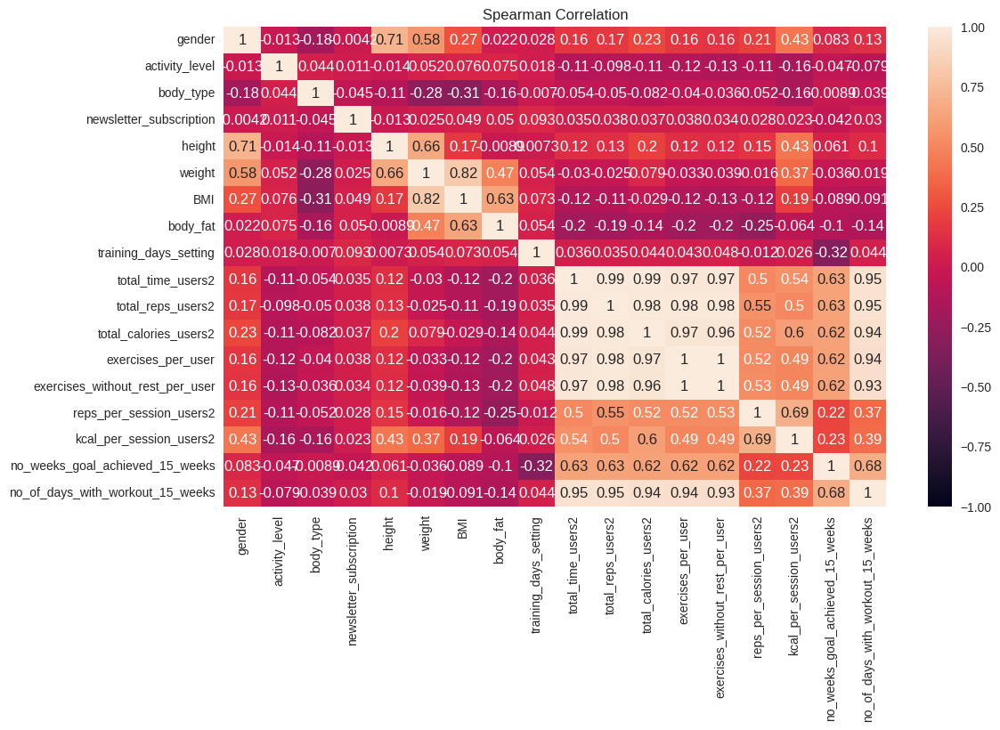

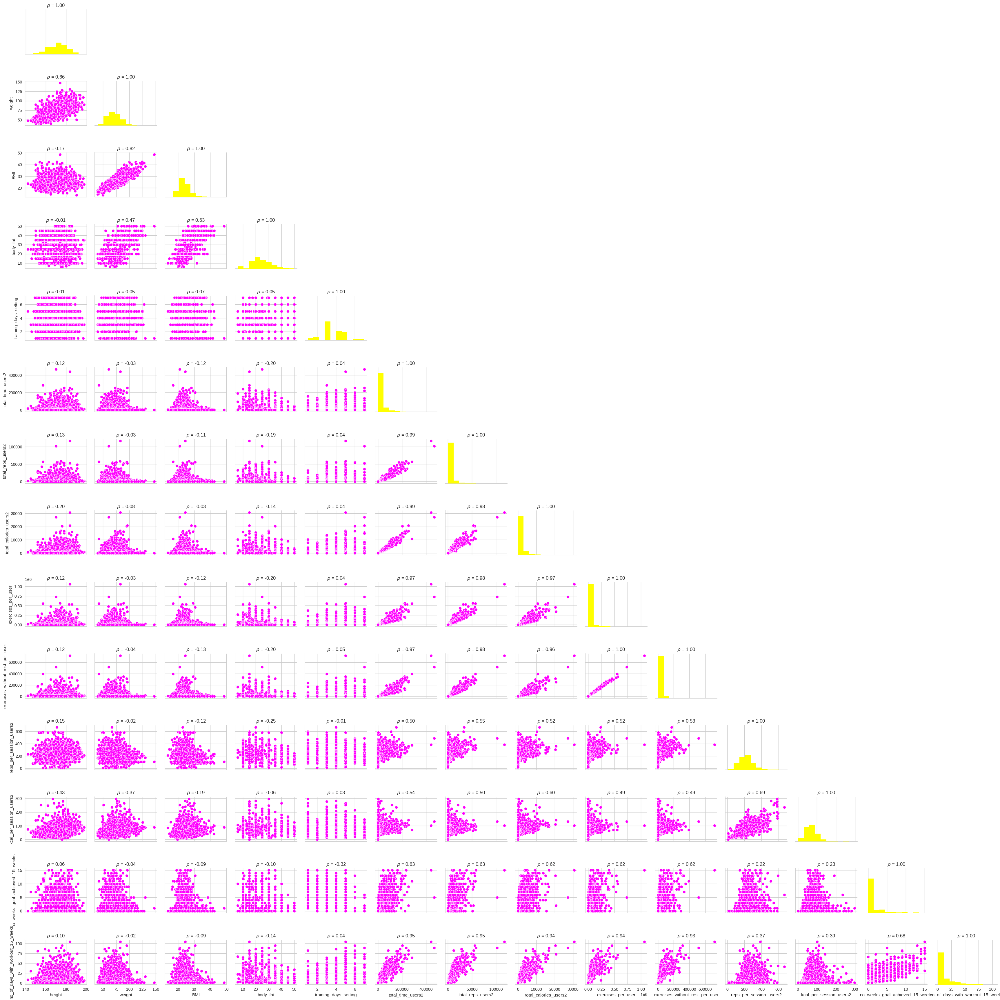

,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,reps_per_session_users2,kcal_per_session_users2,no_weeks_goal_achieved_15_weeks,no_of_days_with_workout_15_weeks
gender,1.00,-0.01,-0.18***,-0.00,0.71***,0.58***,0.27***,0.02,0.03,0.16***,0.17***,0.23***,0.16***,0.16***,0.21***,0.43***,0.08***,0.13***
activity_level,-0.01,1.00,0.04*,0.01,-0.01,0.05**,0.08***,0.07***,0.02,-0.11***,-0.1***,-0.11***,-0.12***,-0.13***,-0.11***,-0.16***,-0.05**,-0.08***
body_type,-0.18***,0.04*,1.00,-0.05*,-0.11***,-0.28***,-0.31***,-0.16***,-0.01,-0.05**,-0.05**,-0.08***,-0.04*,-0.04*,-0.05**,-0.16***,-0.01,-0.04*
newsletter_subscription,-0.00,0.01,-0.05*,1.00,-0.01,0.03,0.05**,0.05**,0.09***,0.03,0.04*,0.04*,0.04*,0.03,0.03,0.02,-0.04*,0.03
height,0.71***,-0.01,-0.11***,-0.01,1.00,0.66***,0.17***,-0.01,0.01,0.12***,0.13***,0.2***,0.12***,0.12***,0.15***,0.43***,0.06***,0.1***
weight,0.58***,0.05**,-0.28***,0.03,0.66***,1.00,0.82***,0.47***,0.05**,-0.03,-0.03,0.08***,-0.03,-0.04*,-0.02,0.37***,-0.04*,-0.02
BMI,0.27***,0.08***,-0.31***,0.05**,0.17***,0.82***,1.00,0.63***,0.07***,-0.12***,-0.11***,-0.03,-0.12***,-0.13***,-0.12***,0.19***,-0.09***,-0.09***
body_fat,0.02,0.07***,-0.16***,0.05**,-0.01,0.47***,0.63***,1.00,0.05**,-0.2***,-0.19***,-0.14***,-0.2***,-0.2***,-0.25***,-0.06***,-0.1***,-0.14***
training_days_setting,0.03,0.02,-0.01,0.09***,0.01,0.05**,0.07***,0.05**,1.00,0.04*,0.04,0.04*,0.04*,0.05**,-0.01,0.03,-0.32***,0.04*
total_time_users2,0.16***,-0.11***,-0.05**,0.03,0.12***,-0.03,-0.12***,-0.2***,0.04*,1.00,0.99***,0.99***,0.97***,0.97***,0.5***,0.54***,0.63***,0.95***


In [44]:
corr_heatmap_p(df_users_adh_cat)

In [22]:
df_users_adh_cat.drop(['total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user'], axis = 1, inplace = True)

In [23]:
# corr_heatmap_p(df_users_adh_12_weeks)

In [24]:
# df_users_adh_12_weeks.drop(['total_time_users2', 'total_reps_users2',
#                                         'total_calories_users2', 'exercises_per_user', 
#                                         'exercises_without_rest_per_user'], axis = 1, inplace = True)

### First approach (first 15 weeks, all of the users variables)

Here, we'll try to predict number of weeks when the week goal was achieved (in the first 15 weeks).

y (to be predicted): no_weeks_goal_achieved,

x (predictors) - variables taken into consideration:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

Because 
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user 

are highly correlated, so we will use instead of them 
* reps_per_session, 
* kcal_per_session.

So we won't violate the assumption of multicollinearity.

In [28]:
# deleting label from data
X_adh_cat = df_users_adh_cat.loc[:, df_users_adh_cat.columns != 'no_weeks_goal_achieved_15_weeks']
X_adh_cat = df_users_adh_cat.loc[:, df_users_adh_cat.columns != 'no_of_days_with_workout_15_weeks']

# variable only with label
y_adh_cat = df_users_adh_cat['no_weeks_goal_achieved_15_weeks']


for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat[col] = LabelEncoder().fit_transform(X_adh_cat[col])

'''
cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']
X_adh_cat = pd.get_dummies(X_adh_cat, columns = cat_cols, drop_first = True)
'''

"\ncat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']\nX_adh_cat = pd.get_dummies(X_adh_cat, columns = cat_cols, drop_first = True)\n"

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.5835850628988903]


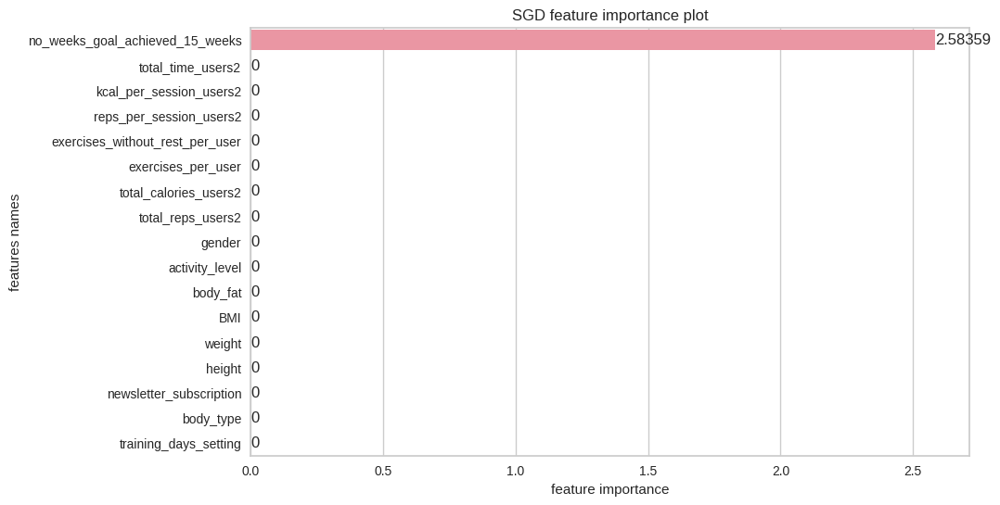

[SGD] Best parameters are {'alpha': 0.0002575, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [-4.717367448490422e-16, 8.604228440844963e-16, 1.5480160424097012e-15, 2.5958877604566655e-16, 6.847240575186811e-16, 6.677964549353917e-16, 5.931505507133027e-16, -3.7961700928837256e-16, -1.6158083315666013e-15, 3.092401187913619e-15, 1.4024413214152438e-15, -7.276710215404126e-16, 2.0149784653764e-15, -1.8204297709894725e-15, -8.087065903636658e-16, 1.0197267216458976e-15, 2.5838557711109247]


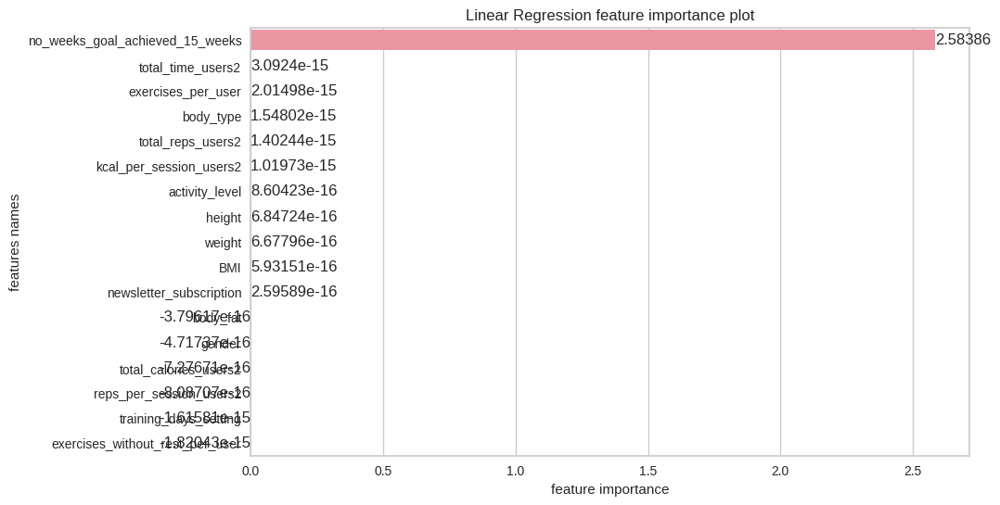

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [-0.000157859215948699, -0.0001070915550602508, -6.437142020512043e-06, -9.449112012124432e-07, 0.001053988194555538, -0.0019487087604159105, 0.0014235796456140957, 5.8538727308285627e-05, -0.0002657015014542642, -0.0024689468650791534, 0.011429829035315508, -0.003857134614731335, 0.013360110525563157, -0.01778134114921944, -0.0008404102581311471, 0.0009918323258205966, 2.5831180988523337]


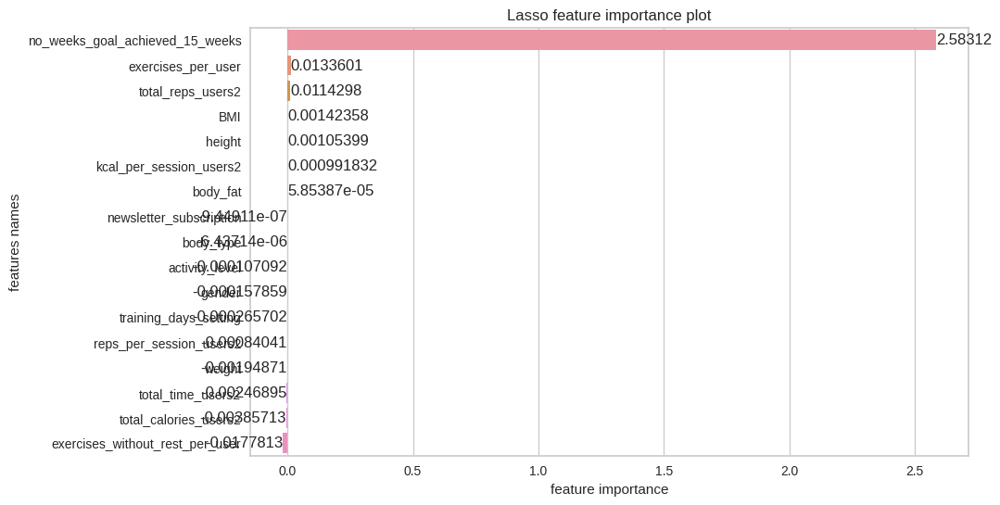

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [-5.691634048511121e-11, -5.632787338513838e-10, 4.315839203874305e-10, -4.689514093982995e-10, 2.7045534068364194e-09, -3.941297573321133e-09, 3.3077000803640873e-09, 8.365000781734935e-10, -8.54893444516434e-09, 2.5242788021805422e-08, 1.608419148162007e-08, -1.4958723854007777e-08, 2.1470785283732885e-08, -2.9705101722062705e-08, -2.1914484152029108e-10, -6.359691948430605e-10, 2.583855743633738]


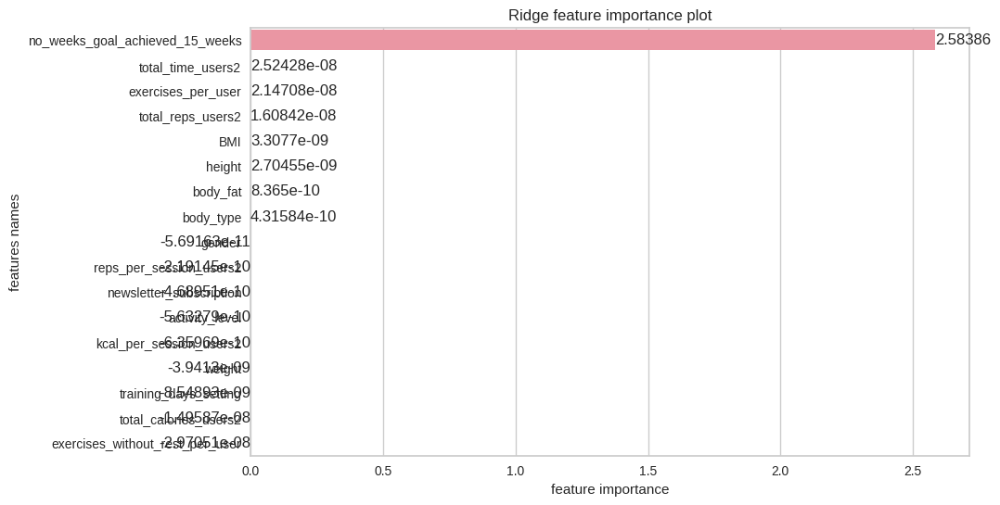

[Ridge] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0]


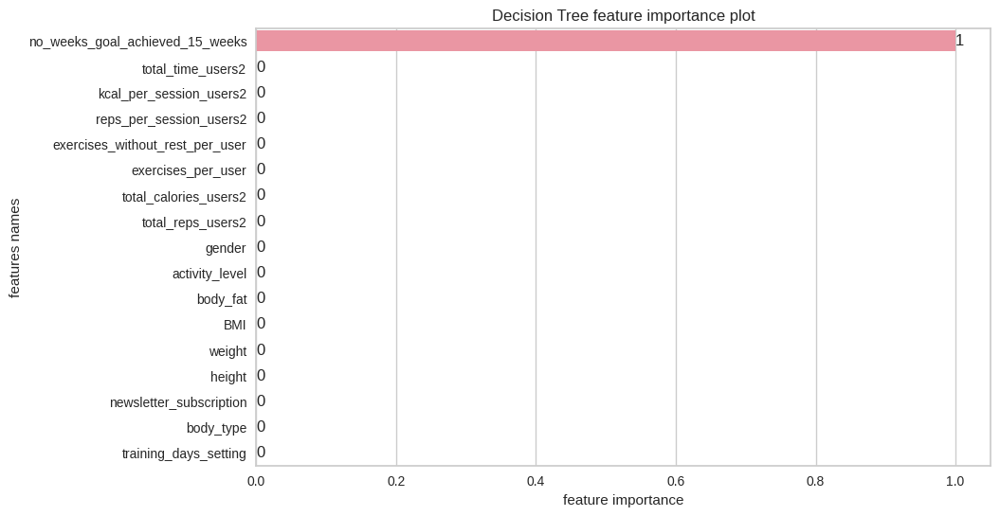

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 3, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0003260859982284014, 4.886332833682906e-05, 1.4112509834823405e-06, 6.436434548891415e-05, 6.171152232078129e-05, 1.01249753717378e-05, 0.0006375412424389067, 0.0, 0.004988640721587202, 0.21057311860719932, 0.10645040238064013, 0.0937421132449624, 0.13230892213572878, 0.05072150446708984, 0.0031926267875061008, 0.004412179566767933, 0.39246038942534917]


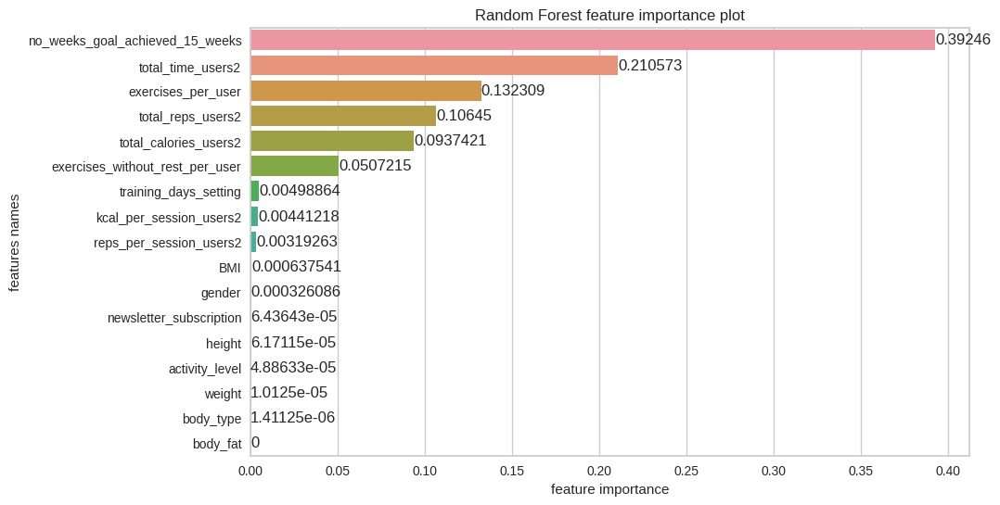

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.079734826752803e-05, 0.0, 0.0, 0.0, 0.9999692026517325]


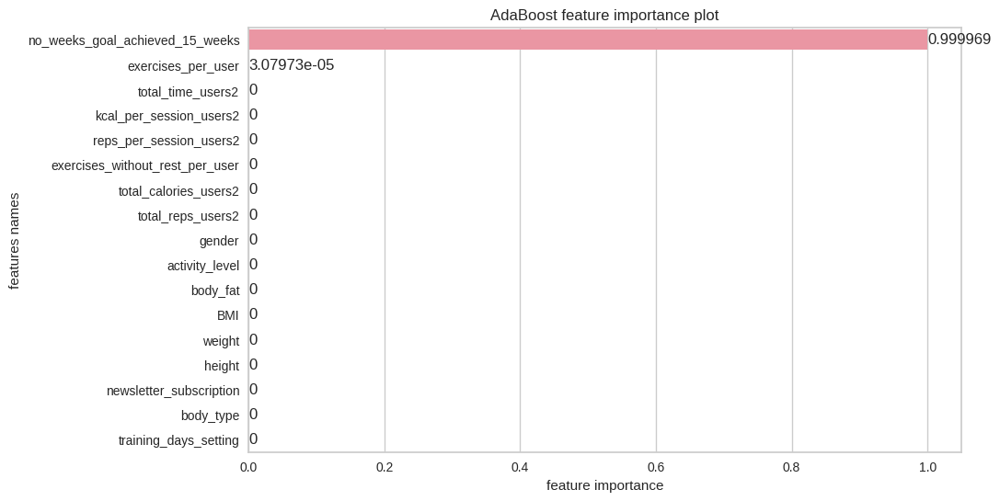

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.05, 'n_estimators': 20, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.0, 0.0, 0.0, 0.0001836016034969493, 0.0, 2.716730096566029e-05, 0.0, 0.0, 0.0037800358704576913, 0.08590220532813549, 0.14551108618731656, 0.14154085020016874, 0.02748083063168274, 0.08585573894051689, 7.892600053203447e-05, 0.004909112915824417, 0.5047304450209028]


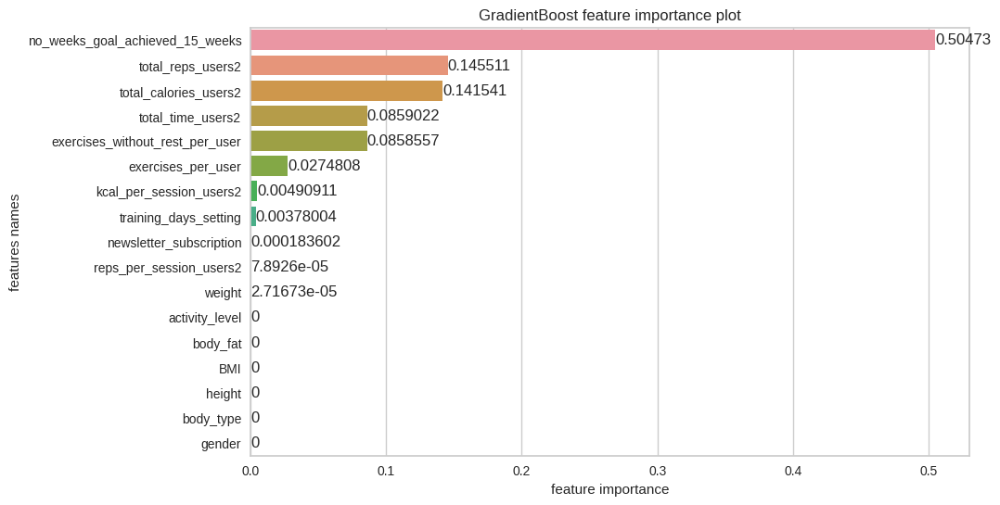

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [29]:
estimators_multiclass_ga, X_test_ga, y_test_ga, X_train_ga, y_train_ga, X_train_inv_ga, X_test_inv_ga, features_ga = train(X_adh_cat, y_adh_cat, 
                                                         params, 
                                                         seed)

In [30]:
evaluation_table_ga = evaluate_multiclass(estimators_multiclass_ga, X_test_ga, y_test_ga, features_ga)


In [31]:
evaluation_table_ga

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,1.00,1.00,0.00,378402460900.29,0.00,0.00
Linear Regression,1.00,1.00,0.00,9.79,0.00,0.00
Lasso,1.00,1.00,0.00,1592961543626.59,0.00,0.02
Ridge,1.00,1.00,0.00,22666007.20,0.00,0.00
Decision Tree,0.83,0.83,0.39,0.07,1.24,8.01
Random Forest,0.63,0.62,0.86,1120549294298781.62,2.79,10.23
AdaBoost,1.00,1.00,0.00,0.00,0.00,0.00
GradientBoost,0.65,0.65,0.82,1266801084989666.50,2.58,10.37


Here, the best regression model is AdaBoost with Decision Tree with max depth equal to 5 as base estimator, learning rate equal to 0.05 and number of estimators equal to 80. The $R^2$ score is 88%, which is very good, adjusted $R^2$ is also 88%. MAE is 0.55, which is the lowest for all of the algorithms. MSE is 0.9 (the lowest value). Max error is not the lowest value, but it is 4.8.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

In [ ]:
prediction_error_plot(estimators_multiclass_ga, X_train_ga, y_train_ga, X_test_ga, y_test_ga, 
                      features_u2,
                      features_selected = False, name = 'all')

In [ ]:
plots_regr(estimators_multiclass_ga, X_adh_cat, y_adh_cat, X_train_ga, y_train_ga, 
           X_test_ga, y_test_ga, X_train_inv_ga, 
           X_test_inv_ga,
           features_ga,
           features_selected = False,
           name = 'AdaBoost')

In [ ]:
plots_box(estimators_multiclass_ga, X_adh_cat, y_adh_cat, X_train_ga, y_train_ga, 
          X_test_ga, y_test_ga, features_ga, X_train_inv_ga, 
          X_test_inv_ga, features_selected = False, name = 'AdaBoost')

### Second approach (first 12 weeks, all of the users variables)

Here, we'll try to predict number of weeks when the week goal was achieved (in the first 12 weeks).

y (to be predicted): no_weeks_goal_achieved,

x (predictors) - variables taken into consideration:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user, 
* no_of_days_with_workout_15_weeks.

Because 
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user 

are highly correlated, so we will use instead of them 
* reps_per_session, 
* kcal_per_session.

So we won't violate the assumption of multicollinearity.

In [124]:
# deleting label from data
X_adh_12 = df_users_adh_12_weeks.loc[:, df_users_adh_12_weeks.columns != 'no_weeks_goal_achieved_12_weeks']

# variable only with label
y_adh_12 = df_users_adh_12_weeks['no_weeks_goal_achieved_12_weeks']
'''
for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_12[col] = LabelEncoder().fit_transform(X_adh_12[col])
'''
    
cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']

X_adh_12 = pd.get_dummies(X_adh_12, columns = cat_cols, drop_first = True)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [0.08871910457182426, -0.004401335086650146, 0.0, 0.050003933030757716, 1.875595439203358, 1.285265661795766, -1.0991906358856385, 1.5663691305502807, -2.2275665782788074, 0.0, -0.06374706130198043, 0.0, 0.02584853630823291, 0.028258624032828597, 0.0, -0.03341488195753161, -0.04644546765372146, -0.3602839063181939, -1.1502878360867395, -1.1318767628445072, -1.1990901926651394, -0.5935934300382396, -0.5974765464104633]


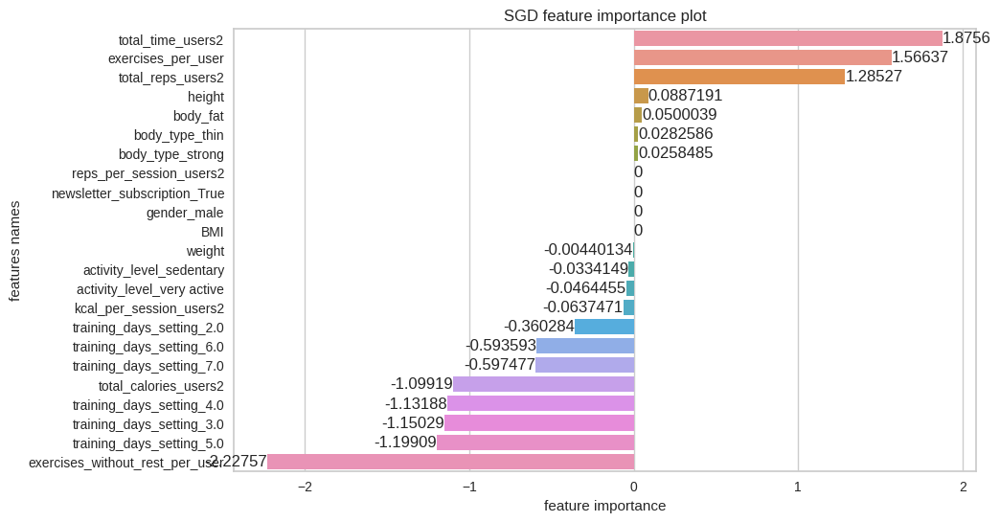

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l1', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [0.2579562420218425, -0.32208288276601027, 0.24164566339489124, 0.057852215857155505, 1.7835157812917388, 1.4865112118782897, -1.1452257009060929, 1.940000064774317, -2.6614128592861133, -0.01292831372728216, -0.04471379390904915, 0.0012499305227660772, 0.027477081850604216, 0.032267465803060155, -0.008756440579680008, -0.03573988230259049, -0.048332981779386545, -0.368651087654027, -1.1668145761904727, -1.1475792837494017, -1.2147185097045181, -0.5989312079483005, -0.601632717427074]


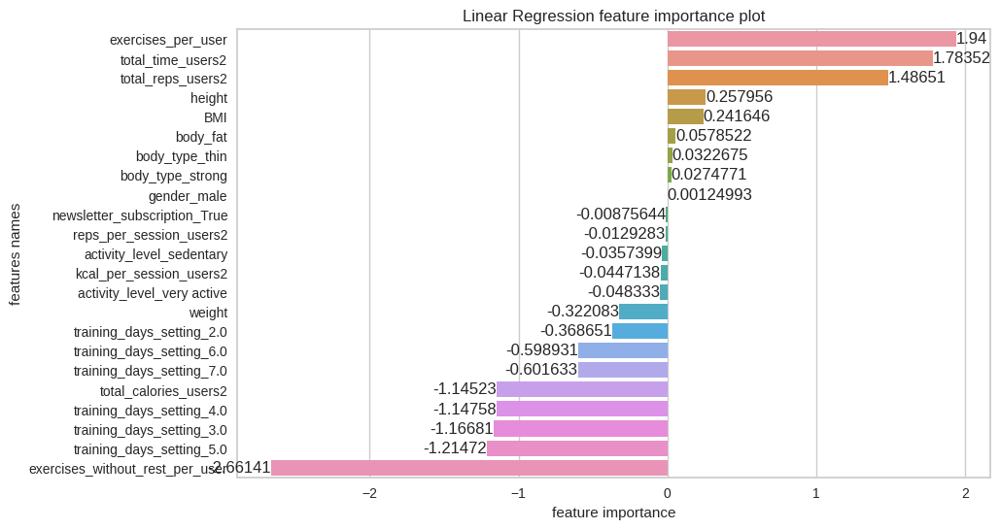

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [0.2568600429605719, -0.3196756528297653, 0.24005072023102833, 0.0577044708945525, 1.7917195837232864, 1.4769490236054494, -1.1463665185444205, 1.9109865928775864, -2.630127463252802, -0.012668090248410716, -0.045358325959311094, 0.0014439290323996828, 0.027493502862646717, 0.03224281719589181, -0.008814313299366886, -0.03572812790100355, -0.04813025089893509, -0.36863311476611305, -1.166735004354372, -1.147464946968989, -1.2144952547949721, -0.5989713071664864, -0.6016463628847896]


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.818e+03, tolerance: 8.702e-01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.674e+03, tolerance: 8.069e-01
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

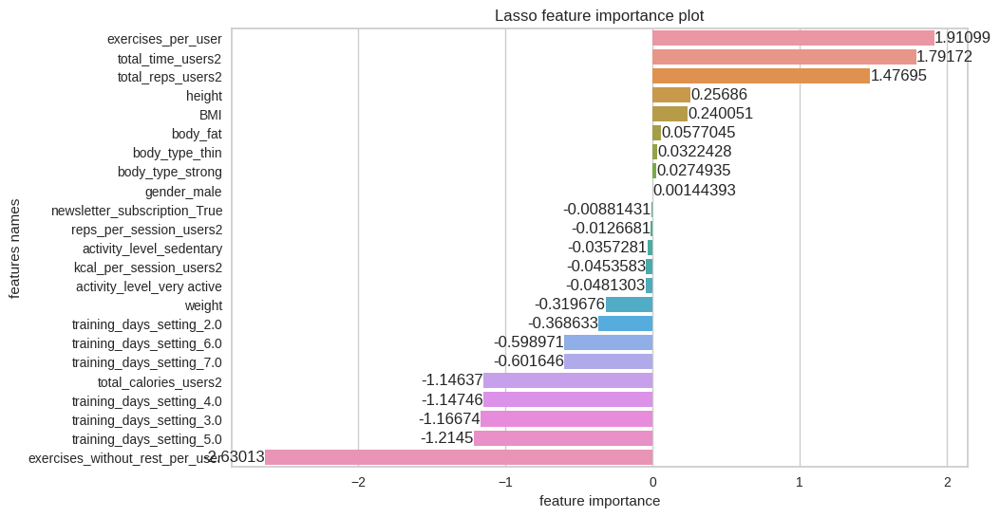

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [0.2417247030786944, -0.29299848297384773, 0.2198065304170564, 0.05638126886533429, 1.8199587372129684, 1.3716768548976799, -1.1078372706547819, 1.6220721756743408, -2.302899509557648, -0.010758673326070221, -0.05291404434687036, 0.004263887100360128, 0.027637895580928194, 0.03250020379034326, -0.009768883679691046, -0.03633734099002836, -0.04627251537810706, -0.3661317904838707, -1.1610095952793877, -1.1423647412461926, -1.2088035197169733, -0.597563749980686, -0.6006890367311843]


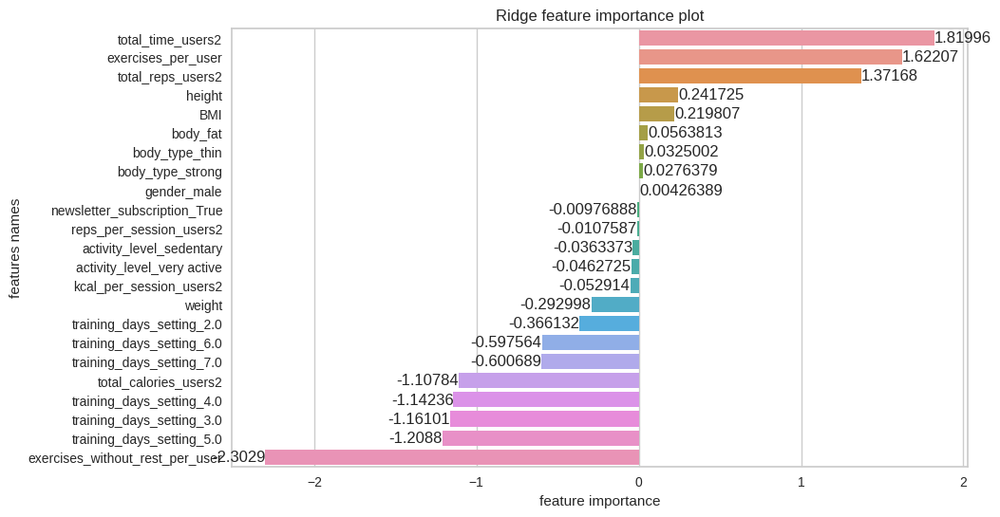

[Ridge] Best parameters are {'alpha': 0.8571485714285715, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.9790509471488766, 0.0010068379794207043, 0.0, 0.01432202319516031, 0.0, 0.0, 0.003932824899095577, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.001687366777446841, 0.0, 0.0, 0.0, 0.0]


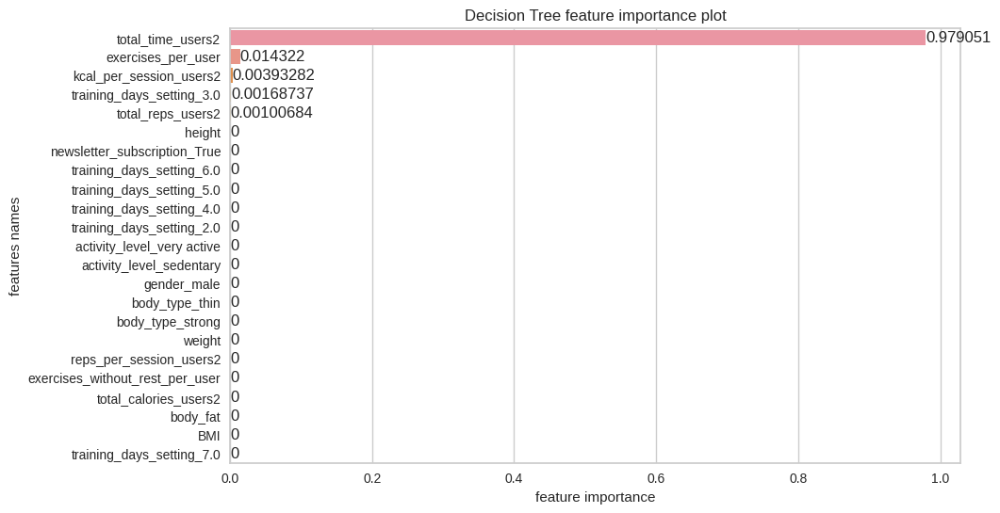

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.0034487976334470986, 0.005584791287969406, 0.013038840032171999, 0.002583453187254709, 0.2605090560770203, 0.25979012795405987, 0.1326253927483718, 0.16246606499668237, 0.09881976564940108, 0.026619363201908986, 0.02738213723765095, 0.0015824247450761694, 0.0, 0.00034574572795530433, 0.0002939698159723661, 0.002342420605917254, 0.0, 0.0, 0.0002457548703828654, 0.0007175339253583324, 0.0016043603033989355, 0.0, 0.0]


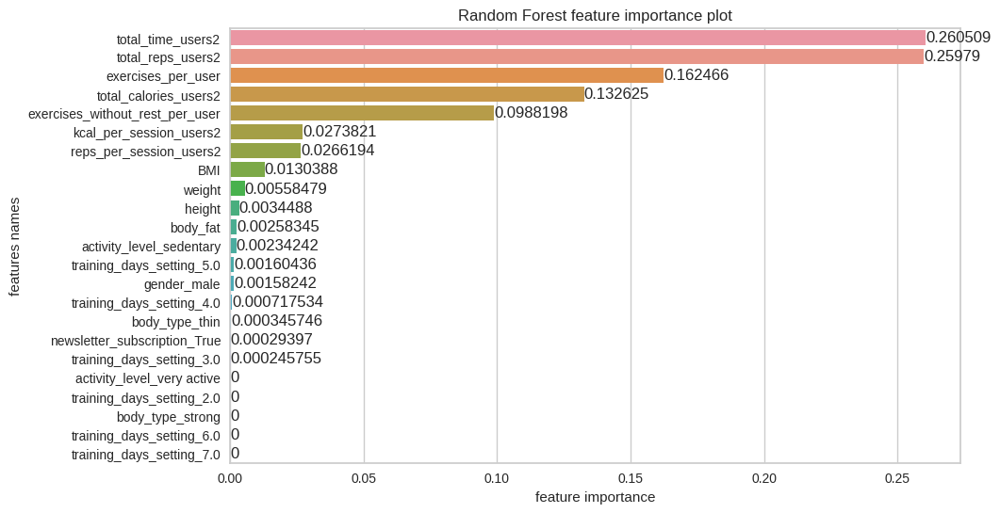

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.012654333810738438, 0.012205601228777372, 0.026644027082300452, 0.010421882731520941, 0.4959637126411504, 0.08341328542978853, 0.08048607066542561, 0.03587554958725096, 0.03237086181848618, 0.03774681064470596, 0.056934091713872356, 0.0005962035673996607, 0.0015264902492417036, 0.0005400749709661417, 0.010072848976183336, 0.0007538717204260594, 0.0025045506852586752, 0.014398594765230801, 0.019714141569724297, 0.01740666226191179, 0.03372028859309984, 0.009498958265745925, 0.004551087020794388]


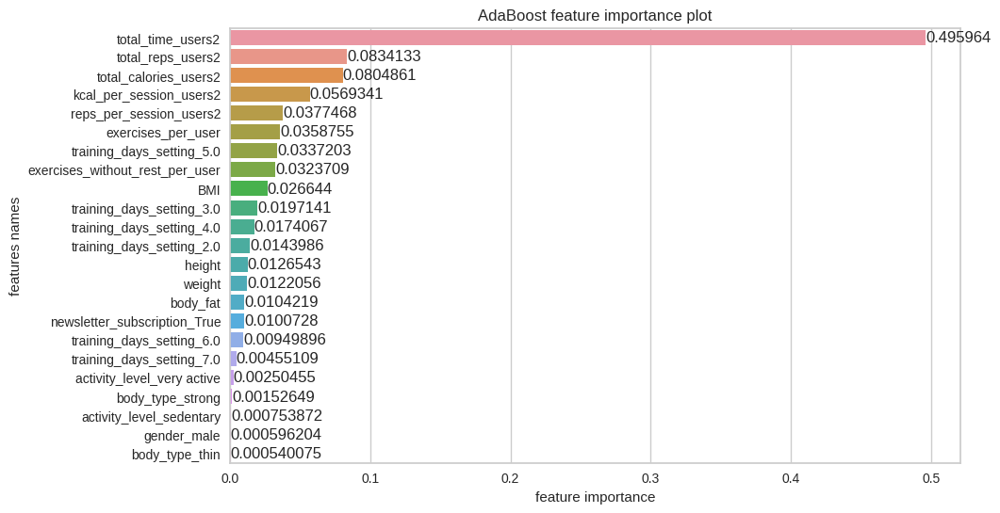

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.05, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [6.18408812780819e-05, 0.0046401444647196, 0.0010880195186904243, 0.00011306071771264613, 0.16566766975795658, 0.22464796721966557, 0.32361741833480906, 0.12192594618322758, 0.12232802832127246, 0.013868898568944363, 0.001001557017917984, 0.0001416939730197073, 0.0, 0.0, 0.0, 0.0002877064191786353, 0.0, 0.0, 0.003161630381612238, 0.007896011563375058, 0.009552406676619966, 0.0, 0.0]


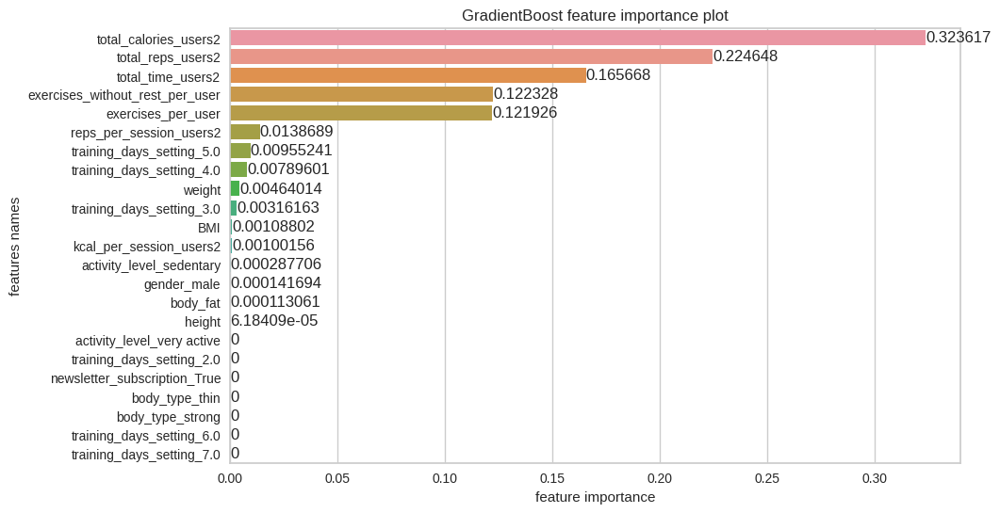

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [125]:
estimators_multiclass_ga12, X_test_ga12, y_test_ga12, X_train_ga12, y_train_ga12, X_train_inv_ga12, X_test_inv_ga12, features_ga12 = train(X_adh_12, y_adh_12, 
                                                         params, 
                                                         seed)

In [126]:
evaluation_table_ga12 = evaluate_multiclass(estimators_multiclass_ga12, X_test_ga12, y_test_ga12, 
                                            features_ga12)

In [127]:
evaluation_table_ga12

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.52,0.51,0.99,1600807559345630.75,2.67,9.36
Linear Regression,0.52,0.50,1.00,1600259963475675.25,2.68,9.42
Lasso,0.52,0.50,1.00,1600038993830795.00,2.68,9.42
Ridge,0.52,0.51,0.99,1599862938866659.00,2.67,9.39
Decision Tree,0.40,0.38,1.06,1566712070081693.75,3.34,8.56
Random Forest,0.38,0.36,1.13,1870000109640205.50,3.47,9.05
AdaBoost,0.53,0.51,0.95,1450999369406302.50,2.63,8.38
GradientBoost,0.40,0.38,1.11,1883577035861022.25,3.34,9.18


The best regression model is AdaBoost with Decision Tree with max depth equal to 5 as base estimator, learning rate equal to 0.05 and number of estimators equal to 40. The $R^2$ score is 63%, which is average, adjusted $R^2$ is 63%. MAE is 0.77, which is the lowest for all of the algorithms. MSE is 2.04 (the lowest value). Max error is not the lowest value, but it is 8.93.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

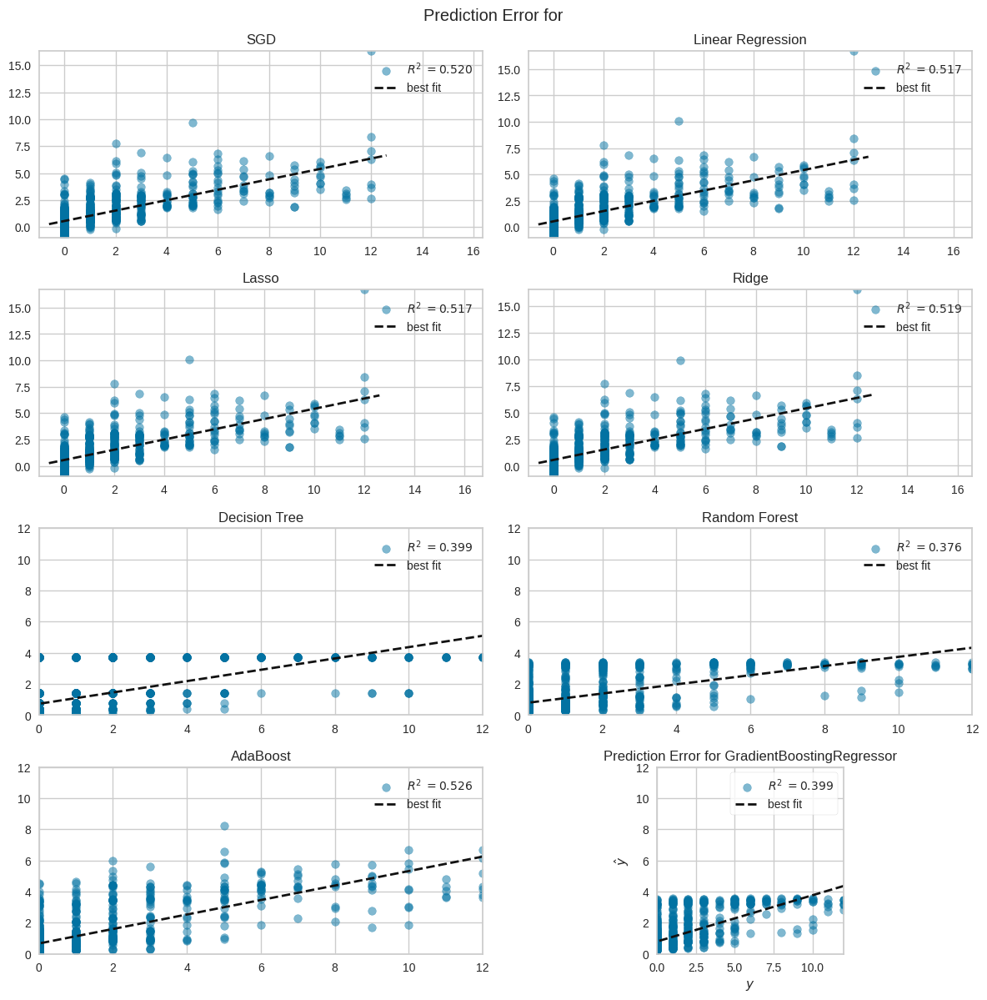

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [128]:
prediction_error_plot(estimators_multiclass_ga12, X_train_ga12, y_train_ga12, X_test_ga12, 
                      y_test_ga12, features_ga12, name = 'all')

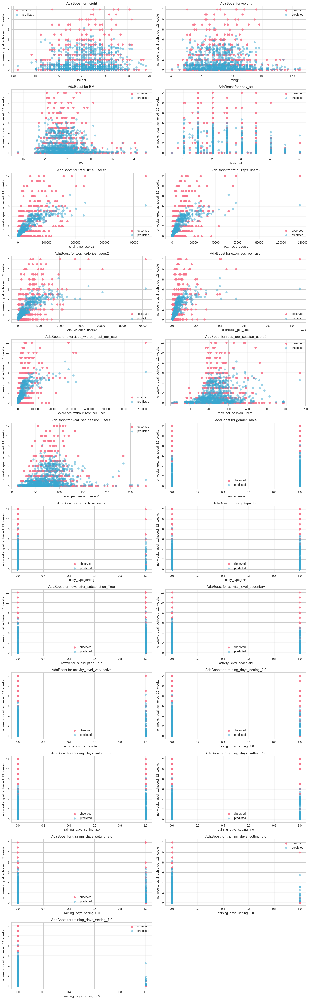

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [129]:
plots_regr(estimators_multiclass_ga12, X_adh_12, y_adh_12, X_train_ga12, y_train_ga12, 
           X_test_ga12, y_test_ga12, X_train_inv_ga12, 
           X_test_inv_ga12,
           features_ga12,
           features_selected = False,
           name = 'AdaBoost')

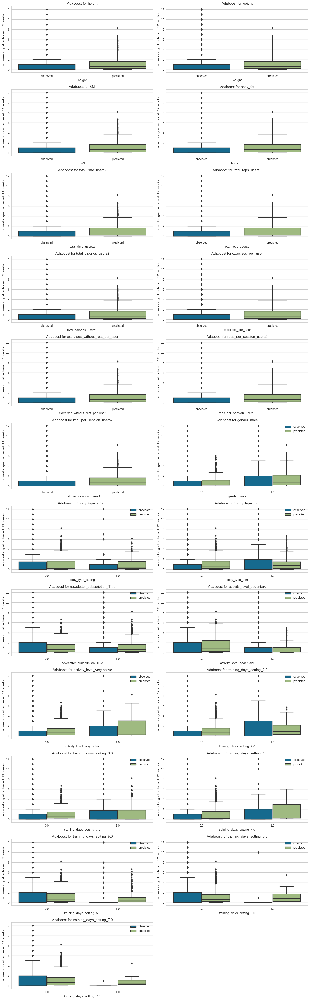

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [130]:
plots_box(estimators_multiclass_ga12, X_adh_12, y_adh_12, X_train_ga12, y_train_ga12, 
          X_test_ga12, y_test_ga12, features_ga12, X_train_inv_ga12, 
          X_test_inv_ga12, features_selected = False, name = 'AdaBoost')

### Third approach (training days goals/number of all weeks)

In this approach we take, the number of weeks when the training days goals was achieved is divided by all of the weeks when the app was active.

The adherence value will be predicted in regression.

The variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

Because 
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user 

are highly correlated, so we will use instead of them 
* reps_per_session, 
* kcal_per_session.

So we won't violate the assumption of multicollinearity.

In [135]:
# data prep

df_sess_exe_adh1 = df_session_exe_days_all_weeks.groupby(['id_users'])['training_days_goal_achieved'].agg(['sum', 'count']).reset_index()

df_sess_exe_adh1.rename(columns={'sum': 'sum_of_weeks_goal_achieved',
                                 'count': 'no_all_weeks'},
                       inplace = True)

df_sess_exe_adh1['Adh'] = df_sess_exe_adh1['sum_of_weeks_goal_achieved']/df_sess_exe_adh1['no_all_weeks']

df_sess_adh1 = df_users.merge(df_sess_exe_adh1, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_sess_adh1.drop(['id_users', 'sum_of_weeks_goal_achieved', 'no_all_weeks'], axis = 1, inplace = True)


In [63]:
# corr_heatmap_p(df_sess_adh1)

In [64]:
'''
df_sess_adh1.drop(['total_time_users2', 'total_reps_users2',
                                        'total_calories_users2', 'exercises_per_user', 
                                        'exercises_without_rest_per_user'], axis = 1, inplace = True)
'''

"\ndf_sess_adh1.drop(['total_time_users2', 'total_reps_users2',\n                                        'total_calories_users2', 'exercises_per_user', \n                                        'exercises_without_rest_per_user'], axis = 1, inplace = True)\n"

In [136]:
# deleting label from data
X_adh_cat_sec = df_sess_adh1.loc[:, df_sess_adh1.columns != 'Adh']

# variable only with label
y_adh_cat_sec = df_sess_adh1['Adh']

'''
for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat_sec[col] = LabelEncoder().fit_transform(X_adh_cat_sec[col])
'''
cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']
X_adh_cat_sec = pd.get_dummies(X_adh_cat_sec, columns = cat_cols, drop_first = True)

In [ ]:
estimators_multiclass_ta, X_test_ta, y_test_ta, X_train_ta, y_train_ta, X_train_inv_ta, X_test_inv_ta, features_ta = train(X_adh_cat_sec, y_adh_cat_sec, 
                                                         params, 
                                                         seed)

[INFO] Performing Grid-Search CV ---- SGD


In [ ]:
evaluation_table_ta = evaluate_multiclass(estimators_multiclass_ta, X_test_ta, y_test_ta, features_ta)
evaluation_table_ta

The best regression model is AdaBoost with Decision Tree with max depth equal to 5 as base estimator, learning rate equal to 0.025 and number of estimators equal to 20. The $R^2$ score is 53%, which is average, adjusted $R^2$ is 53%. MAE is 0.11, which is the lowest for all of the algorithms, and a good value. MSE is 0.03 (the lowest value). Max error is not the lowest value, but it is 0.92.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

In [ ]:
prediction_error_plot(estimators_multiclass_ta, X_train_ta, y_train_ta, X_test_ta, y_test_ta, features_ta, 
                      name = 'all')


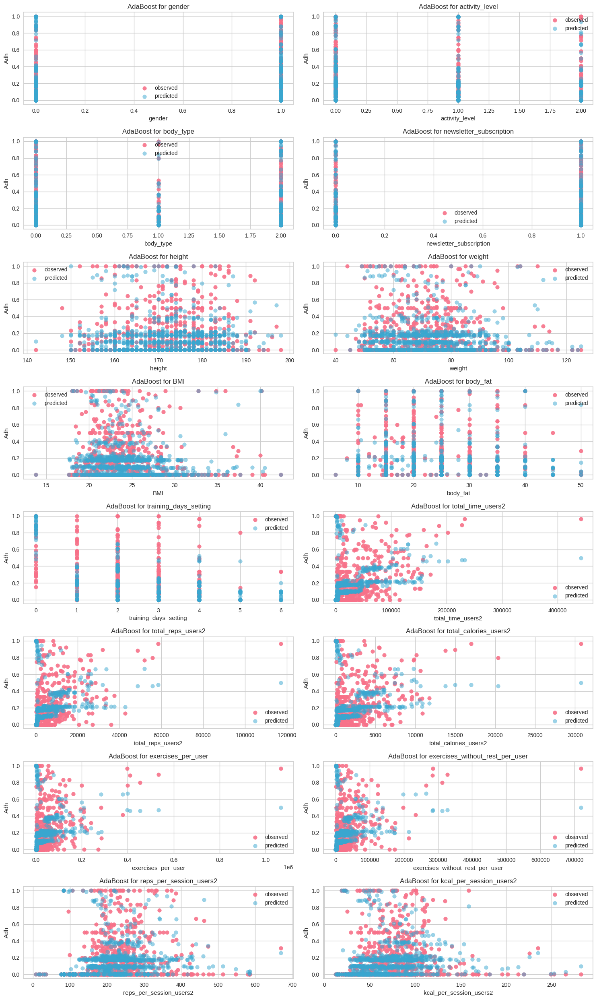

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [69]:
plots_regr(estimators_multiclass_ta, X_adh_cat_sec, y_adh_cat_sec, X_train_ta, y_train_ta, X_test_ta, 
           y_test_ta, X_train_inv_ta, X_test_inv_ta, name = 'AdaBoost')

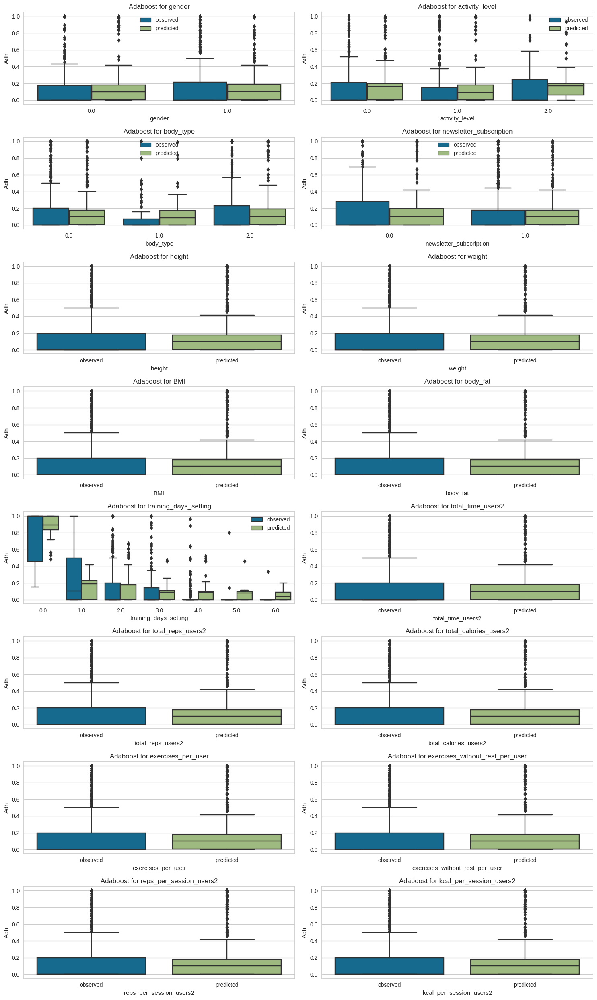

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [70]:
plots_box(estimators_multiclass_ta, X_adh_cat_sec, y_adh_cat_sec, X_train_ta, y_train_ta, X_test_ta, 
           y_test_ta, X_train_inv_ta, X_test_inv_ta, name = 'AdaBoost')

### Fourth approach (training days goal achieved / number of weeks when any training was done)

In this approach, we take into consideration sum of the weeks when the goal was achieved divided by number of weeks when the training was done.

The adherence value will be predicted in regression.

Variables taken into consideration are:
* gender,
* height,
* weight,
* BMI,
* activity level,
* body type,
* newsletter subscription,
* body fat,
* training days setting,
* total time users,
* total reps users,
* total calories users,
* exercises per user,
* exercises without rest per user.

In [131]:
# data prep

df_sess_exe_adh2 = df_session_exe_days_setting.groupby(['id_users'])['training_days_goal_achieved'].agg(['sum', 'count']).reset_index()

df_sess_exe_adh2.rename(columns={'sum': 'sum_of_weeks_goal_achieved',
                                 'count': 'no_all_weeks'},
                       inplace = True)

df_sess_exe_adh2['Adh'] = df_sess_exe_adh2['sum_of_weeks_goal_achieved']/df_sess_exe_adh2['no_all_weeks']

df_sess_adh2 = df_users.merge(df_sess_exe_adh2, how = 'left', left_on = 'id_users', right_on = 'id_users')

df_sess_adh2.drop(['id_users', 'sum_of_weeks_goal_achieved', 'no_all_weeks'], axis = 1, inplace = True)


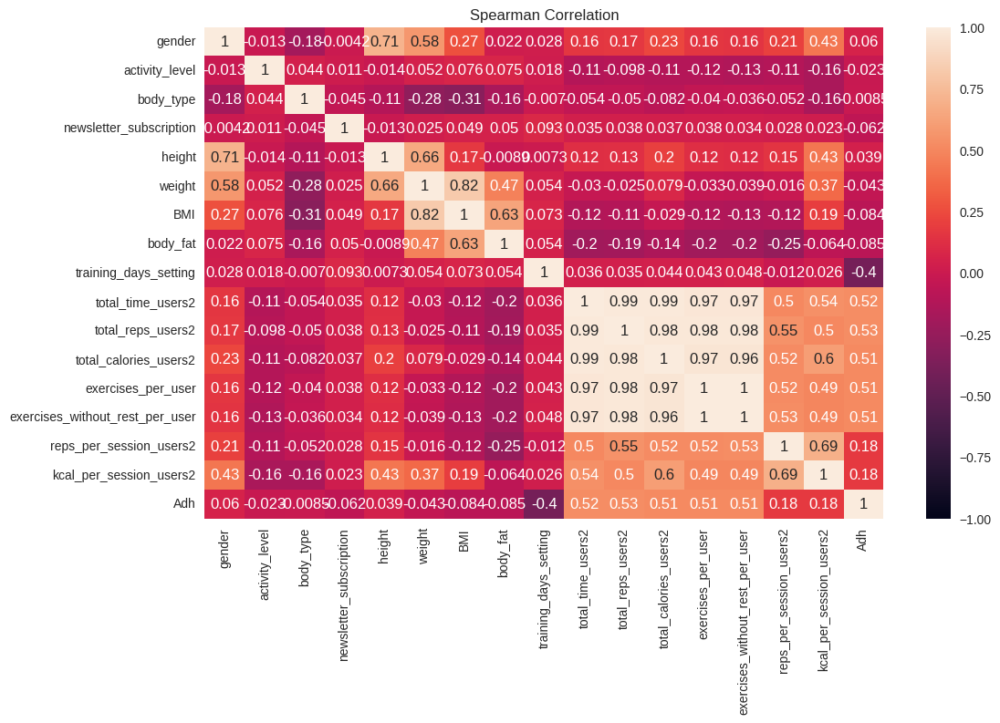

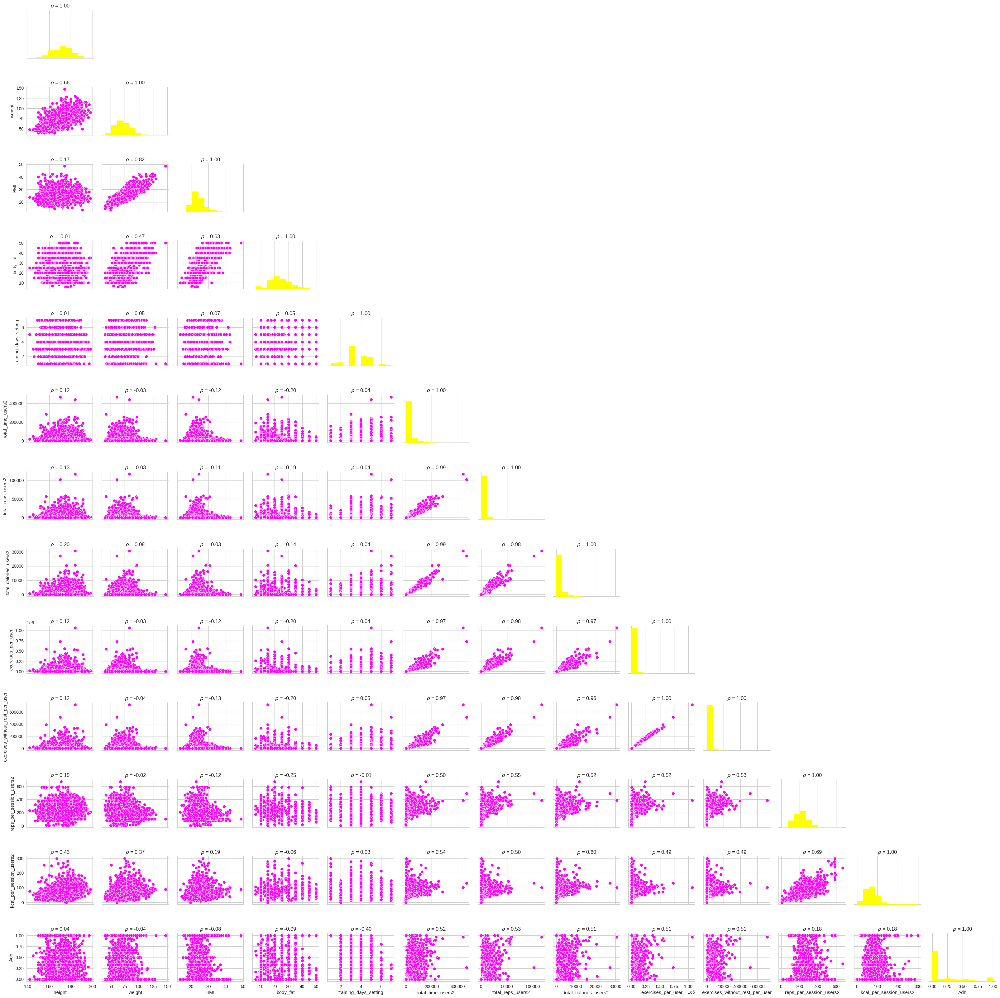

,gender,activity_level,body_type,newsletter_subscription,height,weight,BMI,body_fat,training_days_setting,total_time_users2,total_reps_users2,total_calories_users2,exercises_per_user,exercises_without_rest_per_user,reps_per_session_users2,kcal_per_session_users2,Adh
gender,1.00,-0.01,-0.18***,-0.00,0.71***,0.58***,0.27***,0.02,0.03,0.16***,0.17***,0.23***,0.16***,0.16***,0.21***,0.43***,0.06***
activity_level,-0.01,1.00,0.04*,0.01,-0.01,0.05**,0.08***,0.07***,0.02,-0.11***,-0.1***,-0.11***,-0.12***,-0.13***,-0.11***,-0.16***,-0.02
body_type,-0.18***,0.04*,1.00,-0.05*,-0.11***,-0.28***,-0.31***,-0.16***,-0.01,-0.05**,-0.05**,-0.08***,-0.04*,-0.04*,-0.05**,-0.16***,-0.01
newsletter_subscription,-0.00,0.01,-0.05*,1.00,-0.01,0.03,0.05**,0.05**,0.09***,0.03,0.04*,0.04*,0.04*,0.03,0.03,0.02,-0.06***
height,0.71***,-0.01,-0.11***,-0.01,1.00,0.66***,0.17***,-0.01,0.01,0.12***,0.13***,0.2***,0.12***,0.12***,0.15***,0.43***,0.04*
weight,0.58***,0.05**,-0.28***,0.03,0.66***,1.00,0.82***,0.47***,0.05**,-0.03,-0.03,0.08***,-0.03,-0.04*,-0.02,0.37***,-0.04*
BMI,0.27***,0.08***,-0.31***,0.05**,0.17***,0.82***,1.00,0.63***,0.07***,-0.12***,-0.11***,-0.03,-0.12***,-0.13***,-0.12***,0.19***,-0.08***
body_fat,0.02,0.07***,-0.16***,0.05**,-0.01,0.47***,0.63***,1.00,0.05**,-0.2***,-0.19***,-0.14***,-0.2***,-0.2***,-0.25***,-0.06***,-0.09***
training_days_setting,0.03,0.02,-0.01,0.09***,0.01,0.05**,0.07***,0.05**,1.00,0.04*,0.04,0.04*,0.04*,0.05**,-0.01,0.03,-0.4***
total_time_users2,0.16***,-0.11***,-0.05**,0.03,0.12***,-0.03,-0.12***,-0.2***,0.04*,1.00,0.99***,0.99***,0.97***,0.97***,0.5***,0.54***,0.52***


In [72]:
corr_heatmap_p(df_sess_adh2)

In [132]:
# deleting label from data
X_adh_cat_six = df_sess_adh2.loc[:, df_sess_adh2.columns != 'Adh']

# variable only with label
y_adh_cat_six = df_sess_adh2['Adh']

'''
for col in ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']:
    X_adh_cat_six[col] = LabelEncoder().fit_transform(X_adh_cat_six[col])
'''

cat_cols = ['gender', 'body_type', 'newsletter_subscription', 'activity_level', 'training_days_setting']
X_adh_cat_six = pd.get_dummies(X_adh_cat_six, columns = cat_cols, drop_first = True)

[INFO] Performing Grid-Search CV ---- SGD
[SGD] Features importances: [-0.0006994021477222846, 0.004647952718120021, -0.009511785781246373, 0.010705097680461113, 0.17195735131467754, 0.06374353259079221, -0.07610946580986208, 0.11218780403199026, -0.17382563467766188, 0.016511587588849765, -0.011069028443494135, 0.006189012313493366, 2.9164096350064433e-05, -0.0036335311452494632, 0.004429435831789384, 0.004889191837890725, 0.004834707602994727, -0.17591815263801666, -0.4177500357629146, -0.3736433878981617, -0.36727807896029224, -0.17623990279093255, -0.17134750504191346]


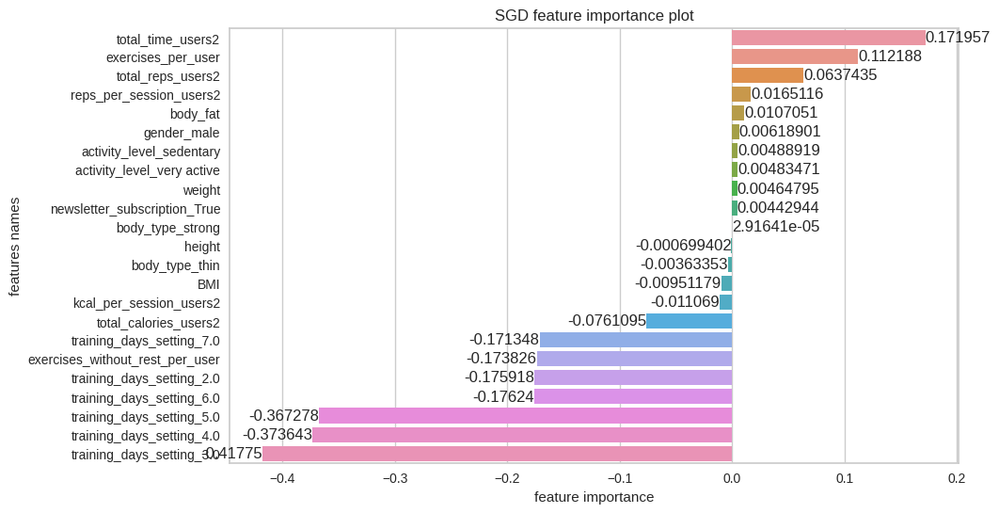

[SGD] Best parameters are {'alpha': 0.001, 'eta0': 0.025075, 'learning_rate': 'adaptive', 'max_iter': 1000000, 'penalty': 'l2', 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Linear Regression
[Linear Regression] Features importances: [-0.006102164189144429, 0.015479855413424034, -0.01775637696717981, 0.010649721828054475, 0.16637238753774625, 0.08923741357717621, -0.08693518811027863, 0.1737206129601104, -0.24420425549798092, 0.015952317451910187, -0.009468161219988233, 0.005444014645434319, 0.00011566753763654175, -0.003676594376469998, 0.0049556777531504885, 0.004650643385450736, 0.003910267862272259, -0.1784902345578385, -0.4224349846065568, -0.3774245730461589, -0.3716540870543245, -0.1779297680006286, -0.17248837867736802]


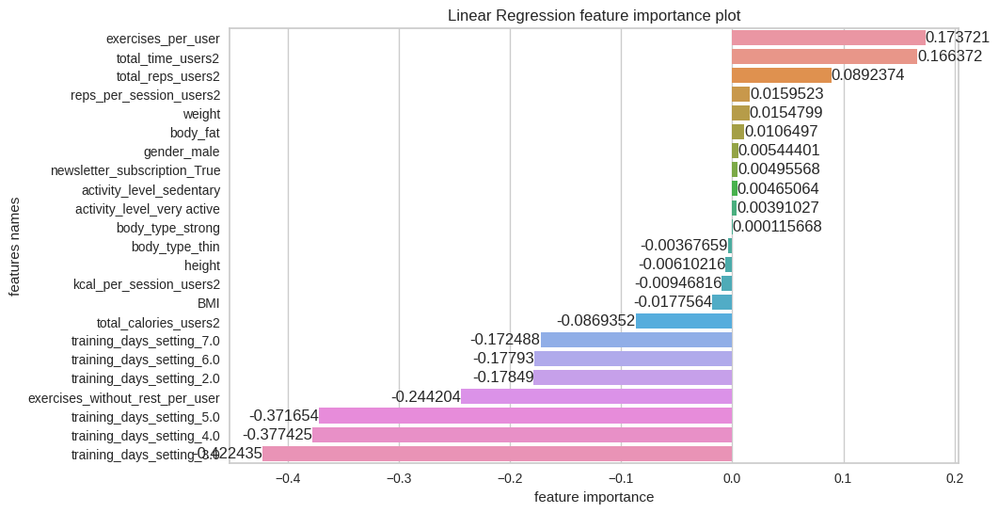

[Linear Regression] Best parameters are {'copy_X': True, 'fit_intercept': True}
[INFO] Performing Grid-Search CV ---- Lasso
[Lasso] Features importances: [-0.004131455289112286, 0.011898408390753455, -0.014922317465272074, 0.010624467977891926, 0.1673621667848994, 0.08707241243701196, -0.0864958312937606, 0.1674109131135018, -0.23718683063183305, 0.015939765294001366, -0.009568149717048764, 0.005444336497813005, 0.00012562015422575994, -0.003662095662004776, 0.004924197587039341, 0.004621131234570033, 0.003931906284206473, -0.17841253190782014, -0.4222819149201367, -0.3772961405043343, -0.37150636561461214, -0.17788415117407858, -0.17244366666181796]


/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.316e+00, tolerance: 1.687e-02
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.740e+00, tolerance: 1.643e-02
  model = cd_fast.enet_coordinate_descent(
/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale 

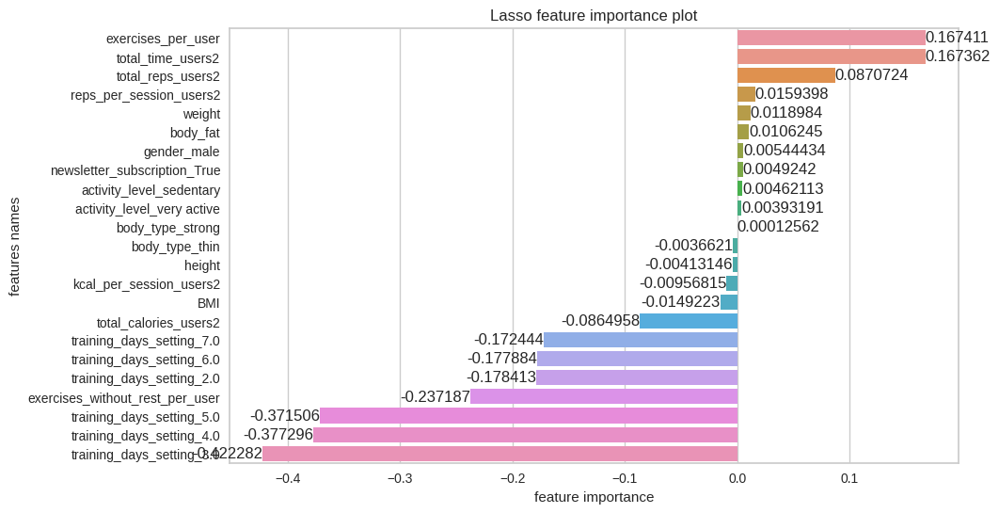

[Lasso] Best parameters are {'alpha': 1e-05, 'copy_X': True, 'fit_intercept': True, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Ridge
[Ridge] Features importances: [-0.004945314021324886, 0.013204465949373754, -0.015929535328782697, 0.010536757578248734, 0.16921168063405123, 0.07976205524842656, -0.08390632254618019, 0.14573635651016348, -0.21271090033814224, 0.01600943006619557, -0.010003884307297092, 0.005655710476630936, 0.00013346834335386412, -0.003651021541444917, 0.00474997648954677, 0.004617940344969673, 0.004076532826535142, -0.17747565326222914, -0.42043734409228245, -0.3757087738873738, -0.36993772580126166, -0.17725795823694165, -0.171874609660885]


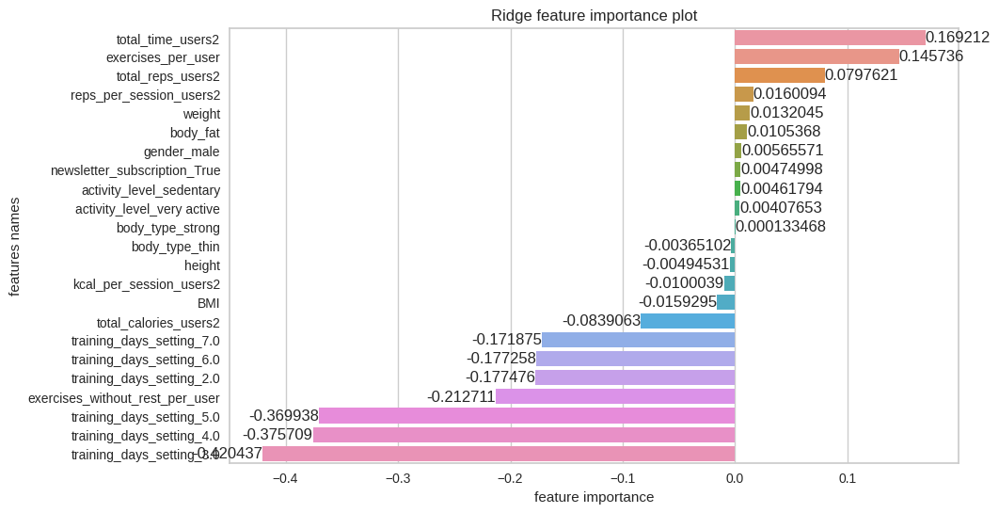

[Ridge] Best parameters are {'alpha': 0.8571485714285715, 'copy_X': True, 'fit_intercept': True, 'random_state': 42, 'solver': 'auto'}
[INFO] Performing Grid-Search CV ---- Decision Tree
[Decision Tree] Features importances: [0.0, 0.0, 0.0, 0.0, 0.20743254851177184, 0.0, 0.0, 0.61887087500401, 0.0, 0.03811940523150075, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.13557717125271743, 0.0, 0.0, 0.0, 0.0]


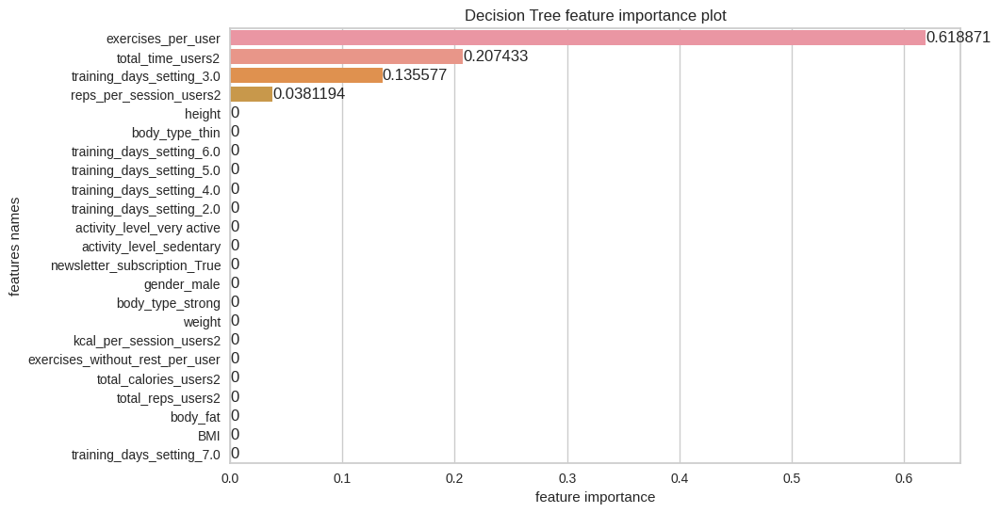

[Decision Tree] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'min_samples_leaf': 0.1, 'min_samples_split': 0.33999999999999997, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- Random Forest
[Random Forest] Features importances: [0.004730011522638529, 0.010059373902189278, 0.012270425162411313, 0.0038366754038368974, 0.18635940927316239, 0.23026548662904625, 0.1157437741985186, 0.10508843566670474, 0.16554010410195374, 0.04294397450676039, 0.024052392059820318, 0.0010891429634009504, 0.0, 1.617483081184618e-05, 0.019633551801279747, 0.0024950747827913295, 0.0, 0.0, 0.015030727182671113, 0.029469544817950426, 0.03137572119405214, 0.0, 0.0]


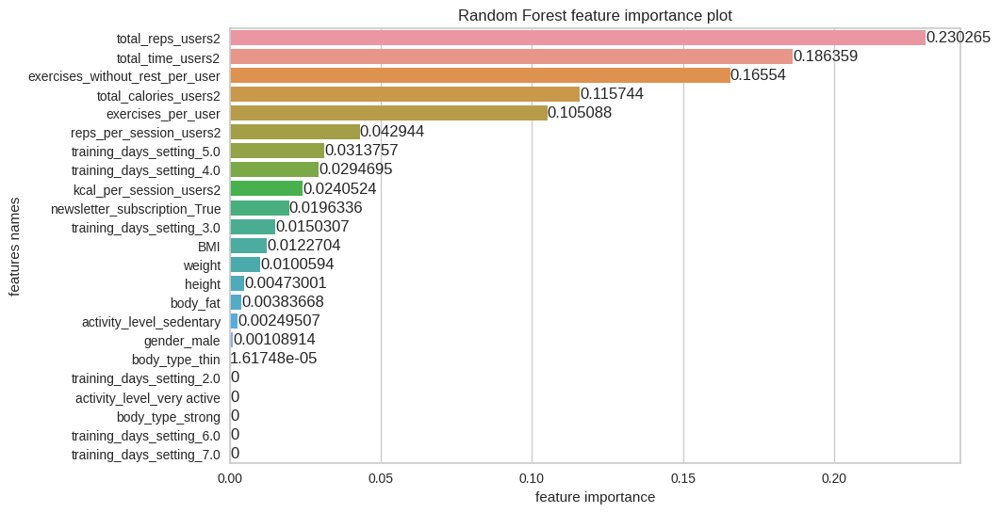

[Random Forest] Best parameters are {'criterion': 'friedman_mse', 'max_depth': 6, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- AdaBoost
[AdaBoost] Features importances: [0.013418627057603336, 0.0088679648856976, 0.009373830473975702, 0.004455358828361717, 0.08177299023609633, 0.09467671199968719, 0.029336331520224863, 0.030556153290459135, 0.025101226014727255, 0.013251939675251498, 0.014035736635307482, 8.482805548705616e-05, 0.00033148866404752054, 0.00024853380653137413, 0.0007604153699532706, 0.0014985870218486973, 0.002040153630549849, 0.07771109862080251, 0.1536260075301238, 0.12706362296454946, 0.15085013368772482, 0.08744097289497922, 0.07349728713601032]


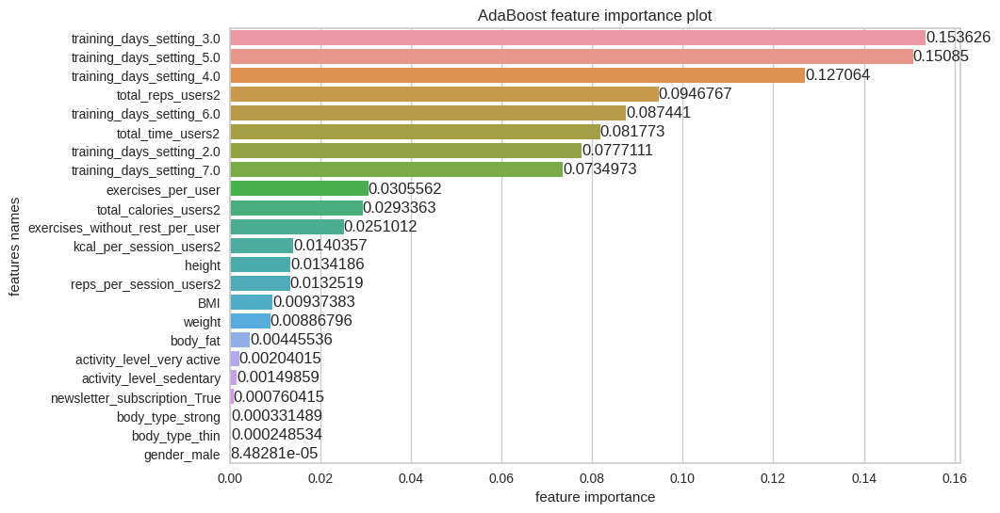

[AdaBoost] Best parameters are {'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 0.075, 'n_estimators': 80, 'random_state': 42}
[INFO] Performing Grid-Search CV ---- GradientBoost
[GradientBoost] Features importances: [0.009708095420184953, 0.015285252319785444, 0.008356358034196152, 8.158131954596772e-05, 0.11733574742207743, 0.02107198842749513, 0.09651374079057336, 0.0853101205085859, 0.2520141180630409, 0.026724898793847807, 0.009877019771478743, 0.002224083519680732, 0.0, 0.0, 0.015106067447379409, 0.0, 0.0, 0.0, 0.09953506229975517, 0.10781696062429903, 0.13303890523807388, 0.0, 0.0]


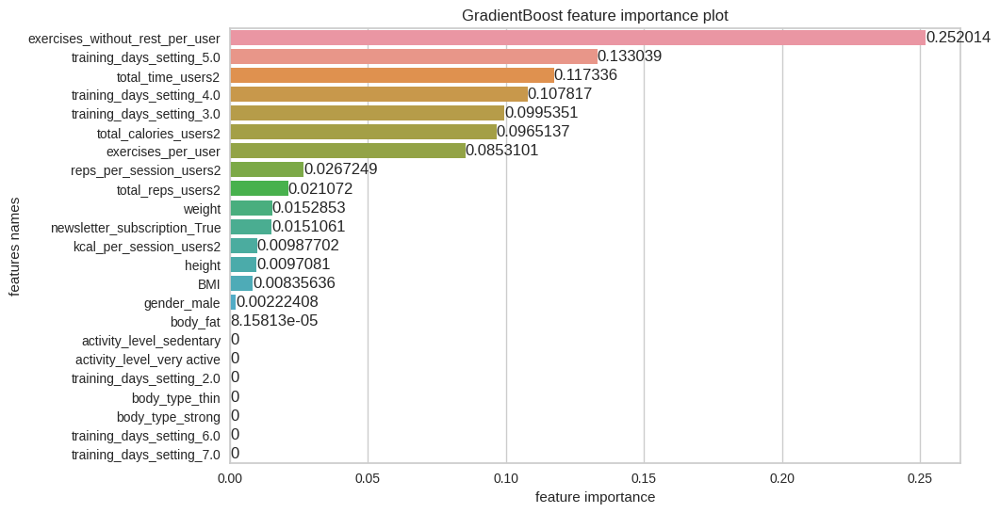

[GradientBoost] Best parameters are {'criterion': 'friedman_mse', 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 5, 'max_features': 'log2', 'min_samples_leaf': 0.1, 'min_samples_split': 0.1, 'n_estimators': 15, 'random_state': 42, 'subsample': 0.85}


In [133]:
estimators_multiclass_tw, X_test_tw, y_test_tw, X_train_tw, y_train_tw, X_train_inv_tw, X_test_inv_tw, features_tw = train(X_adh_cat_six, y_adh_cat_six, 
                                                         params, 
                                                         seed)

In [134]:
evaluation_table_tw = evaluate_multiclass(estimators_multiclass_tw, X_test_tw, y_test_tw, features_tw)
evaluation_table_tw

,R2 score,Adjusted R2 score,Mean Absolute Error,Mean Absolute Percentage Error,Mean Squared Error,Max Error
SGD,0.61,0.60,0.13,254319414789739.09,0.04,0.92
Linear Regression,0.61,0.60,0.13,252294413702140.50,0.04,0.92
Lasso,0.61,0.60,0.13,252317834907299.75,0.04,0.92
Ridge,0.61,0.60,0.13,252995899128411.19,0.04,0.92
Decision Tree,0.15,0.13,0.20,406227173496615.19,0.08,0.97
Random Forest,0.14,0.12,0.21,424141841889878.44,0.08,0.90
AdaBoost,0.45,0.44,0.16,331346685797681.75,0.05,0.85
GradientBoost,0.19,0.17,0.21,416274948607241.81,0.07,0.87


The best regression model is AdaBoost with Decision Tree with max depth equal to 5 as base estimator, learning rate equal to 0.025 and number of estimators equal to 20. The $R^2$ score is 65%, which is average, adjusted $R^2$ is also 65%. MAE is 0.11, which is the lowest for all of the algorithms, and a good value. MSE is 0.03 (the lowest value). Max error is not the lowest value, but it is 0.88.

Below there is a plots of prediction error for every method and scatter plots of total sessions observed and predicted value of total sessions for every variable.

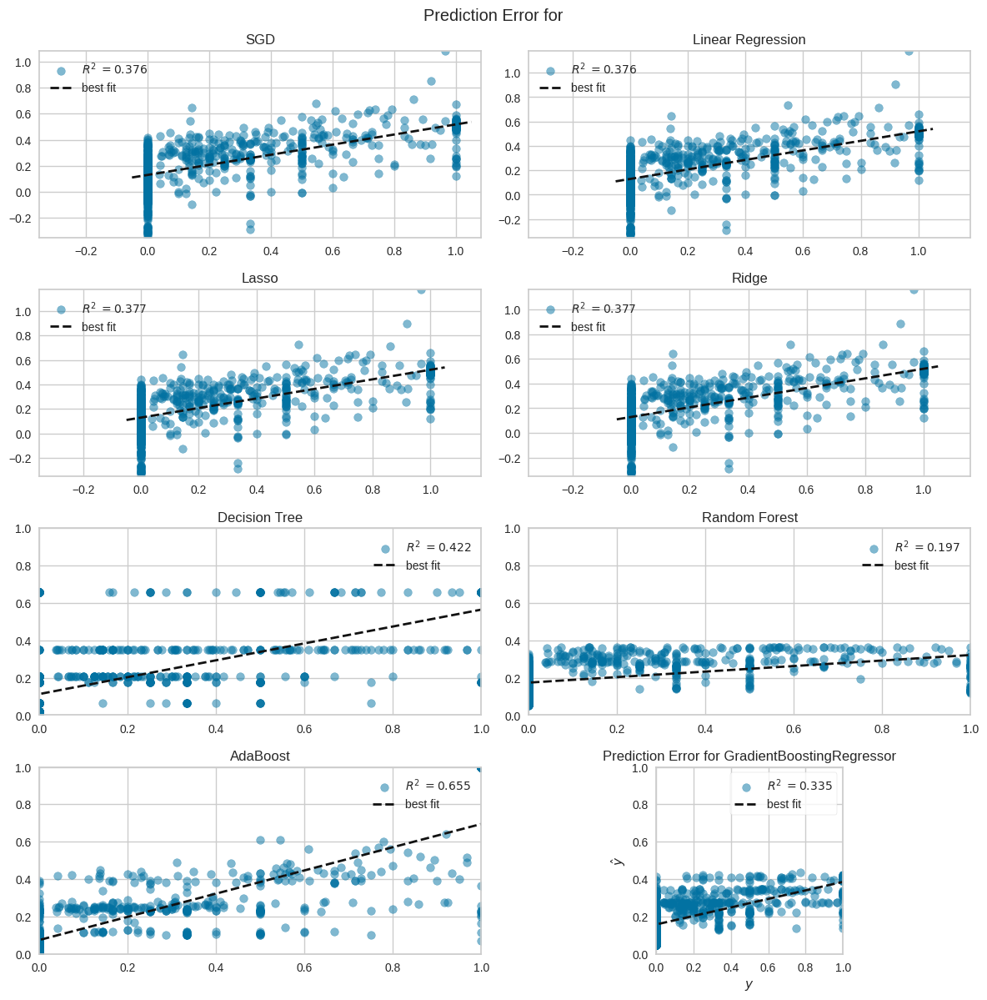

<AxesSubplot: title={'center': 'Prediction Error for GradientBoostingRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [76]:
prediction_error_plot(estimators_multiclass_tw, X_train_tw, y_train_tw, X_test_tw, y_test_tw, name = 'all')


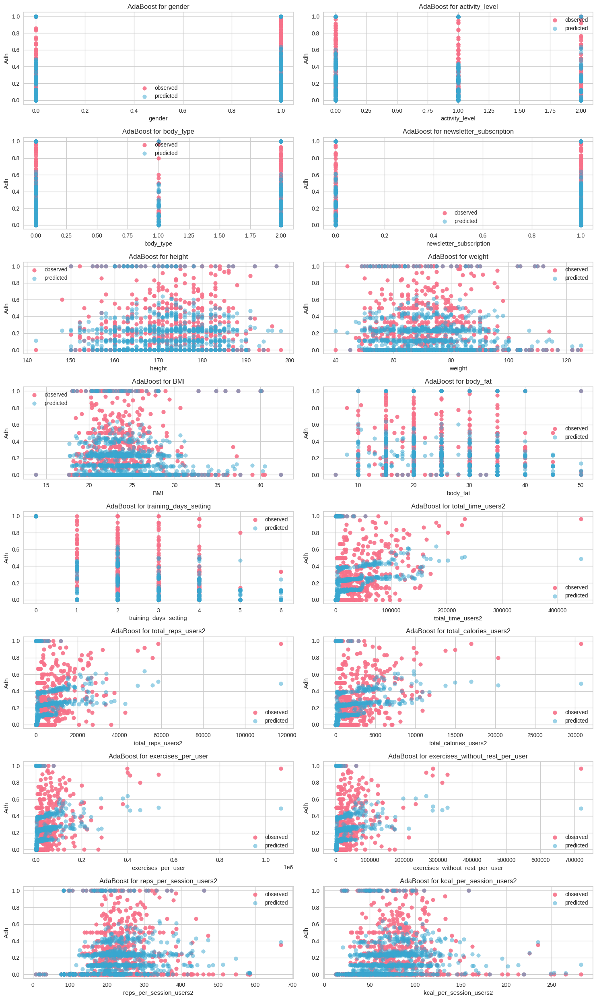

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [77]:
plots_regr(estimators_multiclass_tw, X_adh_cat_six, y_adh_cat_six, X_train_tw, y_train_tw, X_test_tw, 
           y_test_tw, X_train_inv_tw, X_test_inv_tw, name = 'AdaBoost')

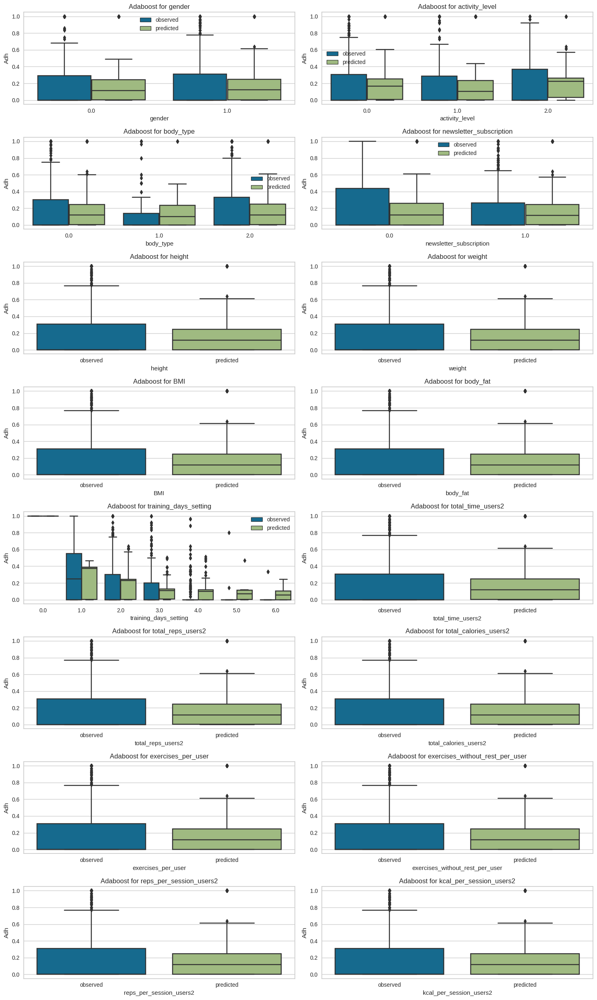

<module 'matplotlib.pyplot' from '/home/evida-monika/anaconda3/envs/mhunters/lib/python3.10/site-packages/matplotlib/pyplot.py'>

In [78]:
plots_box(estimators_multiclass_tw, X_adh_cat_six, y_adh_cat_six, X_train_tw, y_train_tw, X_test_tw, 
           y_test_tw, X_train_inv_tw, X_test_inv_tw, name = 'AdaBoost')